Saved regional average plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\model_metric_plots\average_R2_AP.png


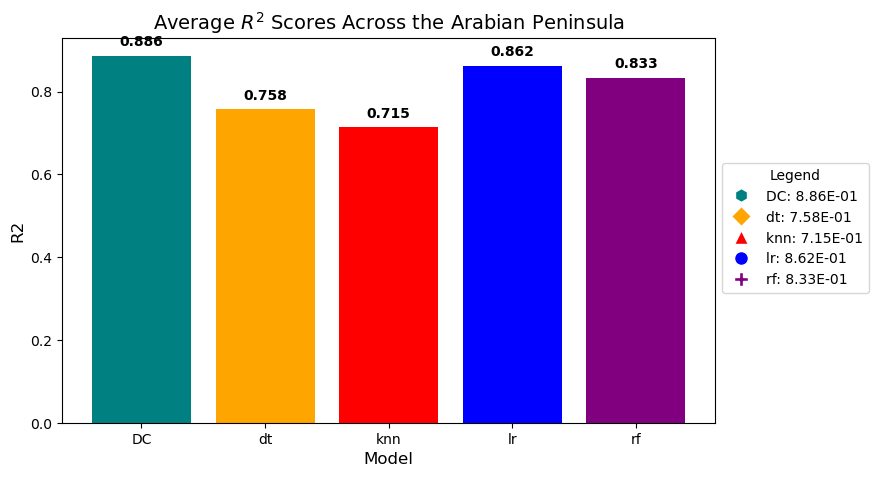

Saved regional average plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\model_metric_plots\average_MSE_AP.png


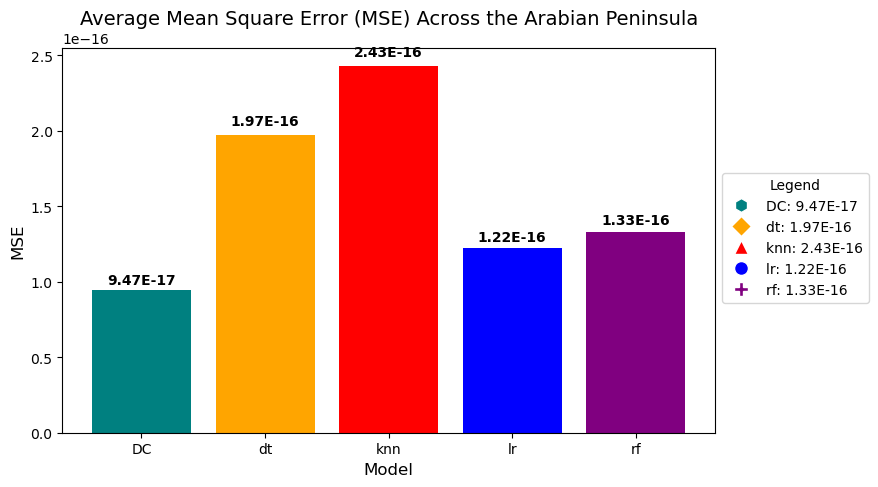

Saved regional average plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\model_metric_plots\average_MAE_AP.png


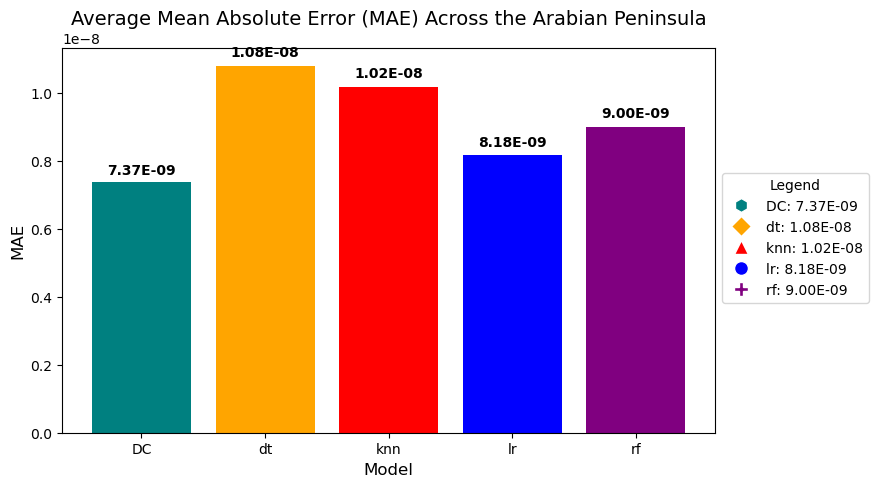

Saved regional average plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\model_metric_plots\average_Weight_AP.png


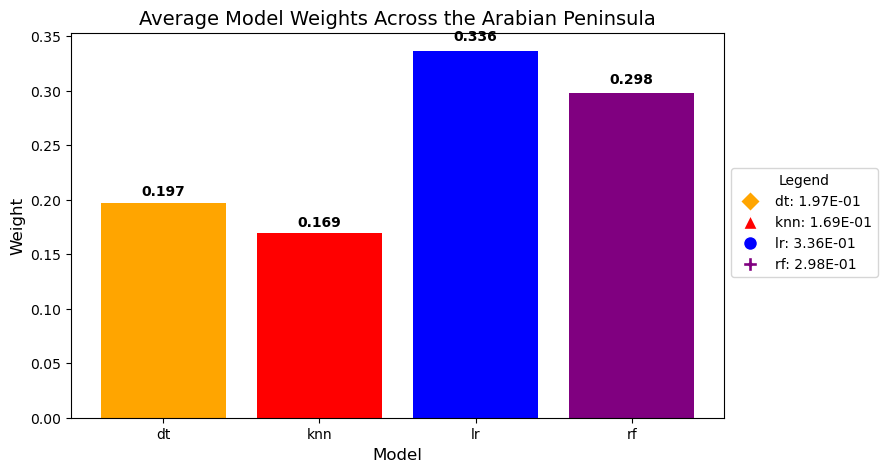

In [3]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\sfc_model_metrics_1980_2022_v0060.csv"
data = pd.read_csv(file_path)

# Rename ensemble model to 'DustCast' (DC)
data['Model'] = data['Model'].replace({'ensemble': 'DC'})

# Define color and marker scheme
model_styles = {
    'DC': ('teal', 'h'),  # DustCast
    'lr': ('blue', 'o'),  # Linear Regression
    #'svr': ('green', 's'),  # Support Vector Regression
    'knn': ('red', '^'),  # K-Nearest Neighbors
    'dt': ('orange', 'D'),  # Decision Tree
    'rf': ('purple', 'P')  # Random Forest
}

# Metrics to plot
metrics = ['Weight', 'R2', 'MSE', 'MAE']
titles = {
    'Weight': "Model Weights",
    'R2': "$R^2$ Scores",
    'MSE': "Mean Square Error (MSE)",
    'MAE': "Mean Absolute Error (MAE)"
}

# Define output directory for plots
output_dir = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\model_metric_plots"
os.makedirs(output_dir, exist_ok=True)  # Ensure directory exists

def add_value_labels(ax, bars, is_sci_notation=False):
    """Adds value labels on top of each bar."""
    for bar in bars:
        height = bar.get_height()
        if is_sci_notation:
            label = f"{height:.2E}"  # Scientific notation
        else:
            label = f"{height:.3f}"
        ax.text(bar.get_x() + bar.get_width() / 2, height * 1.02, label,
                ha='center', va='bottom', fontsize=10, fontweight='bold')

# **Compute and plot the average MSE, MAE, and R² across all countries**
for metric in ['R2', 'MSE', 'MAE', 'Weight']:
    average_metrics = data.groupby('Model')[metric].mean().reset_index()
    
    # Exclude DC when plotting "Weight"
    if metric == "Weight":
        average_metrics = average_metrics[average_metrics['Model'] != 'DC']

    # Create a new figure for the regional average with space for the right legend
    fig, ax = plt.subplots(figsize=(9, 5))  # Adjusted width
    colors = [model_styles.get(model, ('gray', 'o'))[0] for model in average_metrics['Model']]
    
    bars = ax.bar(average_metrics['Model'], average_metrics[metric], color=colors)
    ax.set_title(f"Average {titles[metric]} Across the Arabian Peninsula", fontsize=14)
    ax.set_xlabel("Model", fontsize=12)
    ax.set_ylabel(metric, fontsize=12)

    # Apply scientific notation to y-axis for small values
    if metric in ['MSE', 'MAE']:
        ax.ticklabel_format(style='sci', axis='y', scilimits=(0, 0))
        add_value_labels(ax, bars, is_sci_notation=True)
    else:
        add_value_labels(ax, bars, is_sci_notation=False)

    # **Separate Legends: Model Colors (inside) and Metric Values (just outside the plot)**
    filtered_models = average_metrics['Model'].unique()

    # Legend 1: Model Colors (inside graph, upper right)
    handles_colors = [plt.Line2D([0], [0], marker=model_styles[m][1], color='w', 
                                 markerfacecolor=model_styles[m][0], markersize=10) 
                      for m in filtered_models if m in model_styles]

    # Legend 2: Metric Values (right next to the graph)
    labels_values = [f"{m}: {average_metrics[average_metrics['Model'] == m][metric].values[0]:.2E}"
                     for m in filtered_models if m in model_styles]
    
    fig.subplots_adjust(right=0.85)  # Fine-tuned spacing for the second legend
    legend2 = plt.figlegend(handles_colors, labels_values, loc='center left', title="Legend", bbox_to_anchor=(0.85, 0.5))

    # Save the figure
    save_path = os.path.join(output_dir, f"average_{metric}_AP.png")
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    print(f"Saved regional average plot: {save_path}")

    # Show the plot
    plt.show()


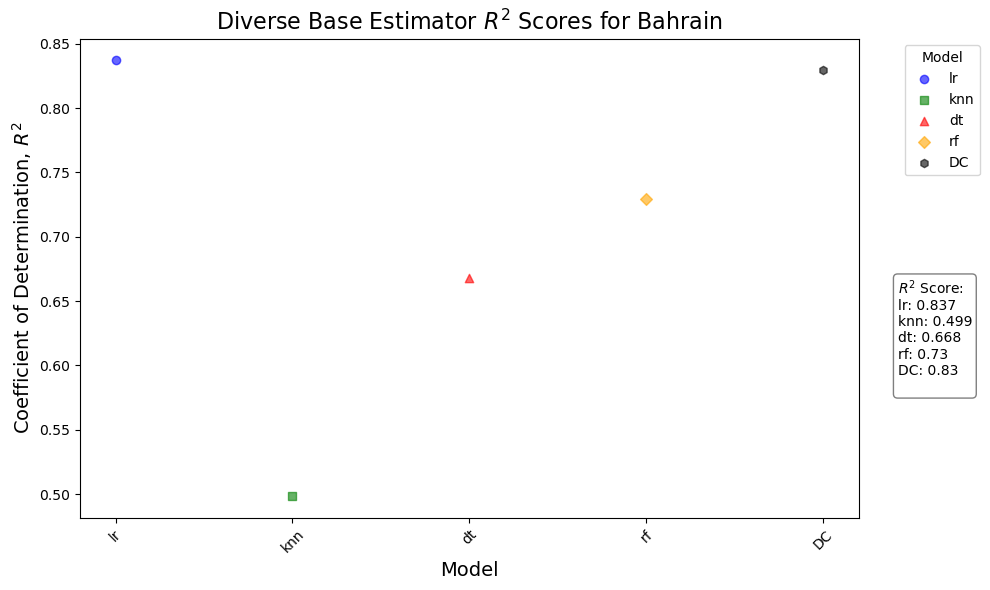

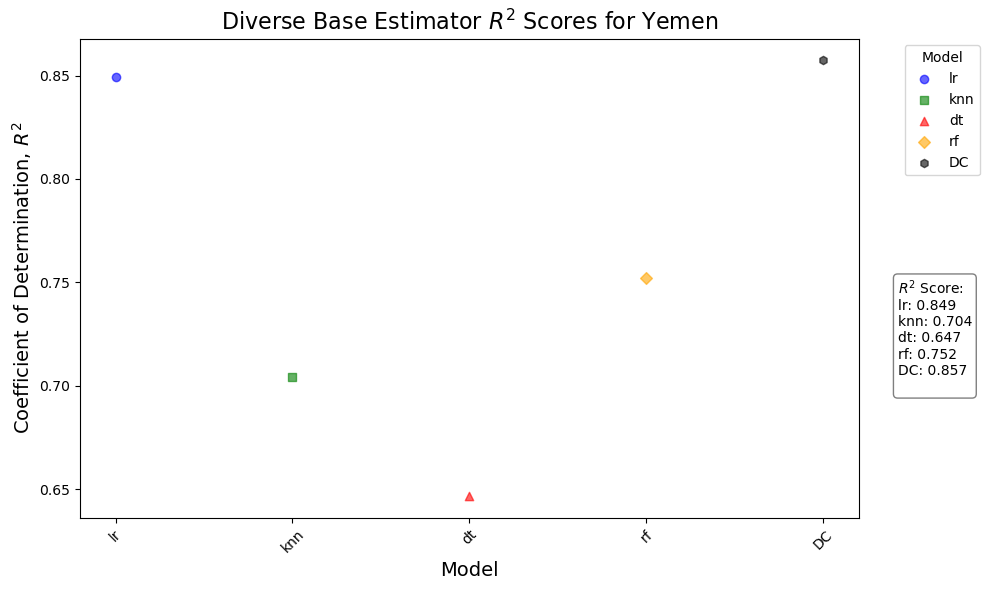

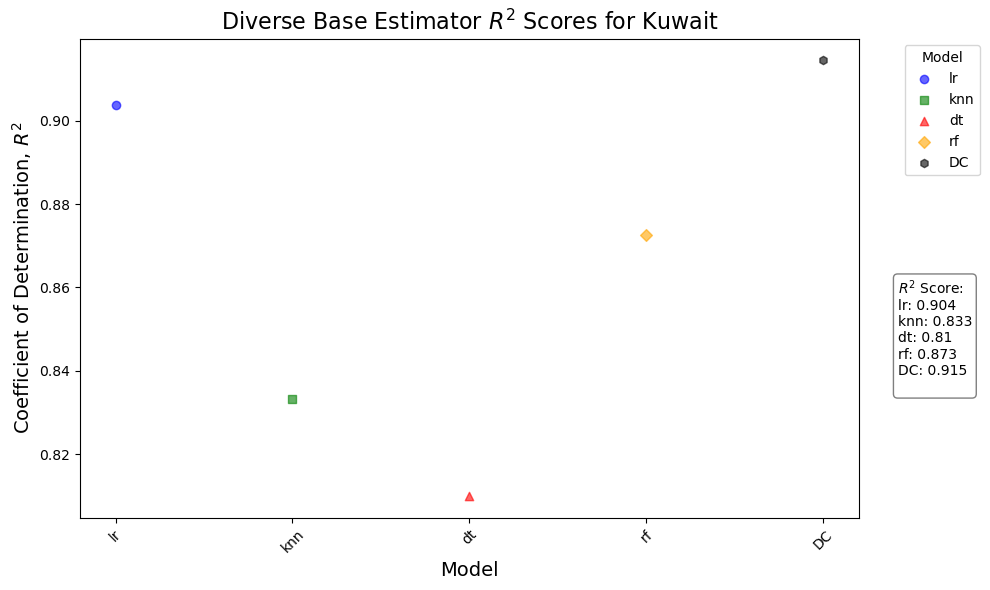

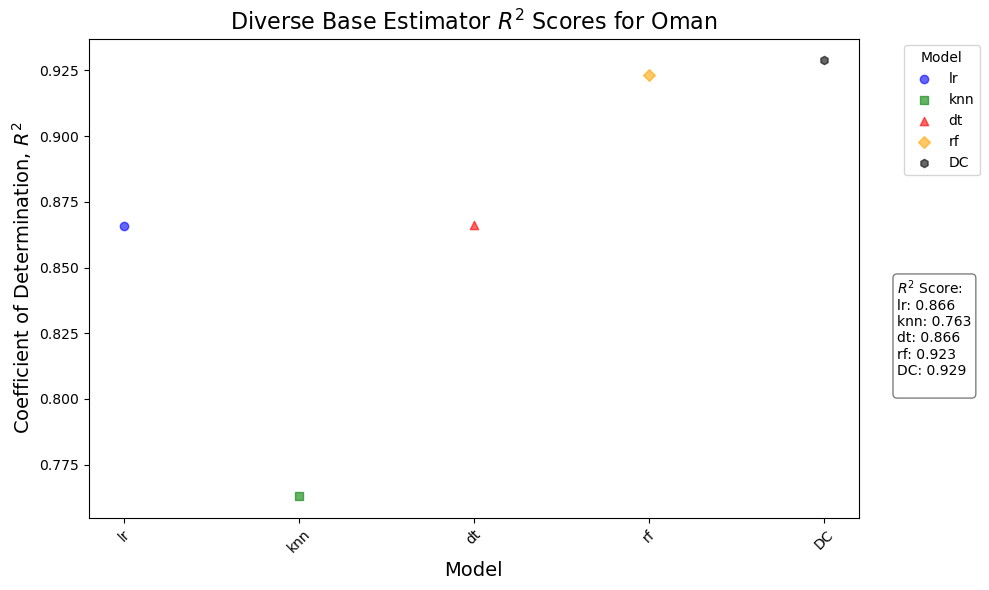

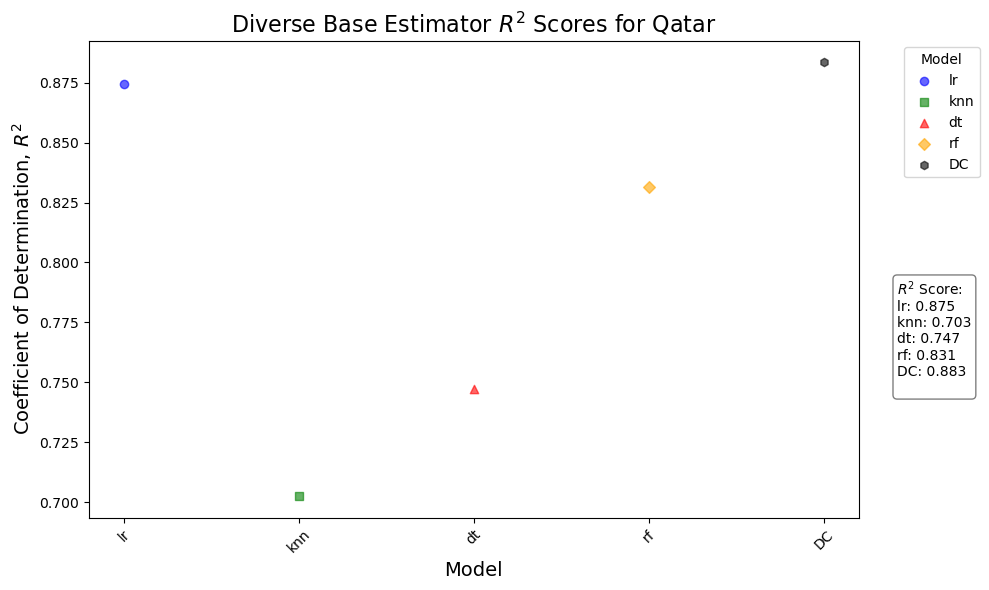

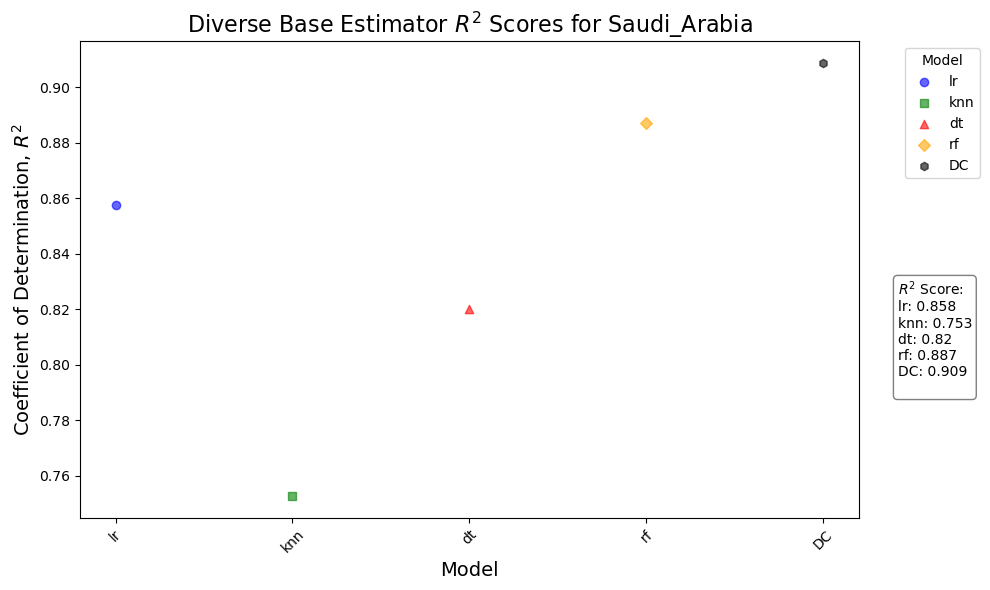

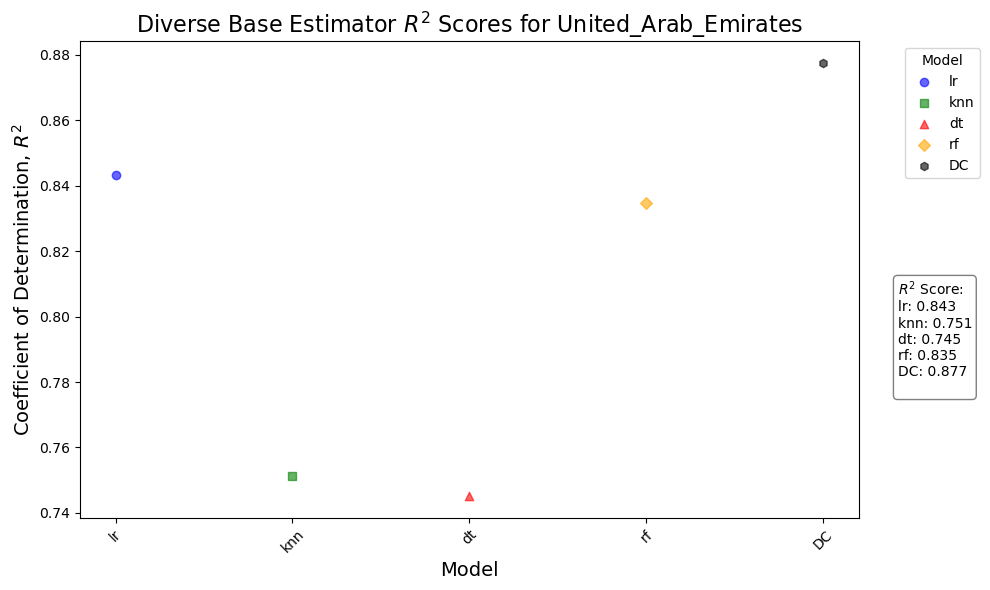

In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Load the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\sfc_model_metrics_1980_2022_v0060.csv"
data = pd.read_csv(file_path)

# Rename ensemble model to 'DustCast' (DC)
data['Model'] = data['Model'].replace({'ensemble': 'DC'})

# Country mapping
country_mapping = {
    "SA": "Saudi Arabia",
    "YE": "Yemen",
    "OM": "Oman",
    "QA": "Qatar",
    "BH": "Bahrain",
    "AE": "United Arab Emirates",
    "KW": "Kuwait"
}

# Get unique countries and models
countries = data['Country'].unique()
models = data['Model'].unique()

# Define markers and colors for models
markers = ['o', 's', '^', 'D', 'P']  # Circle, square, triangle, diamond, pentagon
colors = ['blue', 'green', 'red', 'orange', 'purple']
model_styles = dict(zip(models, zip(colors, markers)))

# Add DustCast (DC) with hexagon and black color
model_styles['DC'] = ('black', 'h')

for country in countries:
    country_name = country_mapping.get(country, country)
    fig, ax = plt.subplots(figsize=(10, 6))
    country_data = data[data['Country'] == country]
    
    r2_values_text = "$R^2$ Score:\n"
    
    for model in models:
        model_data = country_data[country_data['Model'] == model]
        if not model_data.empty:
            color, marker = model_styles.get(model, ('gray', 'o'))  # Default gray if missing
            ax.scatter(
                np.full((len(model_data),), model_data['Model'].values),
                model_data['R2'].values,
                color=color,
                marker=marker,
                alpha=0.6,
                label=model
            )
            r2_values_text += f"{model}: {', '.join(map(str, model_data['R2'].values.round(3)))}\n"
    
    ax.set_xlabel('Model', fontsize=14)
    ax.set_ylabel('Coefficient of Determination, $R^2$', fontsize=14)
    ax.set_title(f'Diverse Base Estimator $R^2$ Scores for {country_name}', fontsize=16)
    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1), title="Model")
    plt.xticks(rotation=45)
    
    # Add R2 values text box with title
    props = dict(boxstyle='round', facecolor='white', alpha=0.5)
    ax.text(1.05, 0.5, r2_values_text, transform=ax.transAxes, fontsize=10,
            verticalalignment='top', bbox=props)
    
    plt.tight_layout()
    plt.show()


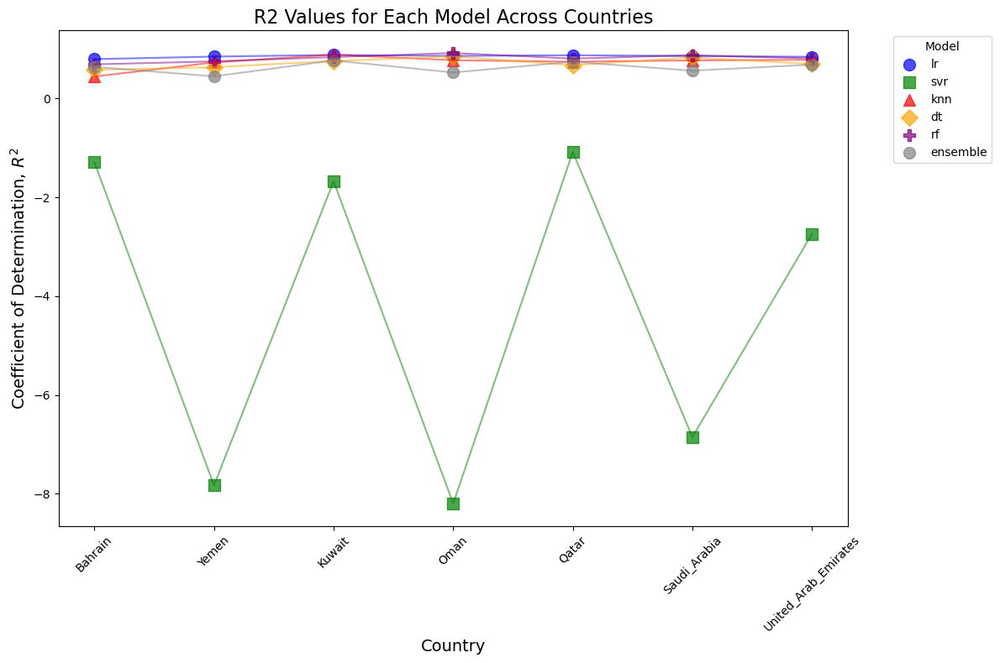

In [3]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\sfc_model_metrics_2016_2020_v0051.csv"
data = pd.read_csv(file_path)

# Define model styles
model_styles = {
    'dc': ('teal', 'h'),  # DustCast (DC)
    'lr': ('blue', 'o'),  # Linear Regression
    'svr': ('green', 's'),  # Support Vector Regression
    'knn': ('red', '^'),  # K-Nearest Neighbors
    'dt': ('orange', 'D'),  # Decision Tree
    'rf': ('purple', 'P')  # Random Forest
}

# Get unique models and countries
models = data['Model'].unique()
countries = data['Country'].unique()

# Create plot
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each model's R2 values for all countries
for model in models:
    model_data = data[data['Model'] == model]
    if not model_data.empty:
        color, marker = model_styles.get(model, ('gray', 'o'))
        ax.scatter(model_data['Country'], model_data['R2'], color=color, marker=marker, label=model, alpha=0.7, s=100)
        ax.plot(model_data['Country'], model_data['R2'], linestyle='-', color=color, alpha=0.5)

# Formatting
ax.set_xlabel('Country', fontsize=14)
ax.set_ylabel('Coefficient of Determination, $R^2$', fontsize=14)
ax.set_title('R2 Values for Each Model Across Countries', fontsize=16)
ax.legend(title="Model", loc='upper left', bbox_to_anchor=(1.05, 1))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
!pip install seaborn

Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\feature_importance_plots\feature_importance_Bahrain.png


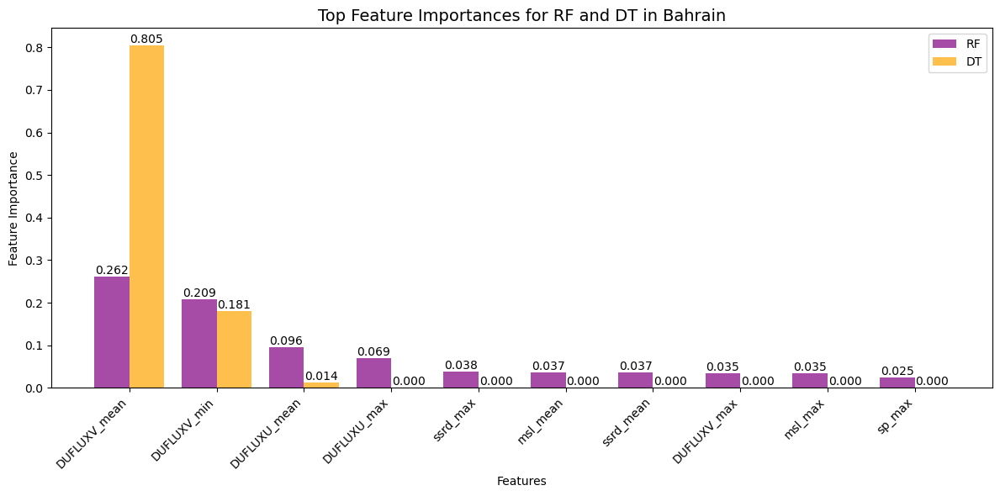

Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\feature_importance_plots\feature_importance_Yemen.png


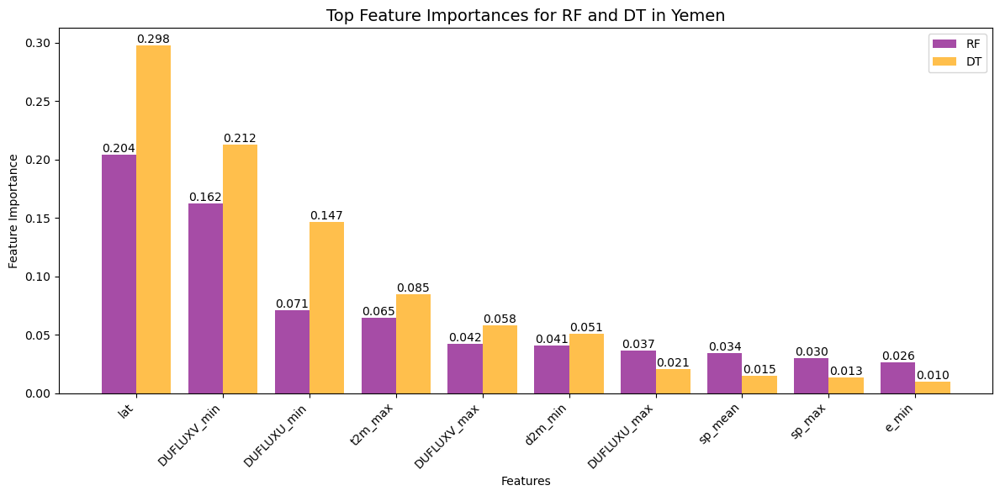

Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\feature_importance_plots\feature_importance_Kuwait.png


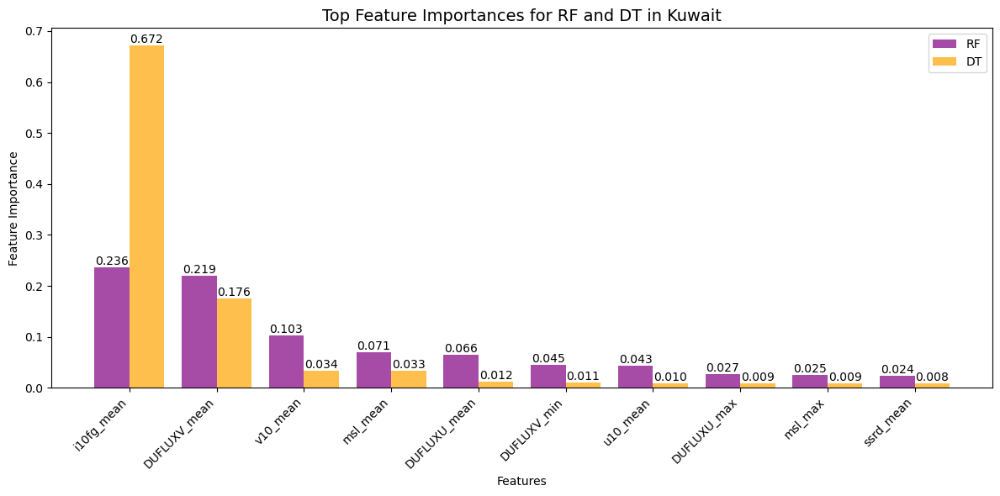

Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\feature_importance_plots\feature_importance_Oman.png


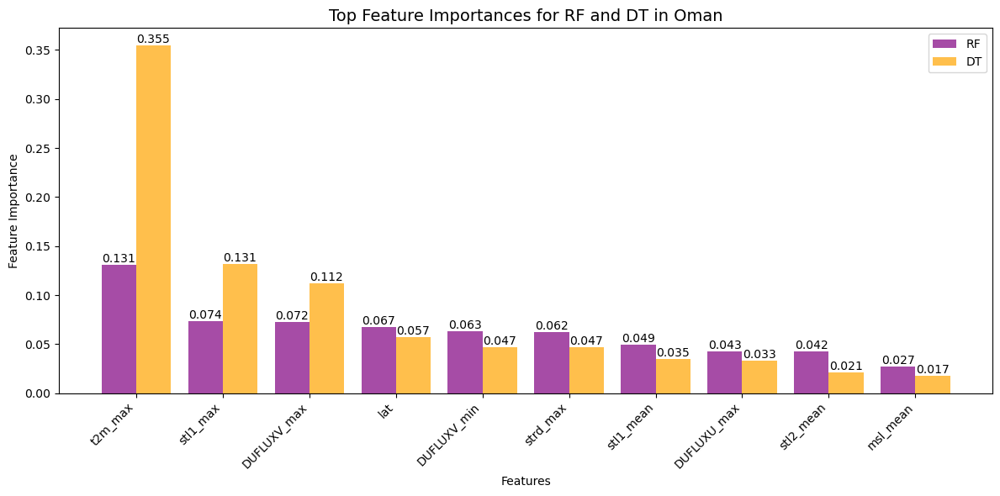

Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\feature_importance_plots\feature_importance_Qatar.png


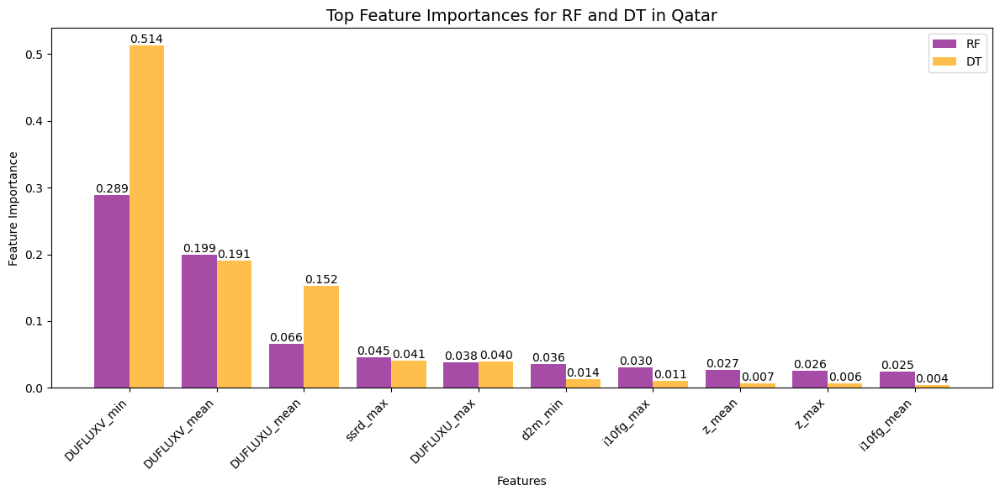

Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\feature_importance_plots\feature_importance_Saudi_Arabia.png


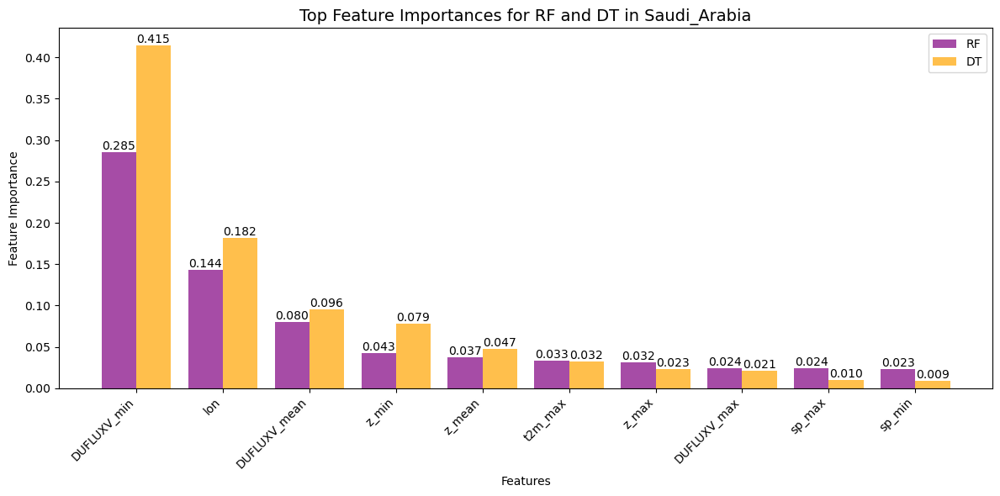

Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\feature_importance_plots\feature_importance_United_Arab_Emirates.png


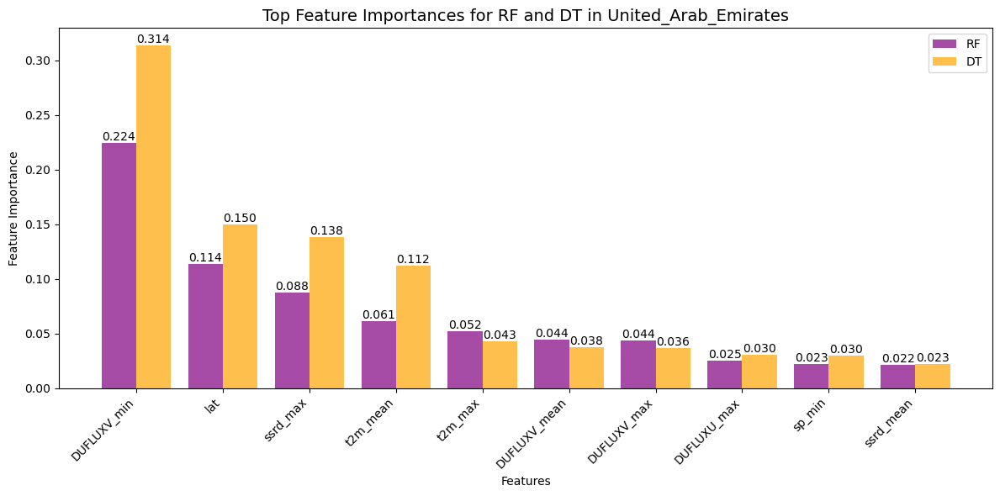

In [6]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\sfc_feature_importances_1980_2022_v0060.csv"
feature_importances_data = pd.read_csv(file_path)

# Define output directory for feature importance plots
output_dir = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0061\feature_importance_plots"
os.makedirs(output_dir, exist_ok=True)  # Ensure directory exists

# Get unique countries
countries = feature_importances_data['Country'].unique()

for country in countries:
    country_data = feature_importances_data[feature_importances_data['Country'] == country]
    
    # Select top features for RF and DT
    top_features_rf = country_data[['Feature', 'rf']].sort_values(by='rf', ascending=False).head(10)
    top_features_dt = country_data[['Feature', 'dt']].sort_values(by='dt', ascending=False).head(10)
    
    bar_width = 0.4
    indices = np.arange(len(top_features_rf))
    
    fig, ax = plt.subplots(figsize=(12, 6))
    bars_rf = ax.bar(indices - bar_width / 2, top_features_rf['rf'], bar_width, label='RF', color='purple', alpha=0.7)
    bars_dt = ax.bar(indices + bar_width / 2, top_features_dt['dt'], bar_width, label='DT', color='orange', alpha=0.7)
    
    ax.set_title(f'Top Feature Importances for RF and DT in {country}', fontsize=14)
    ax.set_ylabel('Feature Importance')
    ax.set_xlabel('Features')
    ax.set_xticks(indices)
    ax.set_xticklabels(top_features_rf['Feature'], rotation=45, ha='right')
    ax.legend()
    
    # Add text labels on bars
    for bar in bars_rf:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.3f}', ha='center', va='bottom', fontsize=10)
    
    for bar in bars_dt:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.3f}', ha='center', va='bottom', fontsize=10)
    
    fig.tight_layout()
    
    # Save the plot
    save_path = os.path.join(output_dir, f"feature_importance_{country}.png")
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    print(f"Saved feature importance plot: {save_path}")
    
    plt.show()


Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\feature_importance_plots\feature_importance_Bahrain.png


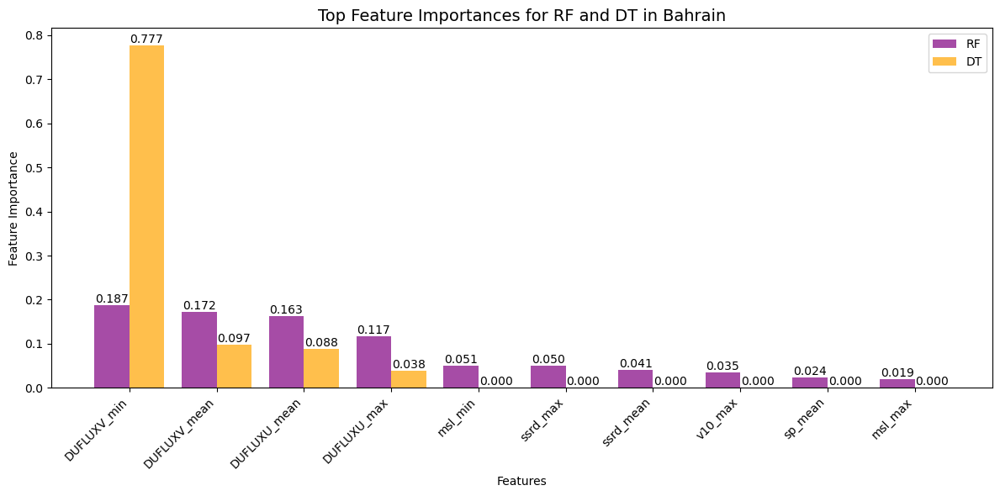

Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\feature_importance_plots\feature_importance_Yemen.png


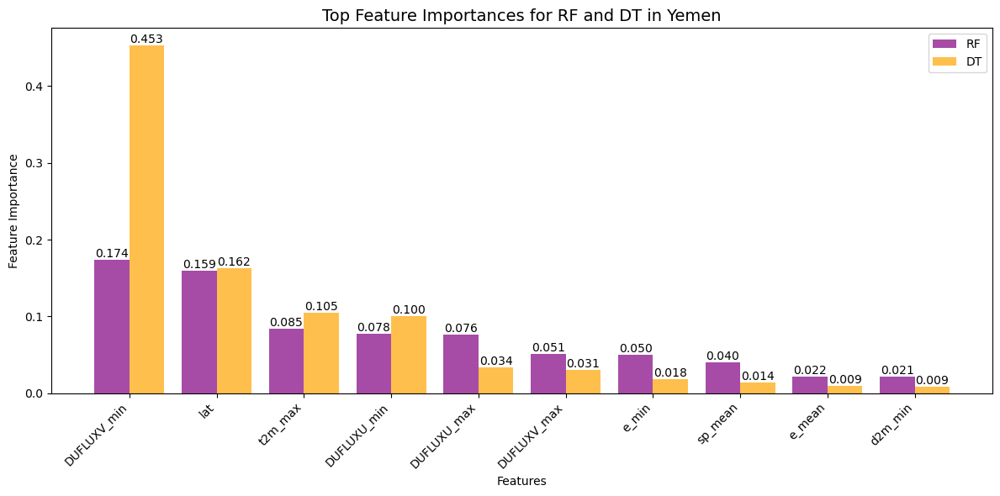

Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\feature_importance_plots\feature_importance_Kuwait.png


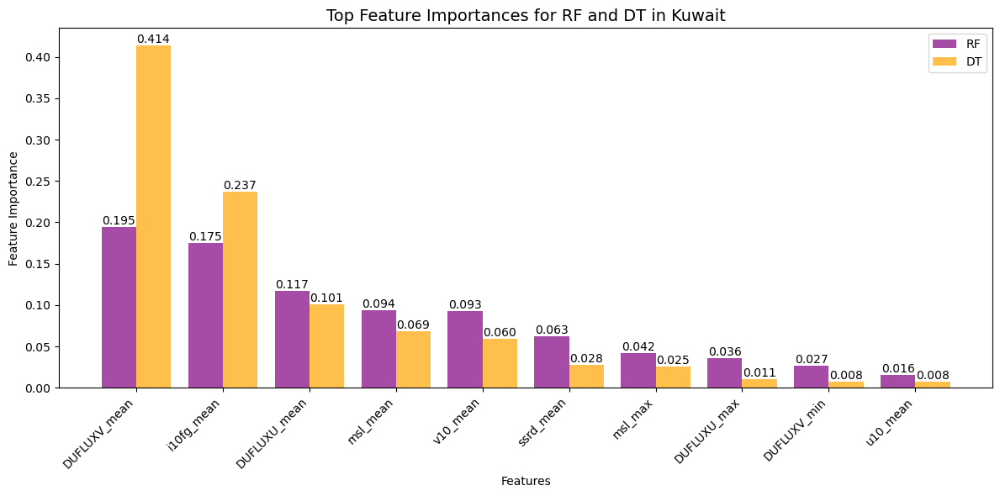

Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\feature_importance_plots\feature_importance_Oman.png


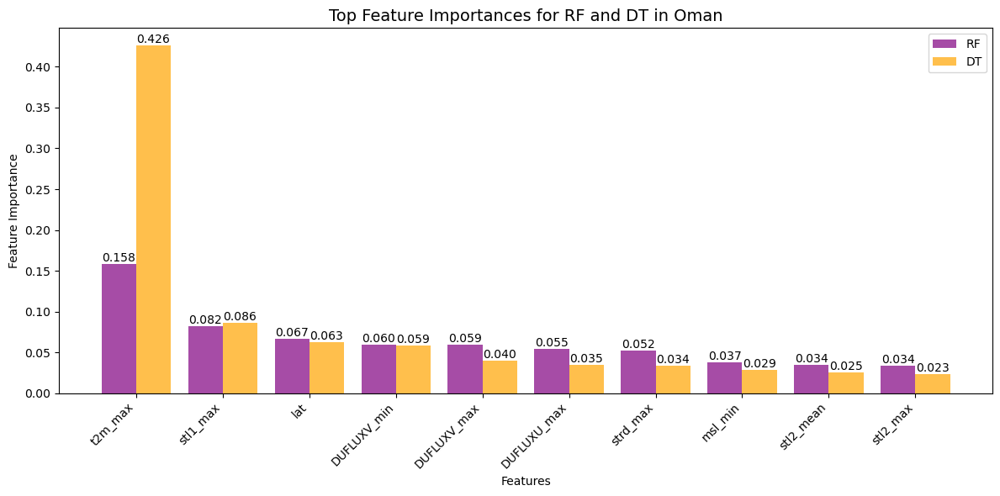

Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\feature_importance_plots\feature_importance_Qatar.png


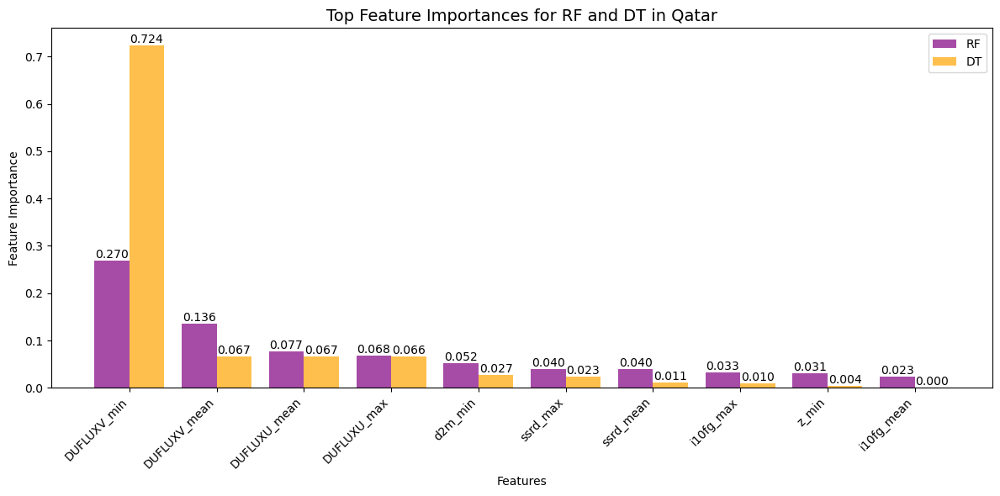

Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\feature_importance_plots\feature_importance_Saudi_Arabia.png


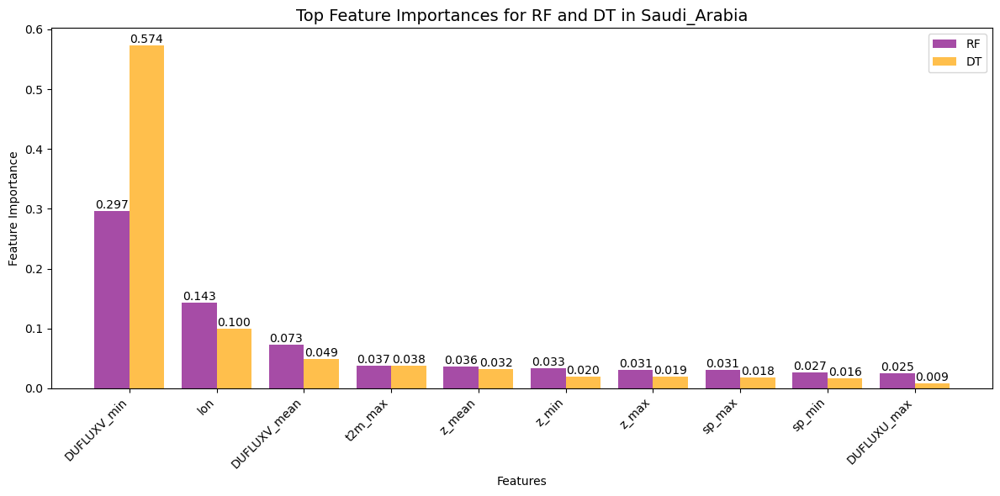

Saved feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\feature_importance_plots\feature_importance_United_Arab_Emirates.png


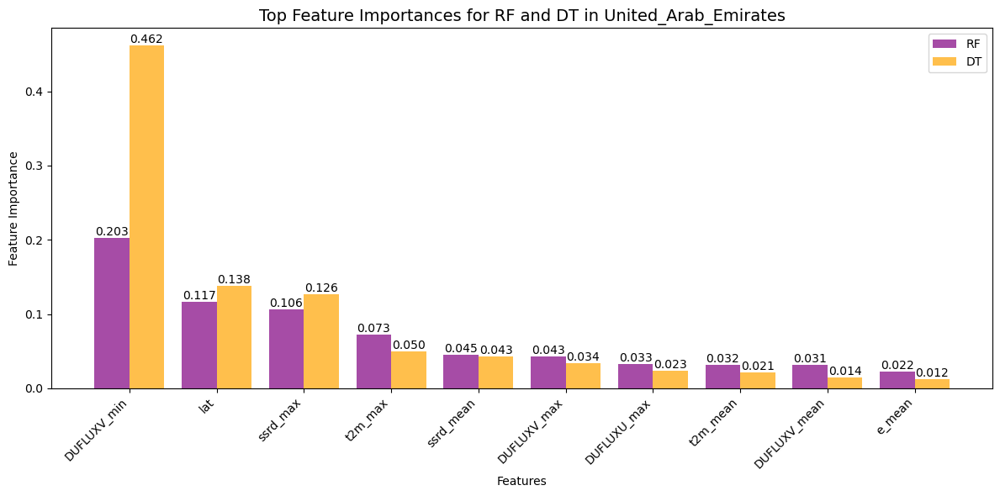

Saved regional feature importance plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\feature_importance_plots\feature_importance_AP.png


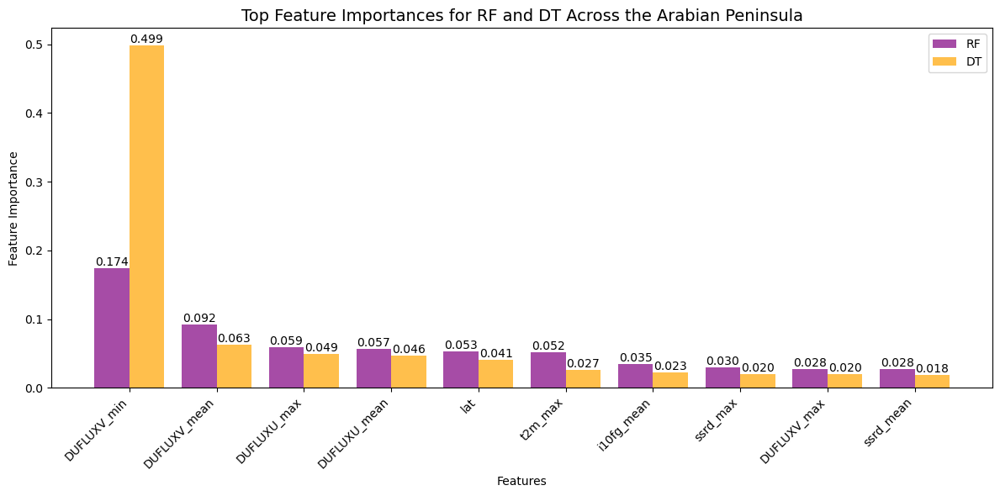

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\sfc_feature_importances_2016_2020_v0051.csv"
feature_importances_data = pd.read_csv(file_path)

# Define output directory for feature importance plots
output_dir = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\feature_importance_plots"
os.makedirs(output_dir, exist_ok=True)  # Ensure directory exists

# Get unique countries
countries = feature_importances_data['Country'].unique()

# Loop through each country to generate feature importance plots
for country in countries:
    country_data = feature_importances_data[feature_importances_data['Country'] == country]

    # Select top features for RF and DT
    top_features_rf = country_data[['Feature', 'rf']].sort_values(by='rf', ascending=False).head(10)
    top_features_dt = country_data[['Feature', 'dt']].sort_values(by='dt', ascending=False).head(10)

    bar_width = 0.4
    indices = np.arange(len(top_features_rf))

    fig, ax = plt.subplots(figsize=(12, 6))
    bars_rf = ax.bar(indices - bar_width / 2, top_features_rf['rf'], bar_width, label='RF', color='purple', alpha=0.7)
    bars_dt = ax.bar(indices + bar_width / 2, top_features_dt['dt'], bar_width, label='DT', color='orange', alpha=0.7)

    ax.set_title(f'Top Feature Importances for RF and DT in {country}', fontsize=14)
    ax.set_ylabel('Feature Importance')
    ax.set_xlabel('Features')
    ax.set_xticks(indices)
    ax.set_xticklabels(top_features_rf['Feature'], rotation=45, ha='right')
    ax.legend()

    # Add text labels on bars
    for bar in bars_rf:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.3f}', ha='center', va='bottom', fontsize=10)

    for bar in bars_dt:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.3f}', ha='center', va='bottom', fontsize=10)

    fig.tight_layout()

    # Save the plot
    save_path = os.path.join(output_dir, f"feature_importance_{country}.png")
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    print(f"Saved feature importance plot: {save_path}")

    plt.show()

# **Compute and plot the average feature importance across the Arabian Peninsula**
average_feature_importance = feature_importances_data.groupby("Feature")[["rf", "dt"]].mean().reset_index()

# Select top features for RF and DT based on the Arabian Peninsula average
top_features_rf_ap = average_feature_importance[['Feature', 'rf']].sort_values(by='rf', ascending=False).head(10)
top_features_dt_ap = average_feature_importance[['Feature', 'dt']].sort_values(by='dt', ascending=False).head(10)

bar_width = 0.4
indices = np.arange(len(top_features_rf_ap))

fig, ax = plt.subplots(figsize=(12, 6))
bars_rf = ax.bar(indices - bar_width / 2, top_features_rf_ap['rf'], bar_width, label='RF', color='purple', alpha=0.7)
bars_dt = ax.bar(indices + bar_width / 2, top_features_dt_ap['dt'], bar_width, label='DT', color='orange', alpha=0.7)

ax.set_title('Top Feature Importances for RF and DT Across the Arabian Peninsula', fontsize=14)
ax.set_ylabel('Feature Importance')
ax.set_xlabel('Features')
ax.set_xticks(indices)
ax.set_xticklabels(top_features_rf_ap['Feature'], rotation=45, ha='right')
ax.legend()

# Add text labels on bars
for bar in bars_rf:
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.3f}', ha='center', va='bottom', fontsize=10)

for bar in bars_dt:
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.3f}', ha='center', va='bottom', fontsize=10)

fig.tight_layout()

# Save the plot
save_path = os.path.join(output_dir, "feature_importance_AP.png")
plt.savefig(save_path, dpi=300, bbox_inches='tight')
print(f"Saved regional feature importance plot: {save_path}")

plt.show()


In [5]:
# Pearsons R for the row level predictions
import pandas as pd
import numpy as np

# Load the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\sfc_row_level_predictions_2021_v0051.csv"
data = pd.read_csv(file_path)

# Drop non-numeric columns
numeric_data = data.select_dtypes(include=[np.number])

# Compute Pearson correlation matrix
cor_matrix = numeric_data.corr(method='pearson')

# Save to CSV
output_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\Pearsons_R.csv"
cor_matrix.to_csv(output_path, index=True)

print(f"Pearson correlation matrix saved to {output_path}")

Pearson correlation matrix saved to Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\Pearsons_R.csv


Saved Pearson correlation heatmap: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\correlation_plots\pearson_heatmap.png


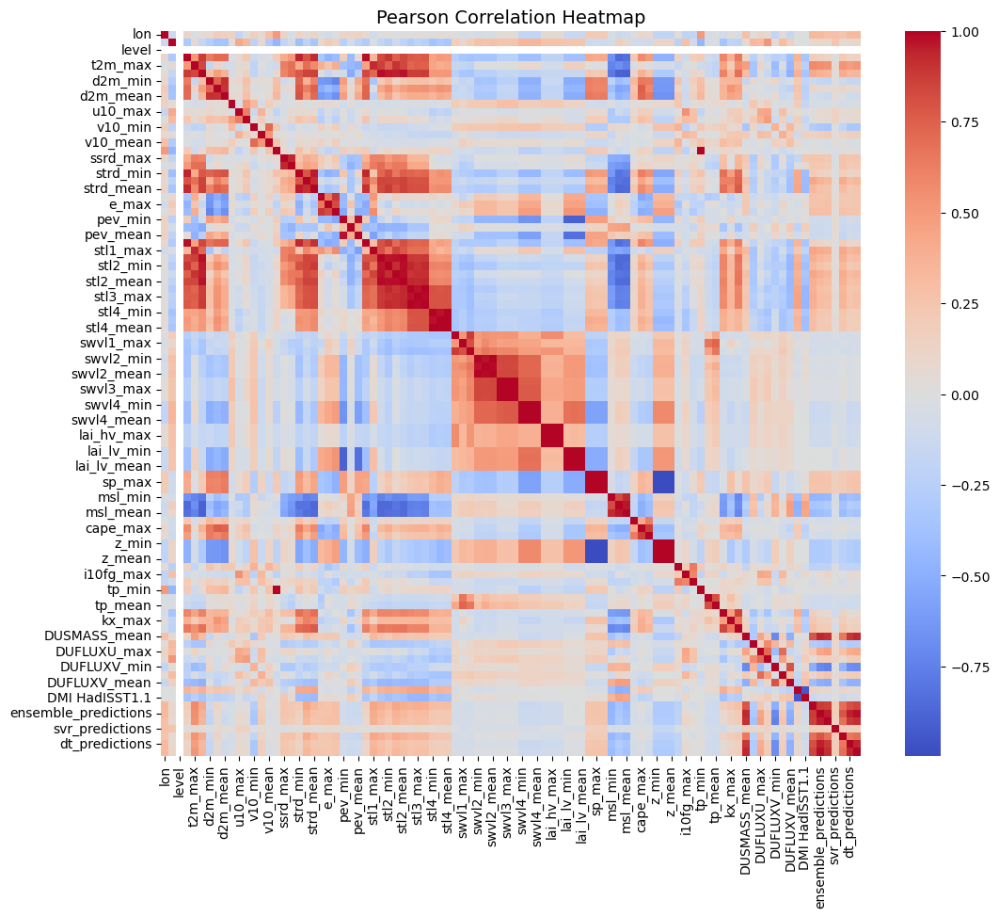

High correlation pairs saved to Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\high_correlation_features.csv


In [6]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load the Pearson correlation matrix from CSV
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\Pearsons_R.csv"
cor_matrix = pd.read_csv(file_path, index_col=0)

# Define output directory for correlation plots
output_dir = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\correlation_plots"
os.makedirs(output_dir, exist_ok=True)  # Ensure directory exists

# Plot heatmap without annotations
fig, ax = plt.subplots(figsize=(12, 10))
sns.heatmap(cor_matrix, annot=False, cbar=True, cmap="coolwarm", ax=ax)
ax.set_title('Pearson Correlation Heatmap', fontsize=14)

# Save the heatmap
heatmap_save_path = os.path.join(output_dir, "pearson_heatmap.png")
plt.savefig(heatmap_save_path, dpi=300, bbox_inches='tight')
print(f"Saved Pearson correlation heatmap: {heatmap_save_path}")

plt.show()

# Extract correlation pairs greater than 0.75 and exclude values of 1.00
high_corr = cor_matrix.unstack().reset_index()
high_corr.columns = ['Feature1', 'Feature2', 'Correlation']
high_corr = high_corr[(high_corr['Feature1'] != high_corr['Feature2']) & (high_corr['Correlation'] < 1.00)]  # Remove self-correlations and 1.00 values
high_corr = high_corr[high_corr['Correlation'] > 0.75].drop_duplicates().sort_values(by='Correlation', ascending=False)

# Function to check if variable names match base name but end with _mean, _max, _min
def exclude_similar_variables(df):
    to_exclude = set()
    for index, row in df.iterrows():
        base1, suffix1 = row['Feature1'].rsplit('_', 1) if '_' in row['Feature1'] else (row['Feature1'], '')
        base2, suffix2 = row['Feature2'].rsplit('_', 1) if '_' in row['Feature2'] else (row['Feature2'], '')
        if base1 == base2 and suffix1 in {'mean', 'max', 'min'} and suffix2 in {'mean', 'max', 'min'}:
            to_exclude.add(index)
    return df.drop(to_exclude)

# Apply exclusion filter
high_corr = exclude_similar_variables(high_corr)

# Save high correlation values to CSV
output_csv_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\high_correlation_features.csv"
high_corr.to_csv(output_csv_path, index=False)

print(f"High correlation pairs saved to {output_csv_path}")


In [7]:
import pandas as pd

# Load the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\sfc_row_level_predictions_2021_v0051.csv"
data = pd.read_csv(file_path)

# Ensure 'Country' column exists
if 'Country' not in data.columns:
    raise KeyError("The dataset does not contain the required column: 'Country'.")

# Compute index ranges for each country
country_ranges = {}
for country in data['Country'].unique():
    country_indices = data[data['Country'] == country].index
    country_ranges[country] = (country_indices.min() + 1, country_indices.max() + 1)  # +1 to make it 1-based indexing

# Display results
for country, (start, end) in country_ranges.items():
    print(f"{country}: {start} - {end}")


Bahrain: 1 - 24
Yemen: 25 - 6912
Kuwait: 6913 - 7284
Oman: 7285 - 13476
Qatar: 13477 - 13632
Saudi_Arabia: 13633 - 47532
United_Arab_Emirates: 47533 - 48996


Saved DUSMASS mean plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\dusmass_plots\dusmass_mean_plot.png


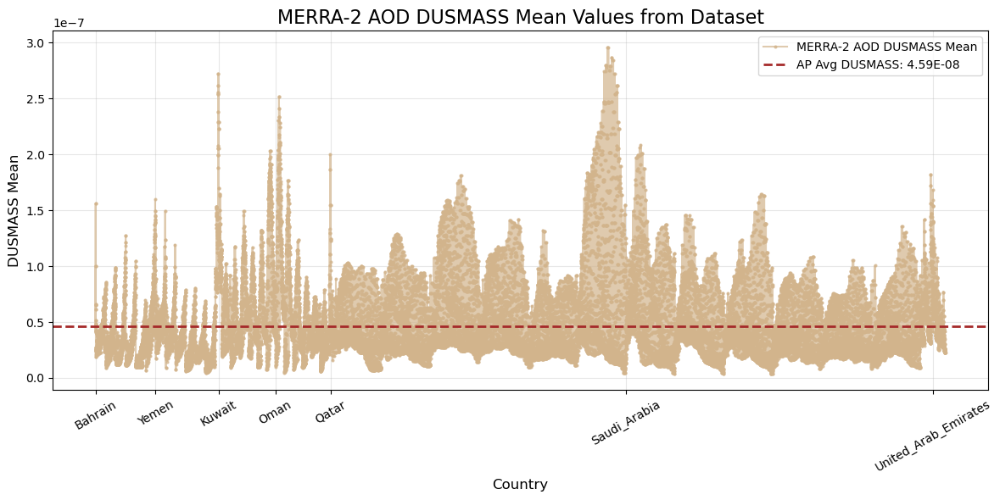

In [8]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Define the file path for the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\sfc_row_level_predictions_2021_v0051.csv"

# Define output directory for DUSMASS plots
output_dir = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\dusmass_plots"
os.makedirs(output_dir, exist_ok=True)  # Ensure directory exists

# Updated country index ranges
country_ranges = {
    "Bahrain": (1, 24),
    "Yemen": (25, 6912),
    "Kuwait": (6913, 7284),
    "Oman": (7285, 13476),
    "Qatar": (13477, 13632),
    "Saudi_Arabia": (13633, 47532),
    "United_Arab_Emirates": (47533, 48996)
}

# Define the average DUSMASS concentration for the AP
average_ducmass = 8.79E-05


# Load the dataset
try:
    dataset = pd.read_csv(file_path)

    # Extract the column 'DUSMASS_mean'
    ducmass_mean = dataset['DUCMASS_mean']

    # Create the figure and plot
    plt.figure(figsize=(12, 6))
    plt.plot(ducmass_mean, linestyle='-', marker='o', markersize=2, color='tan', alpha=0.7, label='MERRA-2 AOD DUCMASS Mean')

    # Add a horizontal line for the average DUSMASS concentration
    plt.axhline(y=average_duCmass, color='brown', linestyle='--', linewidth=2, label=f'AP Avg DUCMASS: {average_ducmass:.2E}')

    # Set x-axis labels by country
    xticks = []
    xticklabels = []
    for country, (start, end) in country_ranges.items():
        mid_index = (start + end) // 2
        xticks.append(mid_index)
        xticklabels.append(country)

    plt.xticks(xticks, xticklabels, rotation=30, fontsize=10)

    # Formatting
    plt.title('MERRA-2 AOD DUCMASS Mean Values from Dataset', fontsize=16)
    plt.xlabel('Country', fontsize=12)
    plt.ylabel('DUCMASS Mean', fontsize=12)
    plt.legend()
    plt.grid(alpha=0.3)
    plt.tight_layout()

    # Save the plot
    save_path = os.path.join(output_dir, "ducmass_mean_plot.png")
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    print(f"Saved DUCMASS mean plot: {save_path}")

    # Show the plot
    plt.show()

except FileNotFoundError:
    print("The file was not found. Please ensure the file path is correct.")
except KeyError:
    print("'DUCMASS_mean' column not found in the dataset.")
except Exception as e:
    print(f"An error occurred: {e}")


Saved DUSMASS mean plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\dusmass_plots\dusmass_mean_plot_ensemble_preds.png


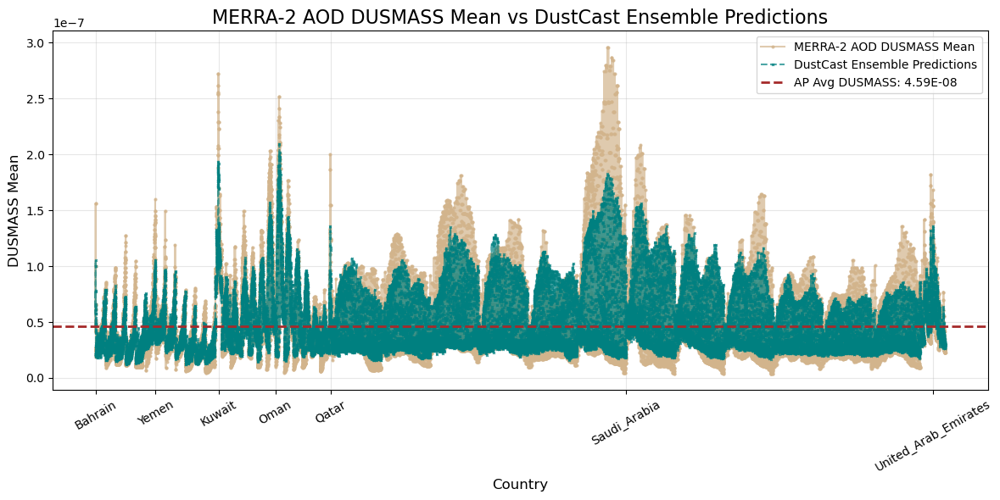

In [9]:
import pandas as pd
import matplotlib.pyplot as plt

# Define the file path for the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\sfc_row_level_predictions_2021_v0051.csv"

# Define output directory for DUSMASS plots
output_dir = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\dusmass_plots"
os.makedirs(output_dir, exist_ok=True)  # Ensure directory exists

# Updated country index ranges
country_ranges = {
    "Bahrain": (1, 24),
    "Yemen": (25, 6912),
    "Kuwait": (6913, 7284),
    "Oman": (7285, 13476),
    "Qatar": (13477, 13632),
    "Saudi_Arabia": (13633, 47532),
    "United_Arab_Emirates": (47533, 48996),
}

# Define the AP average DUSMASS concentration
average_dusmass = 4.59E-08

# Load the dataset
try:
    dataset = pd.read_csv(file_path)

    # Extract required columns
    dusmass_mean = dataset['DUSMASS_mean']
    ensemble_predictions = dataset['ensemble_predictions']

    # Create the plot
    plt.figure(figsize=(12, 6))
    plt.plot(dusmass_mean, linestyle='-', marker='o', markersize=2, color='tan', alpha=0.7, label='MERRA-2 AOD DUSMASS Mean')
    plt.plot(ensemble_predictions, linestyle='--', marker='x', markersize=2, color='teal', alpha=0.7, label='DustCast Ensemble Predictions')

    # Add horizontal line for AP Avg DUSMASS
    plt.axhline(y=average_dusmass, color='brown', linestyle='--', linewidth=2, label=f'AP Avg DUSMASS: {average_dusmass:.2E}')

    # Set x-axis labels by country
    xticks = []
    xticklabels = []
    for country, (start, end) in country_ranges.items():
        mid_index = (start + end) // 2
        xticks.append(mid_index)
        xticklabels.append(country)

    plt.xticks(xticks, xticklabels, rotation=30, fontsize=10)

    # Formatting
    plt.title('MERRA-2 AOD DUSMASS Mean vs DustCast Ensemble Predictions', fontsize=16)
    plt.xlabel('Country', fontsize=12)
    plt.ylabel('DUSMASS Mean', fontsize=12)
    plt.legend()
    plt.grid(alpha=0.3)
    plt.tight_layout()
    
    # Save the plot
    save_path = os.path.join(output_dir, "dusmass_mean_plot_ensemble_preds.png")
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    print(f"Saved DUSMASS mean plot: {save_path}")
    # Show the plot
    plt.show()

except FileNotFoundError:
    print("The file was not found. Please ensure the file path is correct.")
except KeyError as e:
    print(f"Column not found in the dataset: {e}")
except Exception as e:
    print(f"An error occurred: {e}")


Saved model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_prediction_plots\ensemble_predictions_predictions.png


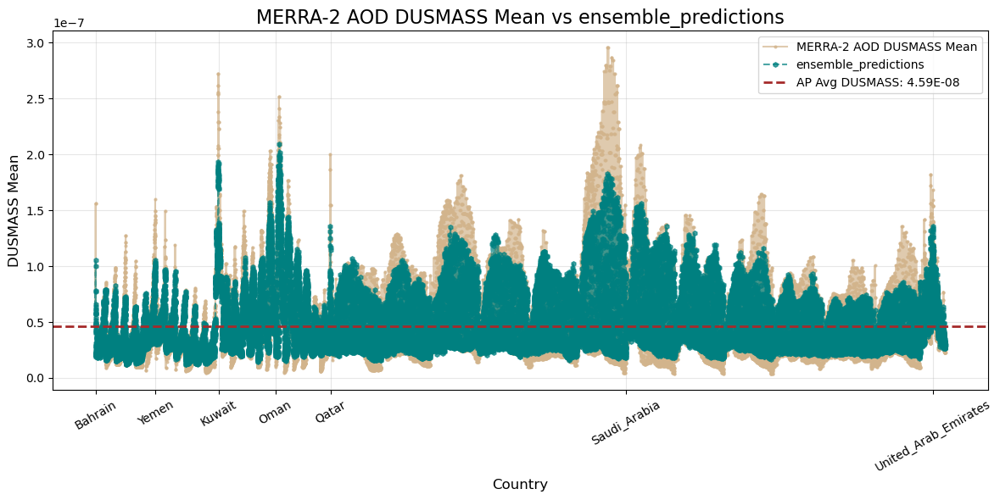

Saved model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_prediction_plots\lr_predictions_predictions.png


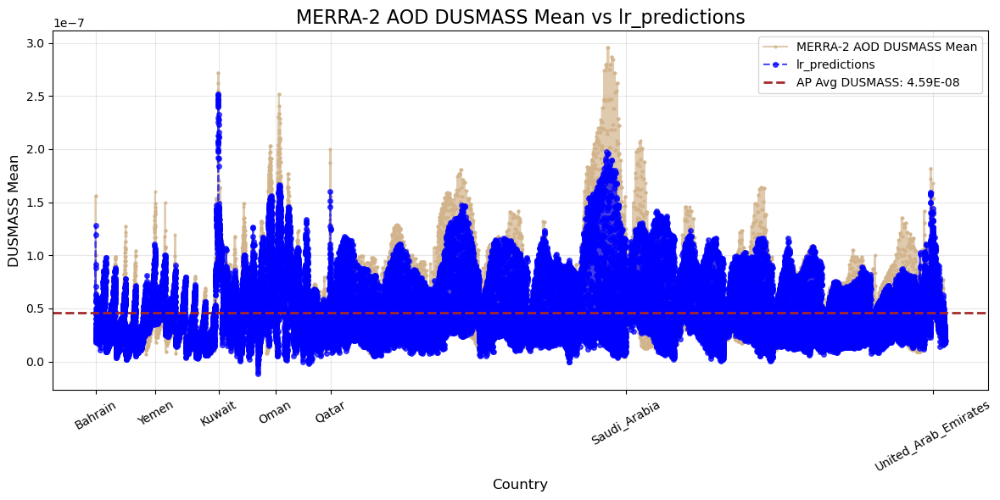

Saved model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_prediction_plots\svr_predictions_predictions.png


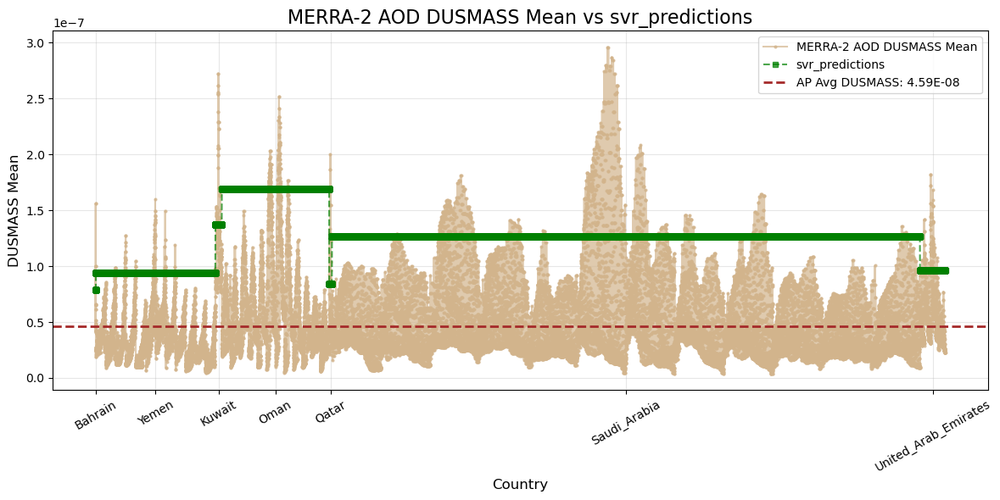

Saved model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_prediction_plots\knn_predictions_predictions.png


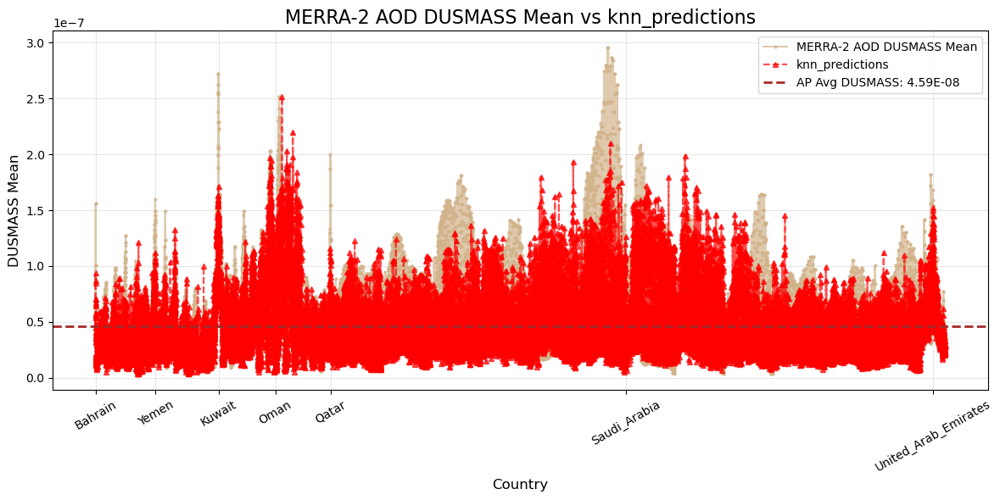

Saved model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_prediction_plots\dt_predictions_predictions.png


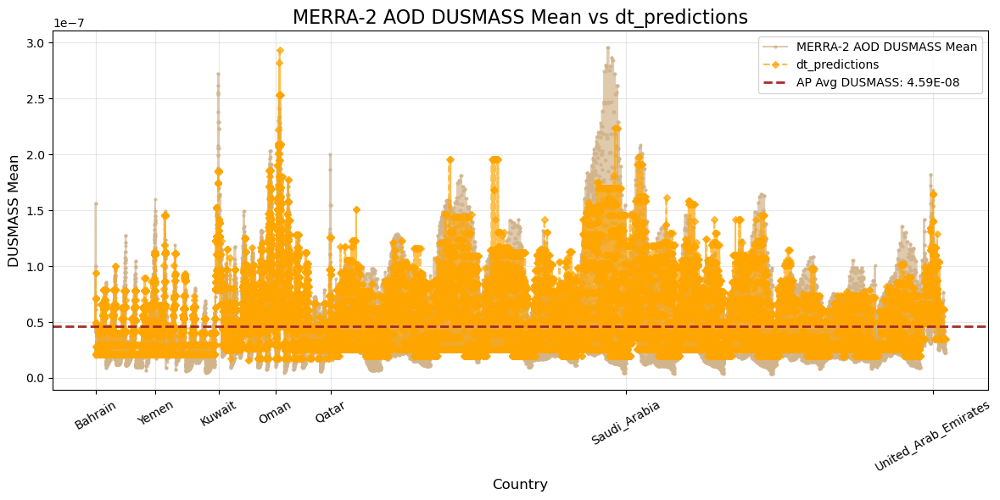

Saved model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_prediction_plots\rf_predictions_predictions.png


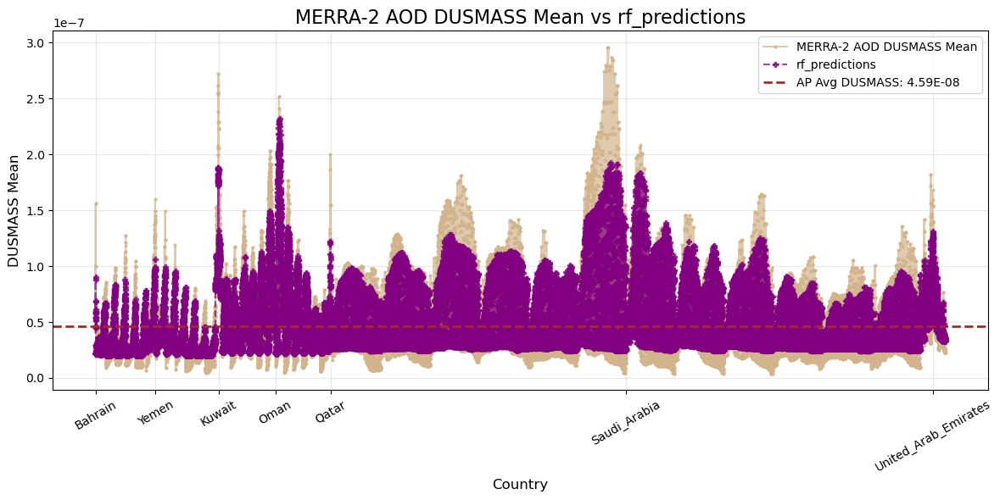

In [2]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Define the file path for the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\sfc_row_level_predictions_2021_v0051.csv"

# Define output directory for model prediction plots
output_dir = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_prediction_plots"
os.makedirs(output_dir, exist_ok=True)  # Ensure directory exists

# Define model styles
model_styles = {
    'ensemble_predictions': ('teal', 'h'),  # DustCast (DC)
    'lr_predictions': ('blue', 'o'),  # Linear Regression
    'svr_predictions': ('green', 's'),  # Support Vector Regression
    'knn_predictions': ('red', '^'),  # K-Nearest Neighbors
    'dt_predictions': ('orange', 'D'),  # Decision Tree
    'rf_predictions': ('purple', 'P')  # Random Forest
}

# Updated country index ranges
country_ranges = {
    "Bahrain": (1, 24),
    "Yemen": (25, 6912),
    "Kuwait": (6913, 7284),
    "Oman": (7285, 13476),
    "Qatar": (13477, 13632),
    "Saudi_Arabia": (13633, 47532),
    "United_Arab_Emirates": (47533, 48996),
}

# Define the AP average DUSMASS concentration
average_dusmass = 4.59E-08

# Load the dataset
try:
    dataset = pd.read_csv(file_path)

    # Extract the required columns
    dusmass_mean = dataset['DUSMASS_mean']
    models = model_styles.keys()

    # Loop through each model and create a separate plot
    for model in models:
        # Extract predictions for the current model
        predictions = dataset[model]
        color, marker = model_styles[model]
        
        # Create the plot
        plt.figure(figsize=(12, 6))
        plt.plot(dusmass_mean, linestyle='-', marker='o', markersize=2, color='tan', alpha=0.7, label='MERRA-2 AOD DUSMASS Mean')
        plt.plot(predictions, linestyle='--', marker=marker, markersize=4, color=color, alpha=0.7, label=f'{model}')
        
        # Add horizontal line for AP Avg DUSMASS
        plt.axhline(y=average_dusmass, color='brown', linestyle='--', linewidth=2, label=f'AP Avg DUSMASS: {average_dusmass:.2E}')

        # Set x-axis labels by country
        xticks = []
        xticklabels = []
        for country, (start, end) in country_ranges.items():
            mid_index = (start + end) // 2
            xticks.append(mid_index)
            xticklabels.append(country)

        plt.xticks(xticks, xticklabels, rotation=30, fontsize=10)

        # Formatting
        plt.title(f'MERRA-2 AOD DUSMASS Mean vs {model}', fontsize=16)
        plt.xlabel('Country', fontsize=12)
        plt.ylabel('DUSMASS Mean', fontsize=12)
        plt.legend()
        plt.grid(alpha=0.3)
        plt.tight_layout()

        # Save the plot
        save_path = os.path.join(output_dir, f"{model}_predictions.png")
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Saved model prediction plot: {save_path}")

        # Show the plot
        plt.show()

except FileNotFoundError:
    print("The file was not found. Please ensure the file path is correct.")
except KeyError as e:
    print(f"Column not found in the dataset: {e}")
except Exception as e:
    print(f"An error occurred: {e}")


Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Bahrain_ensemble_predictions_predictions.png


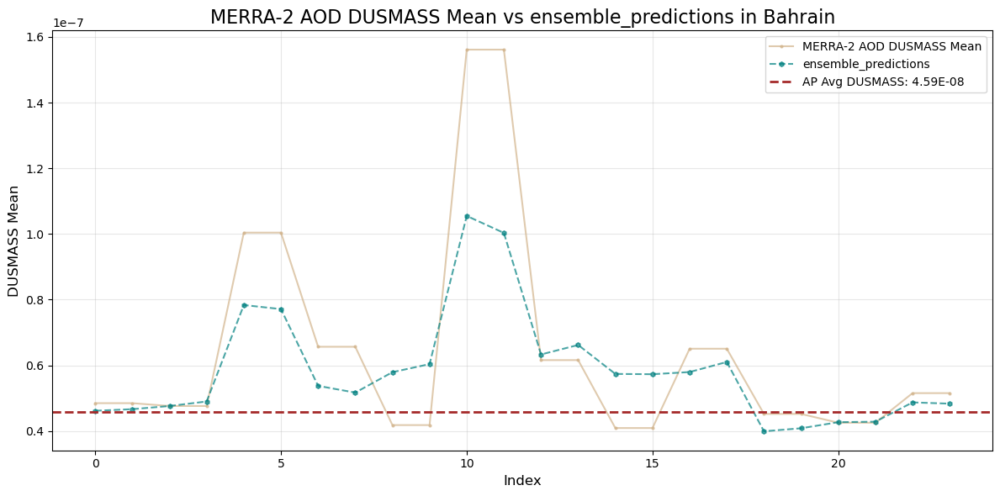

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Bahrain_lr_predictions_predictions.png


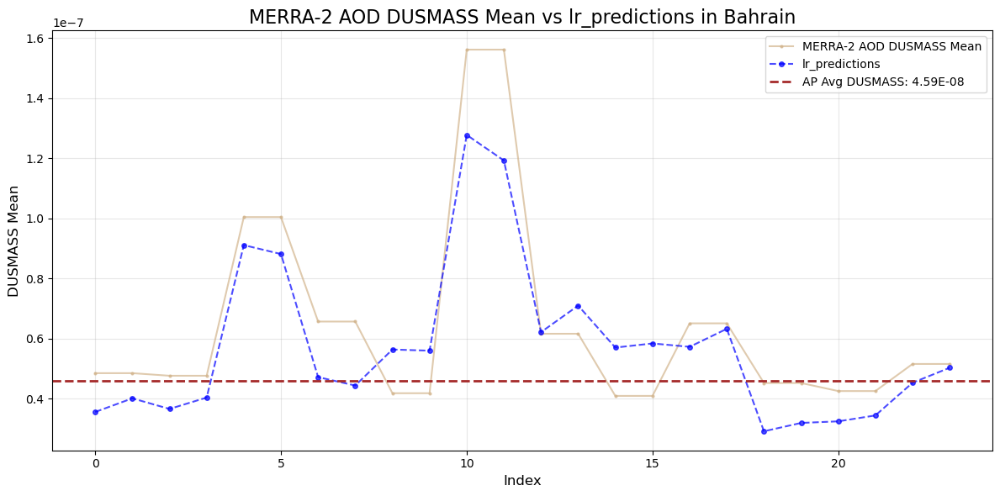

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Bahrain_svr_predictions_predictions.png


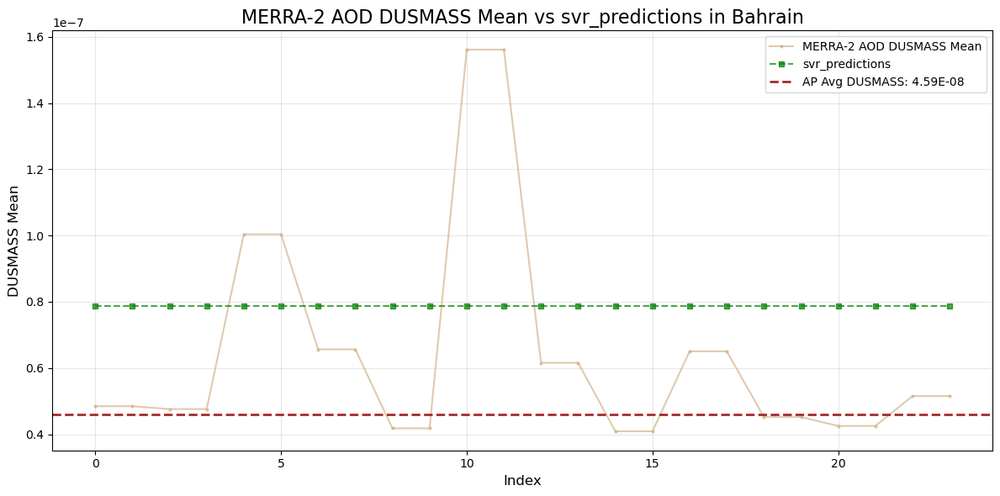

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Bahrain_knn_predictions_predictions.png


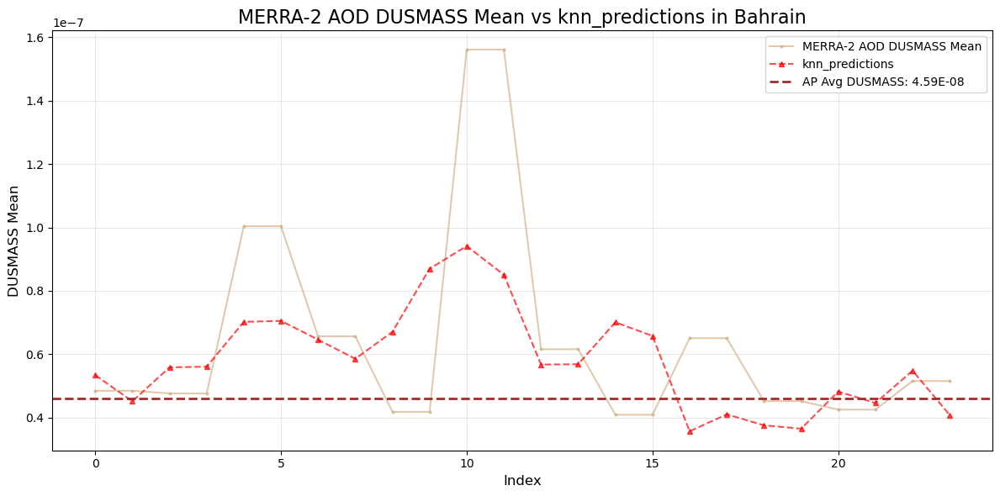

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Bahrain_dt_predictions_predictions.png


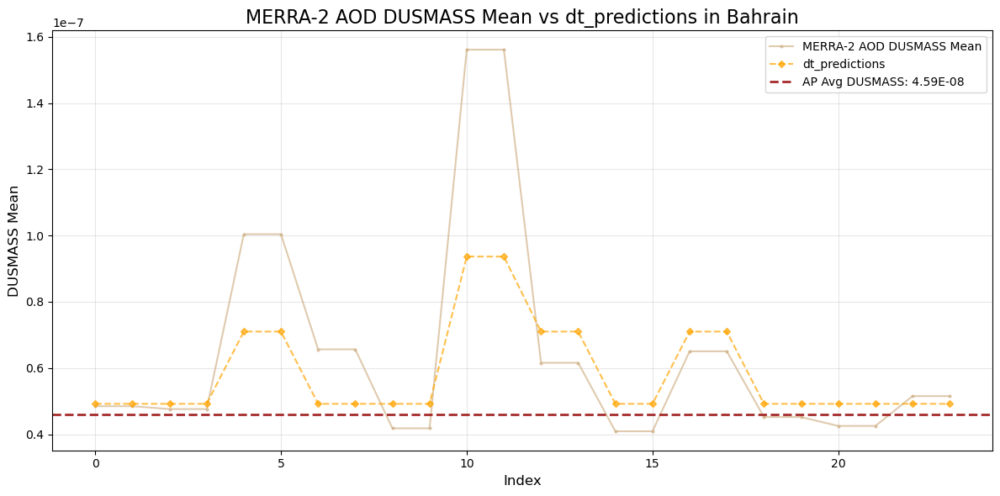

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Bahrain_rf_predictions_predictions.png


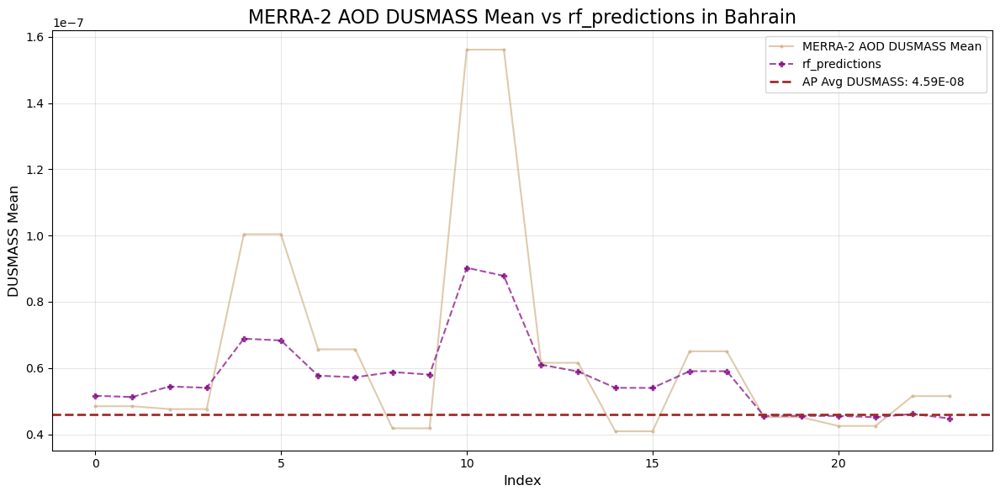

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Yemen_ensemble_predictions_predictions.png


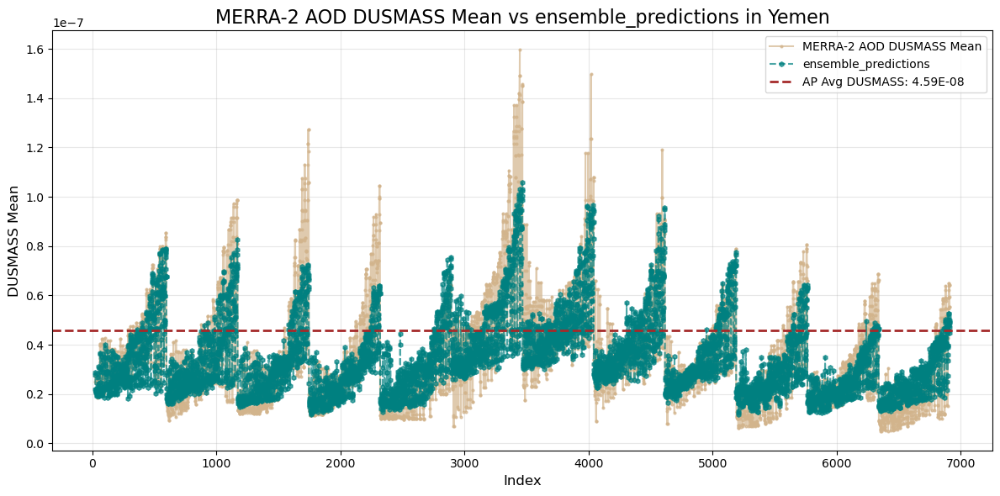

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Yemen_lr_predictions_predictions.png


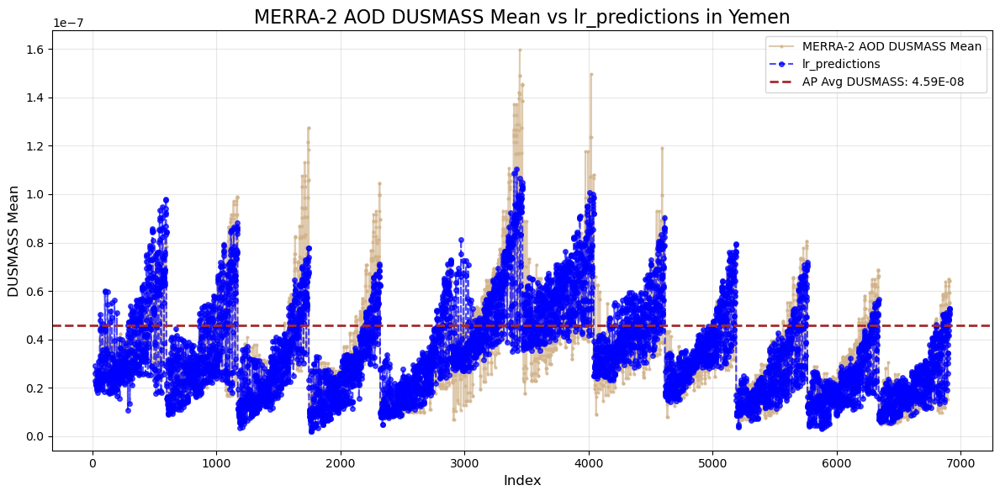

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Yemen_svr_predictions_predictions.png


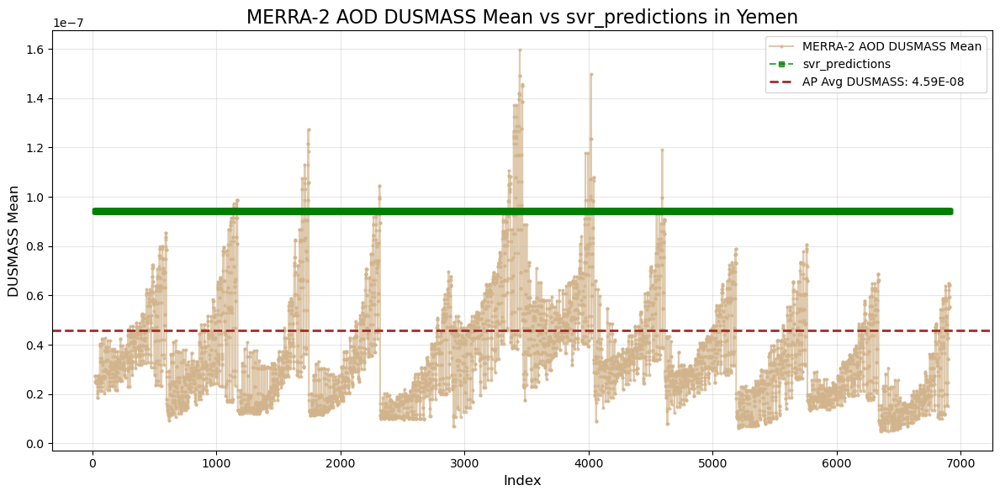

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Yemen_knn_predictions_predictions.png


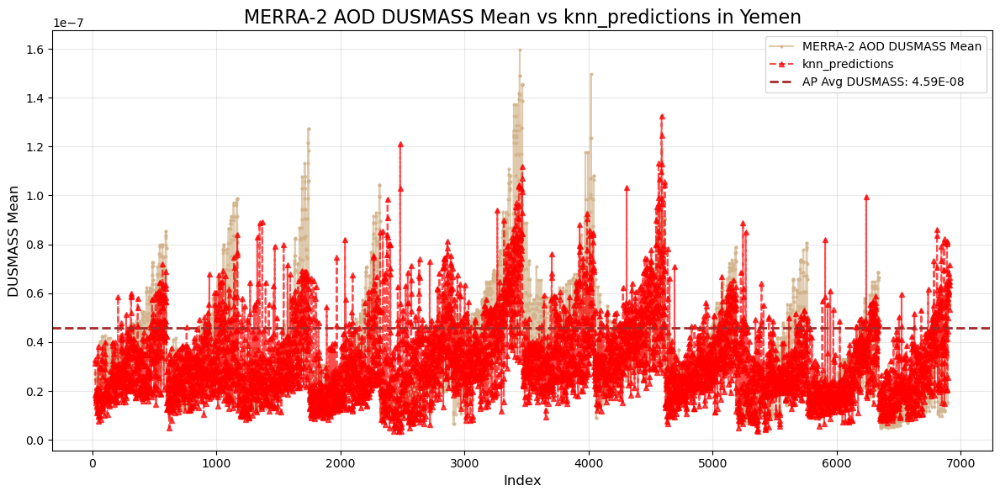

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Yemen_dt_predictions_predictions.png


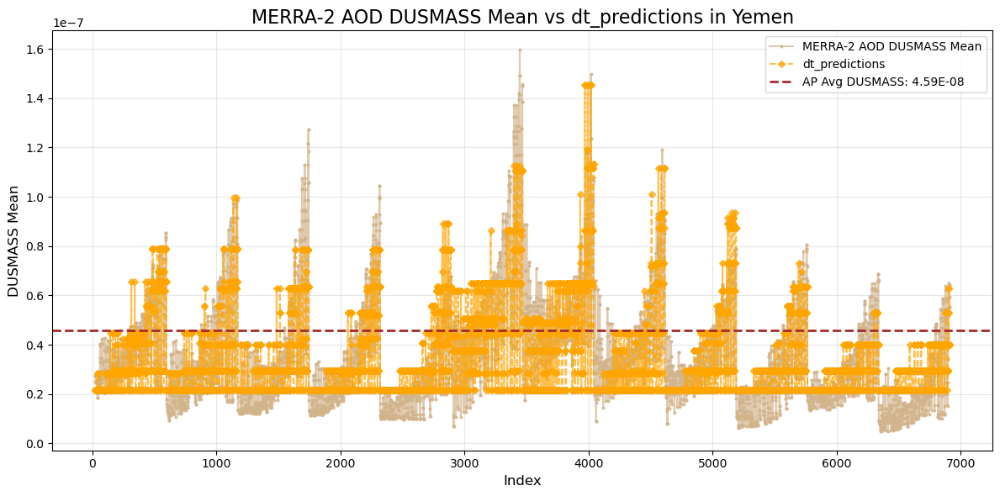

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Yemen_rf_predictions_predictions.png


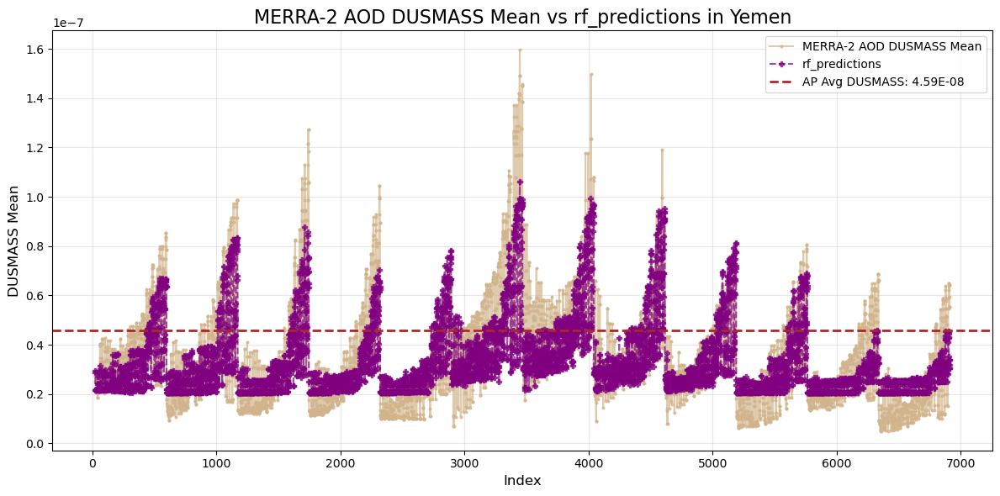

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Kuwait_ensemble_predictions_predictions.png


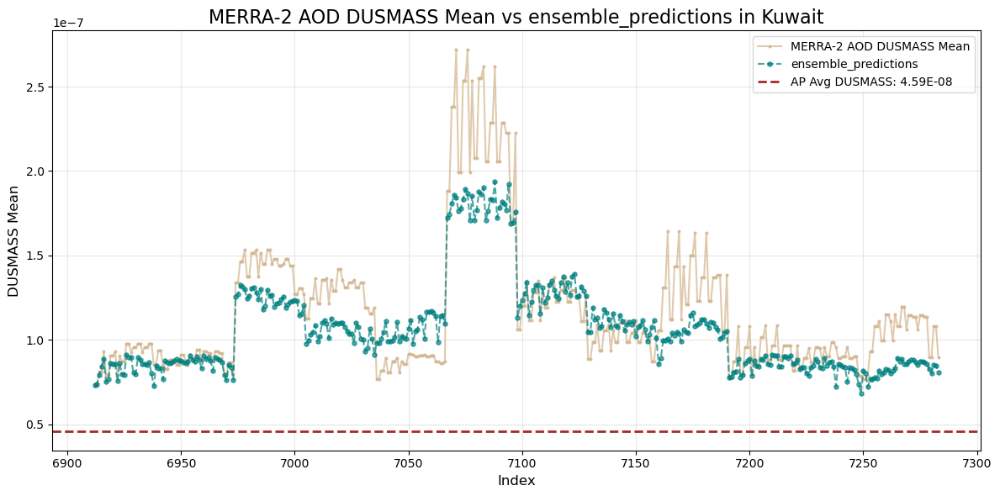

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Kuwait_lr_predictions_predictions.png


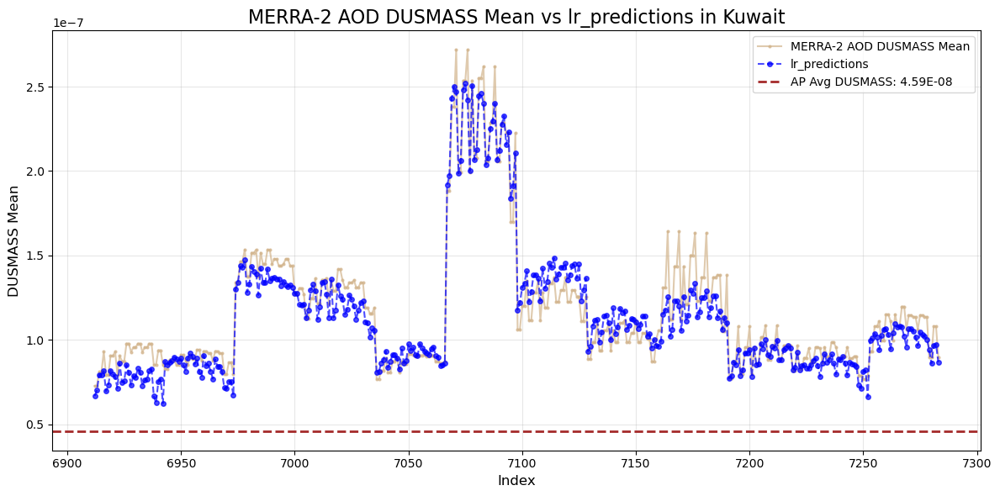

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Kuwait_svr_predictions_predictions.png


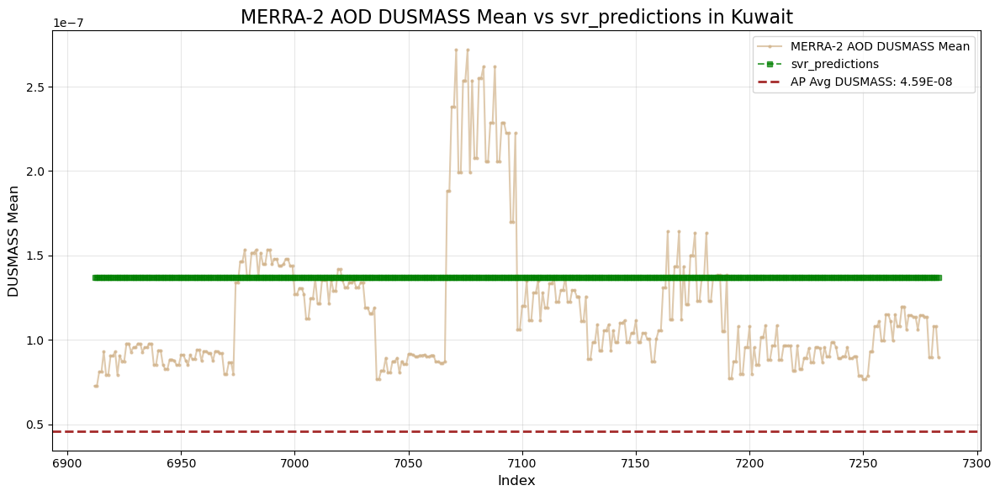

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Kuwait_knn_predictions_predictions.png


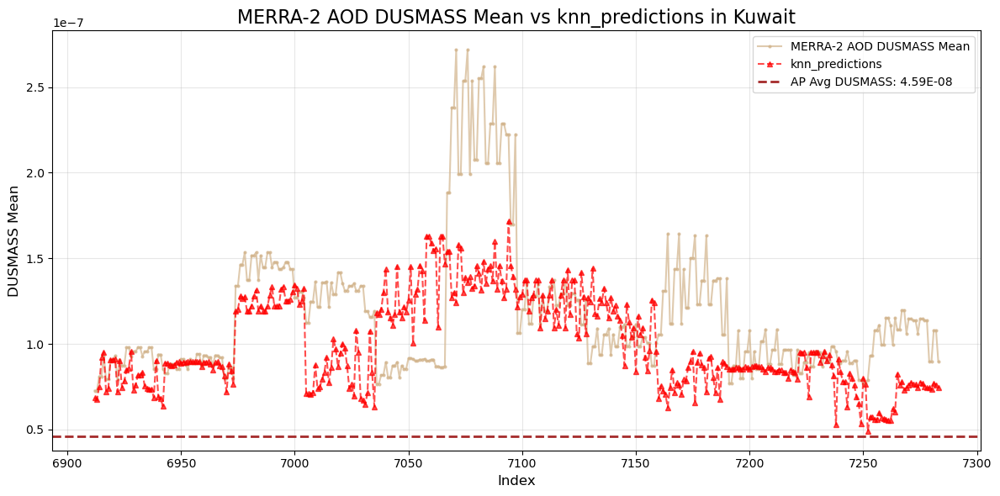

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Kuwait_dt_predictions_predictions.png


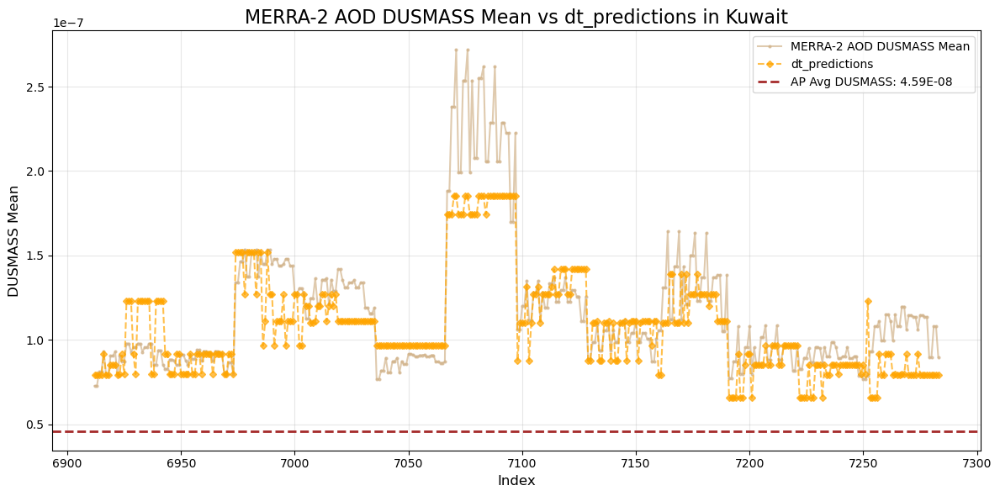

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Kuwait_rf_predictions_predictions.png


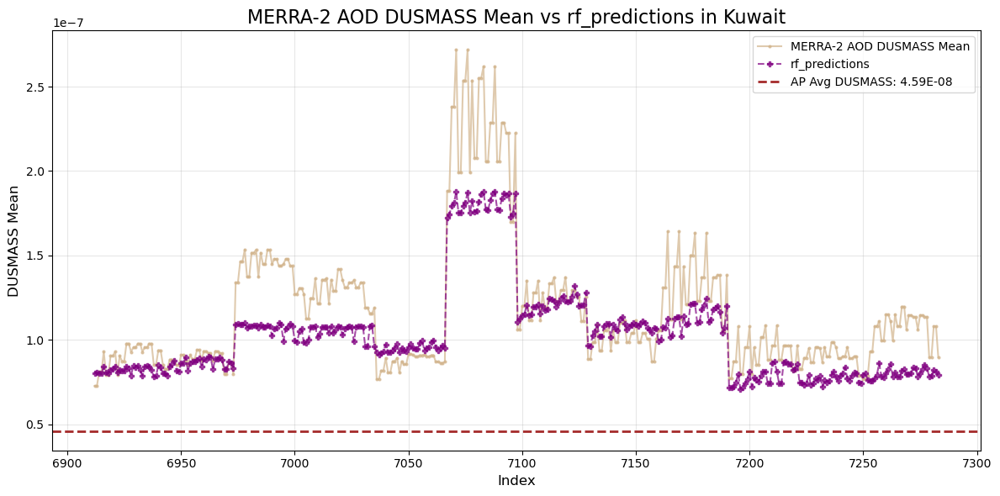

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Oman_ensemble_predictions_predictions.png


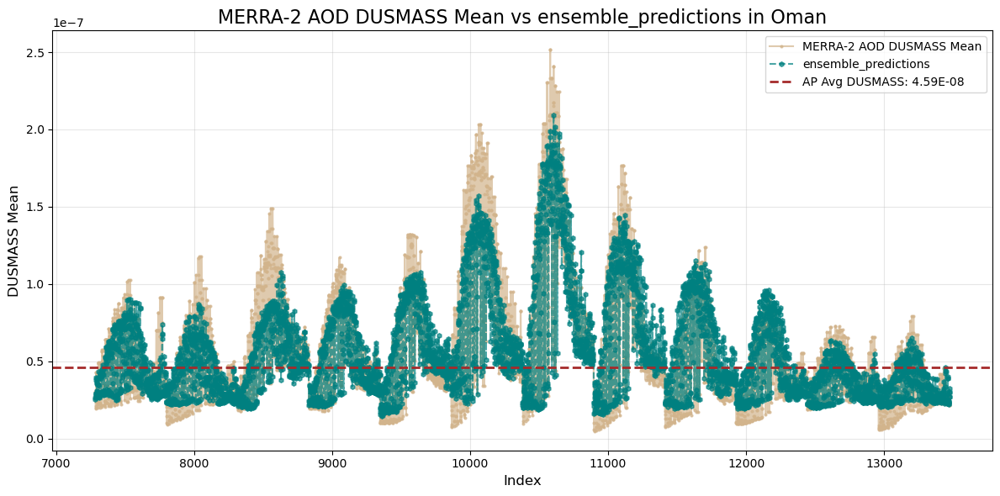

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Oman_lr_predictions_predictions.png


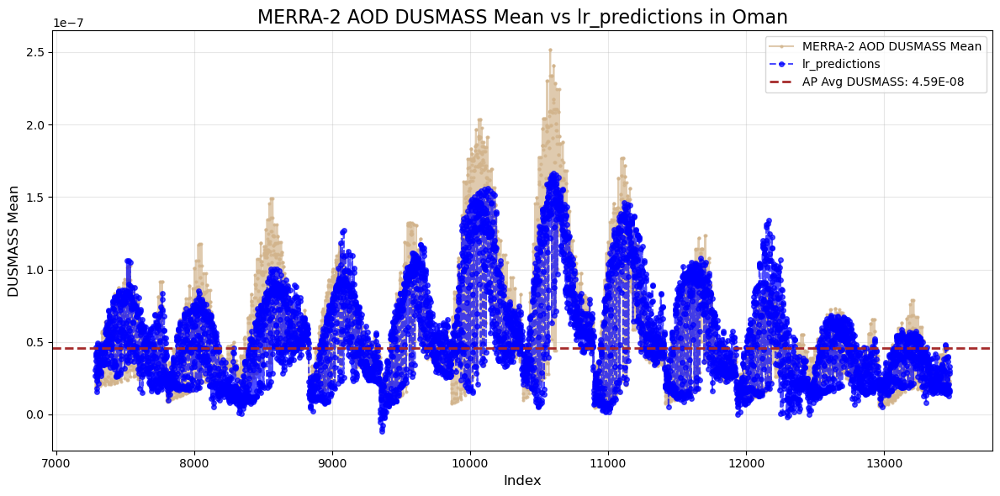

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Oman_svr_predictions_predictions.png


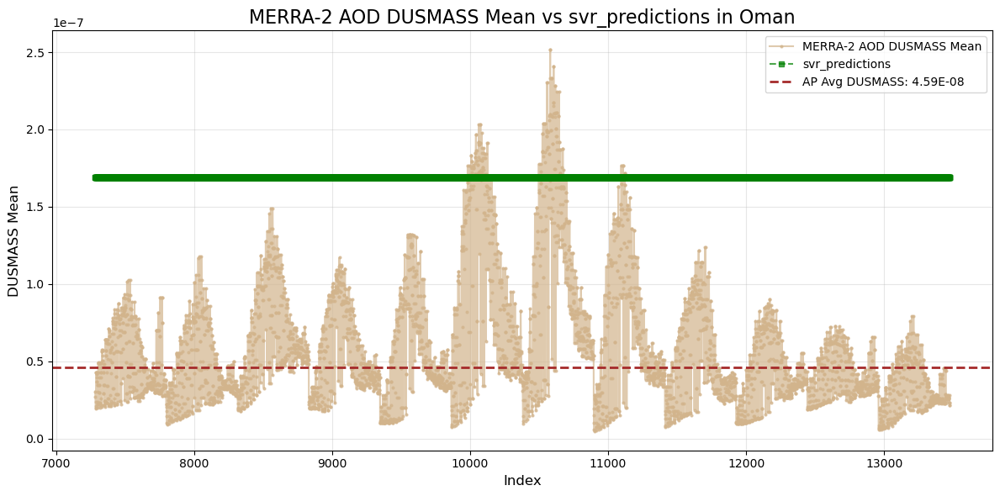

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Oman_knn_predictions_predictions.png


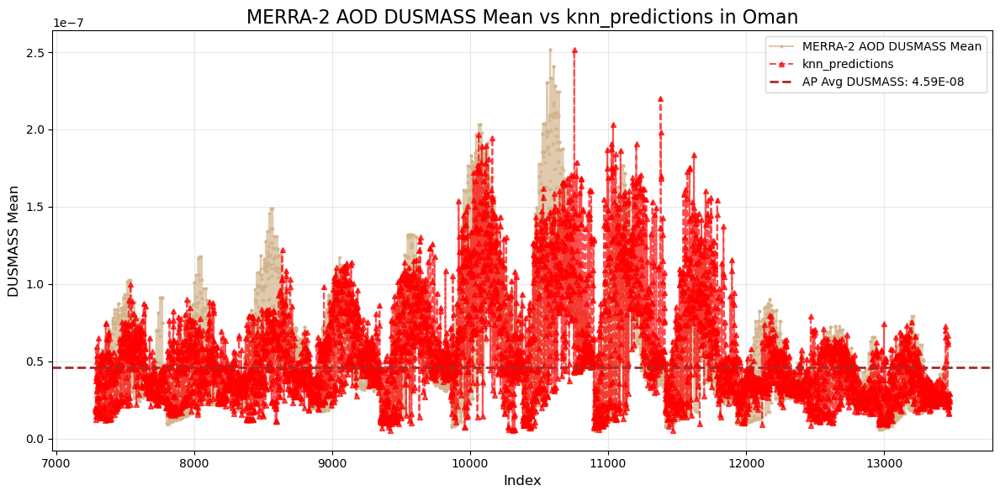

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Oman_dt_predictions_predictions.png


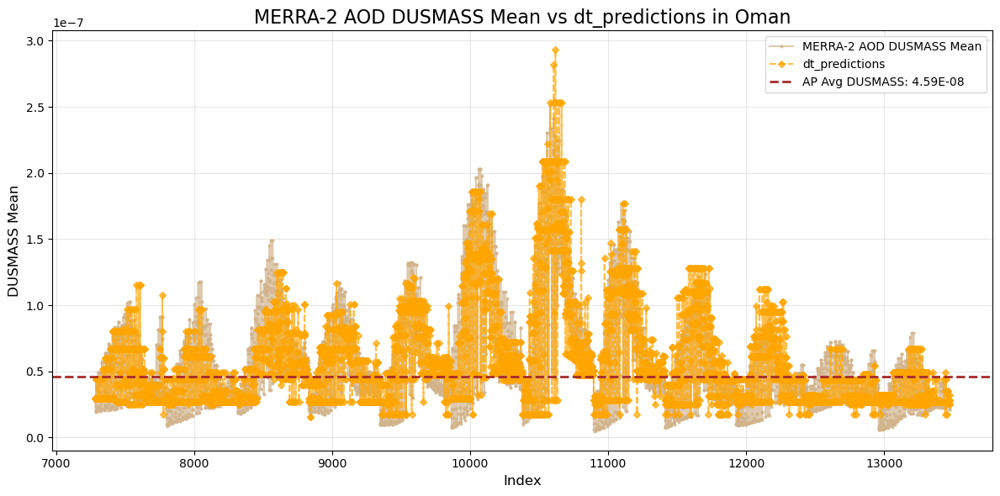

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Oman_rf_predictions_predictions.png


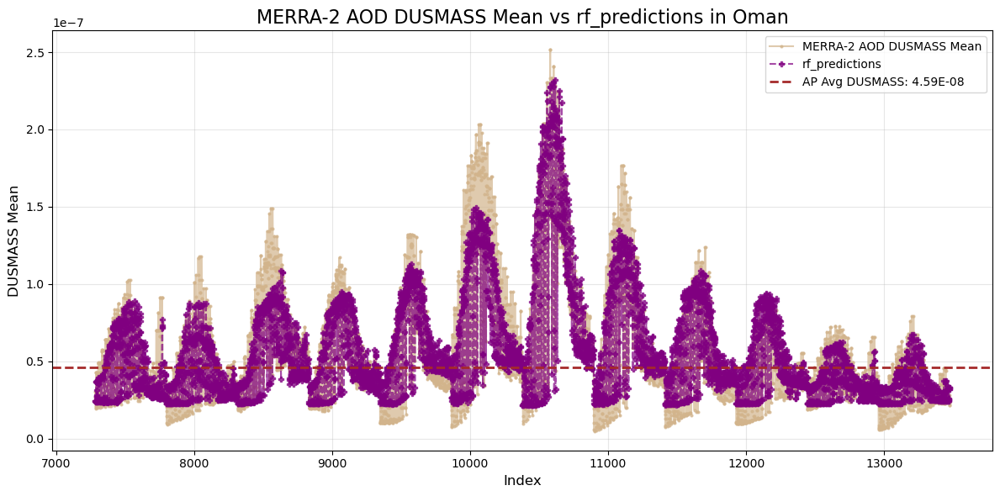

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Qatar_ensemble_predictions_predictions.png


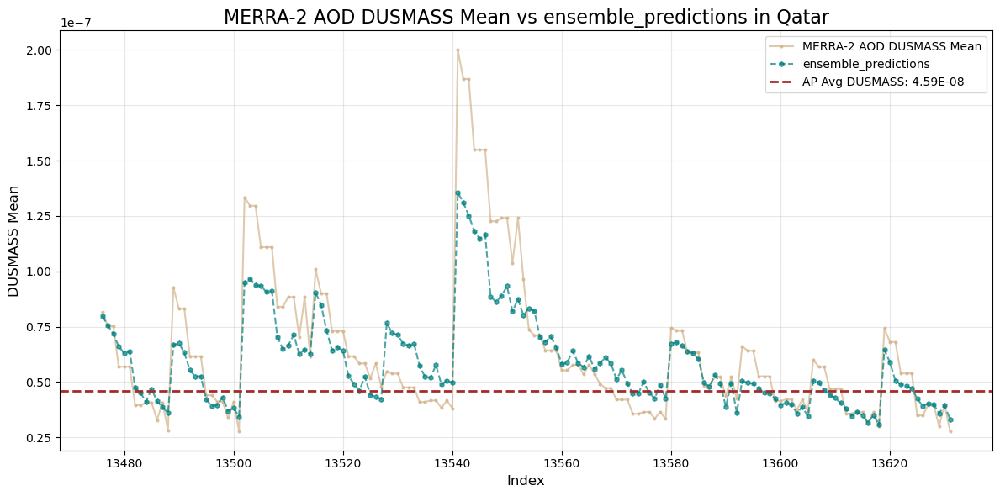

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Qatar_lr_predictions_predictions.png


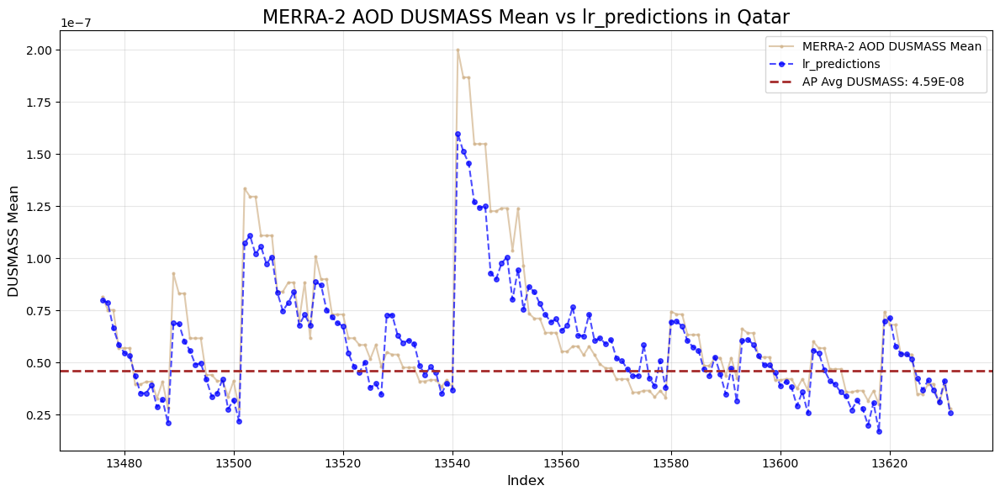

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Qatar_svr_predictions_predictions.png


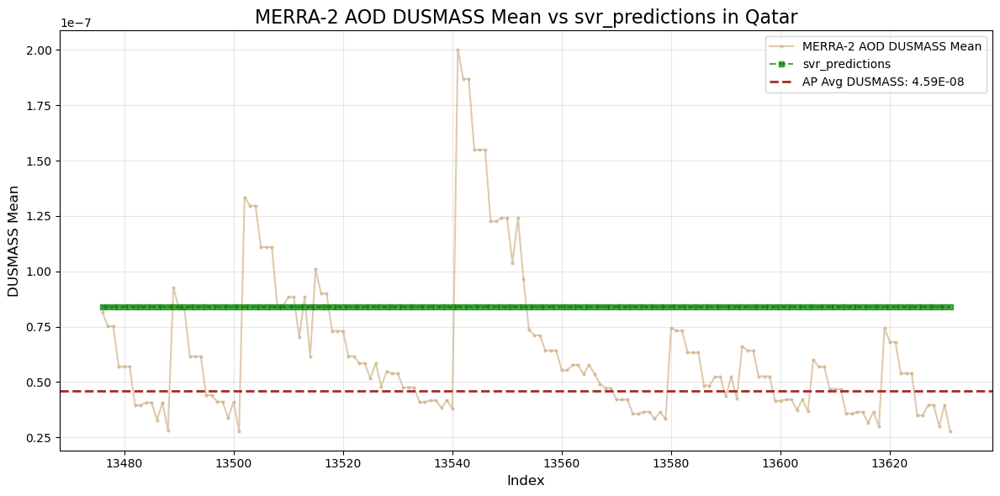

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Qatar_knn_predictions_predictions.png


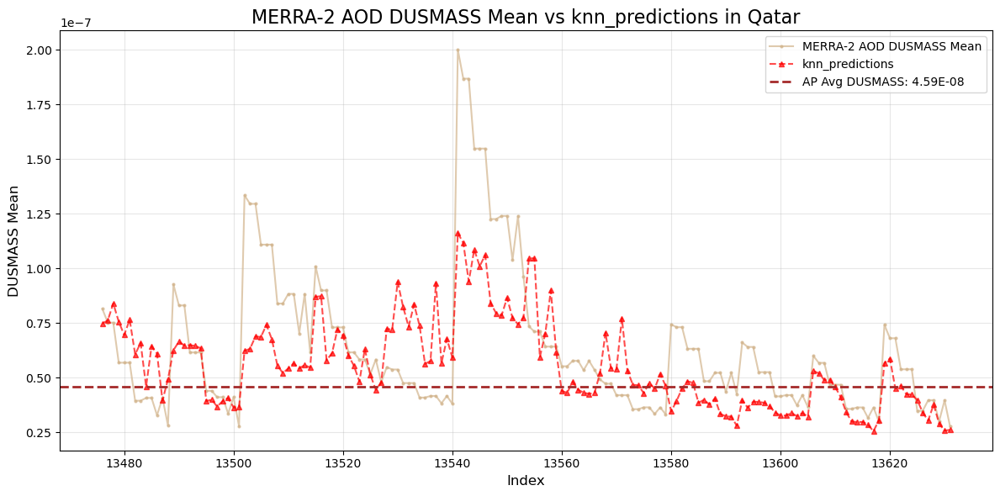

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Qatar_dt_predictions_predictions.png


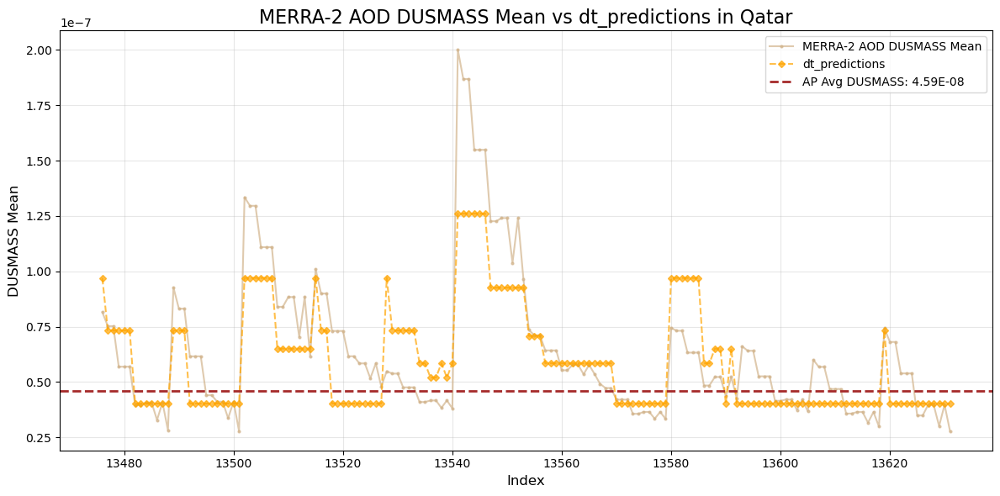

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Qatar_rf_predictions_predictions.png


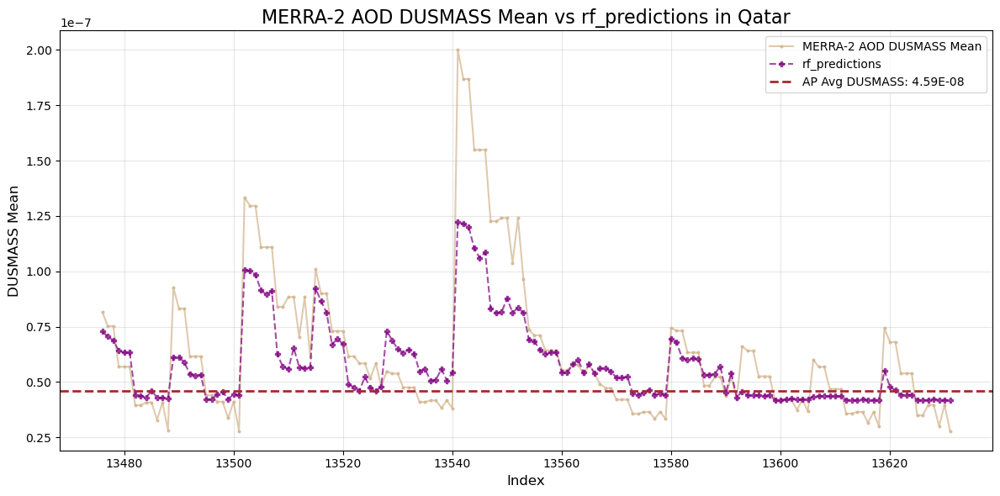

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Saudi_Arabia_ensemble_predictions_predictions.png


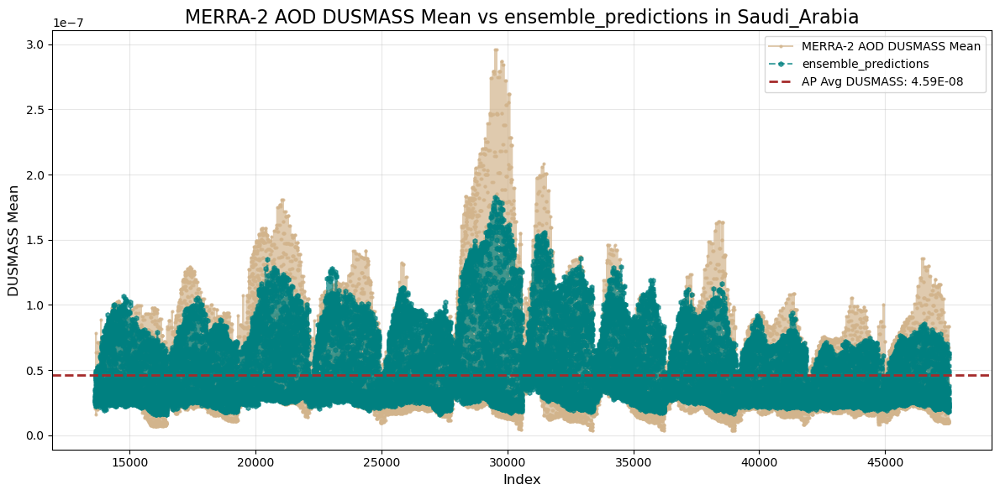

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Saudi_Arabia_lr_predictions_predictions.png


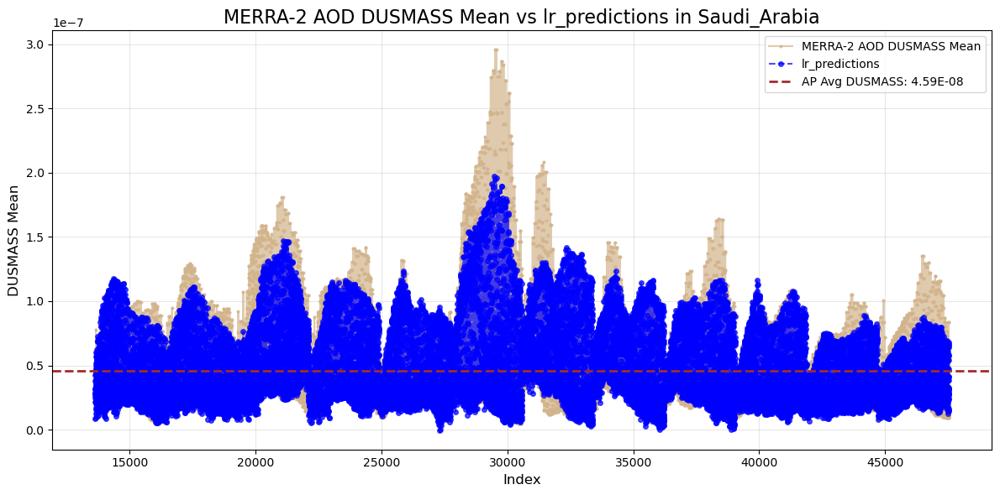

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Saudi_Arabia_svr_predictions_predictions.png


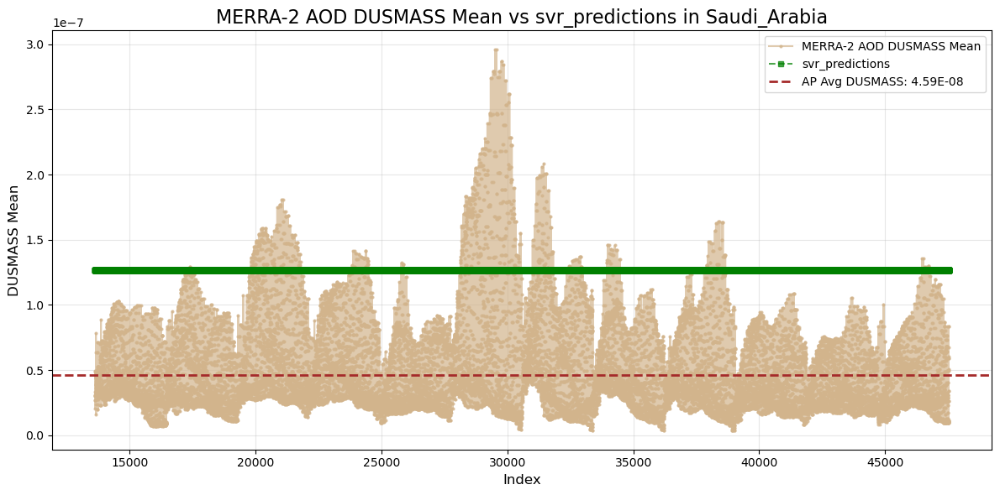

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Saudi_Arabia_knn_predictions_predictions.png


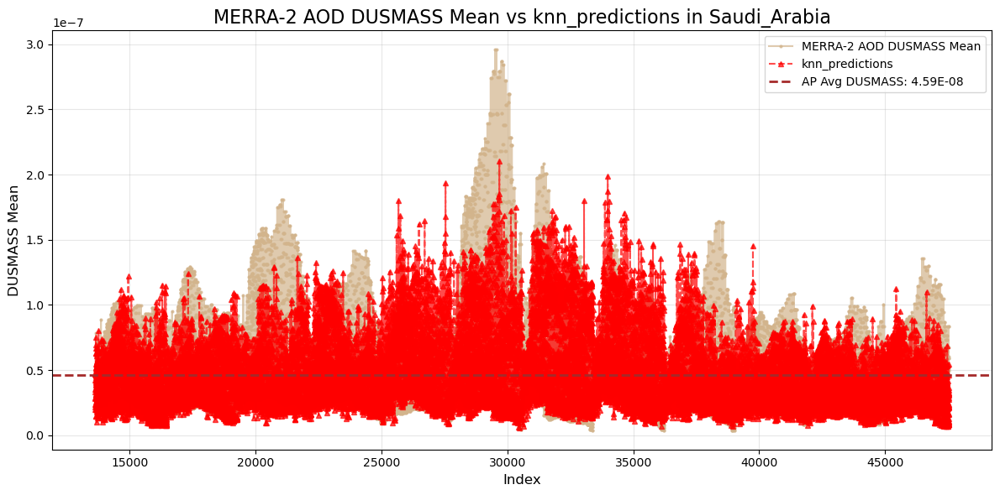

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Saudi_Arabia_dt_predictions_predictions.png


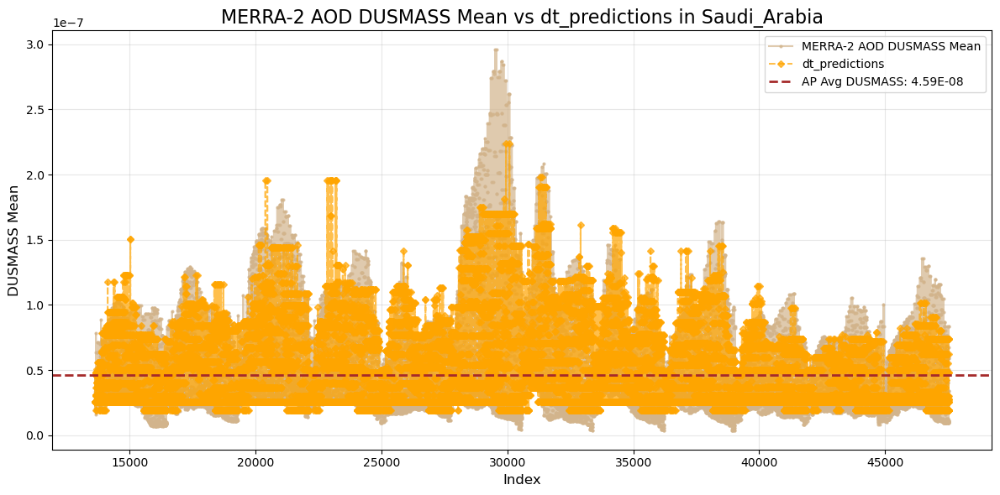

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\Saudi_Arabia_rf_predictions_predictions.png


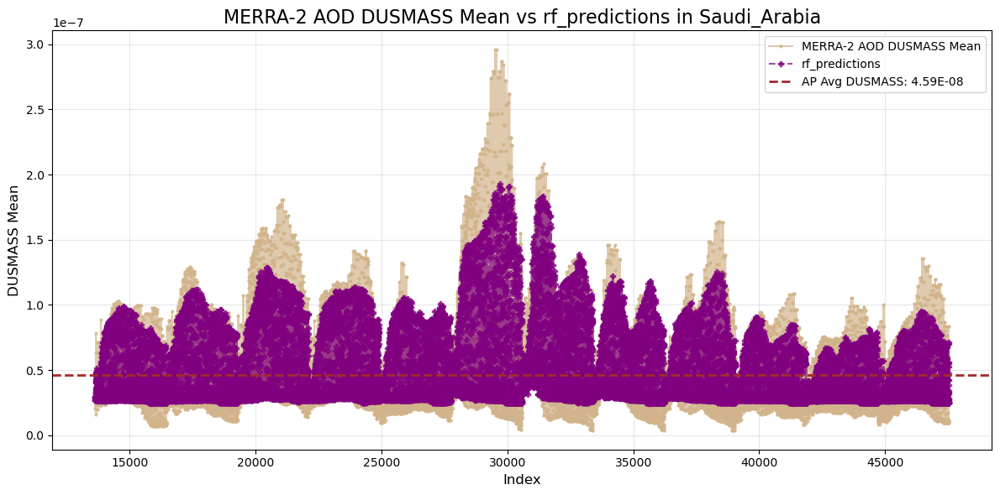

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\United_Arab_Emirates_ensemble_predictions_predictions.png


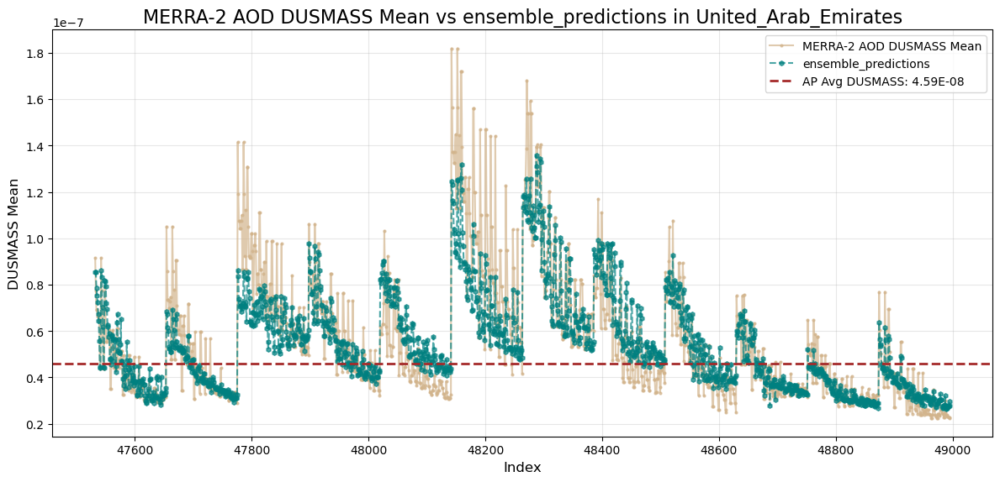

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\United_Arab_Emirates_lr_predictions_predictions.png


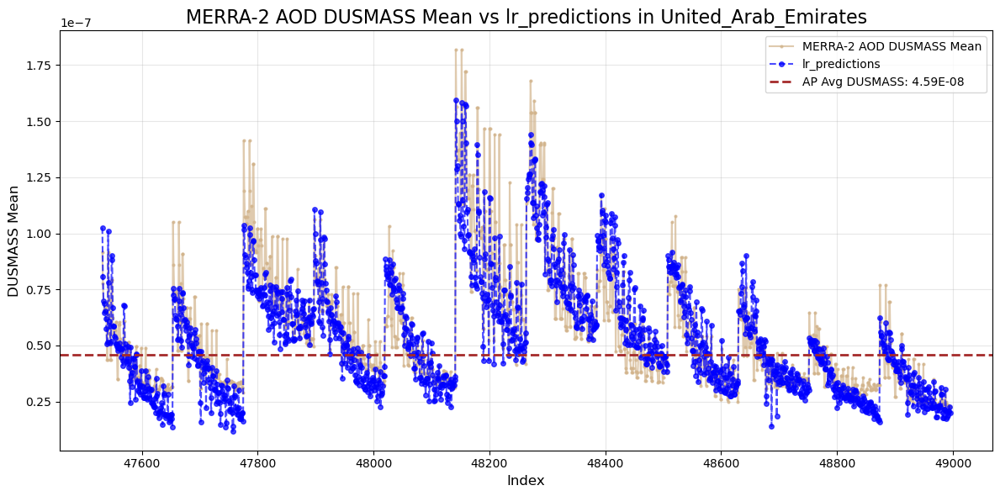

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\United_Arab_Emirates_svr_predictions_predictions.png


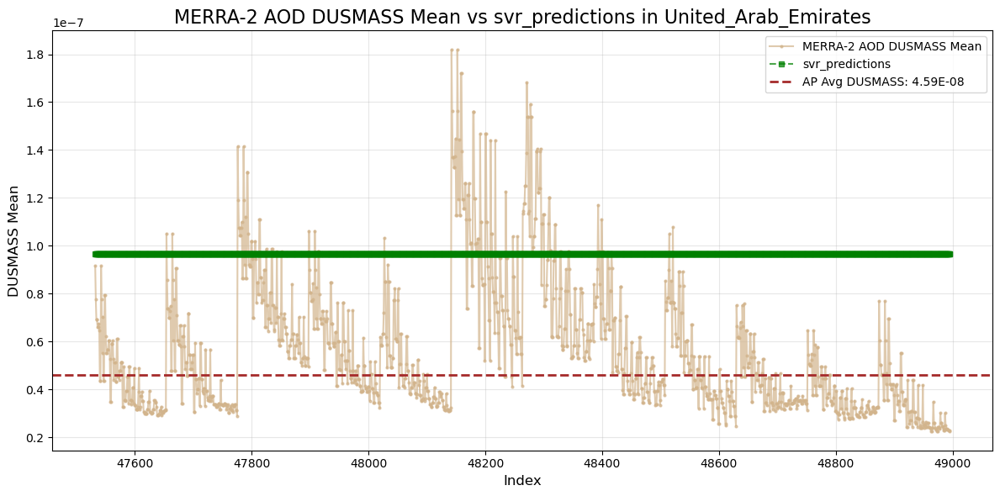

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\United_Arab_Emirates_knn_predictions_predictions.png


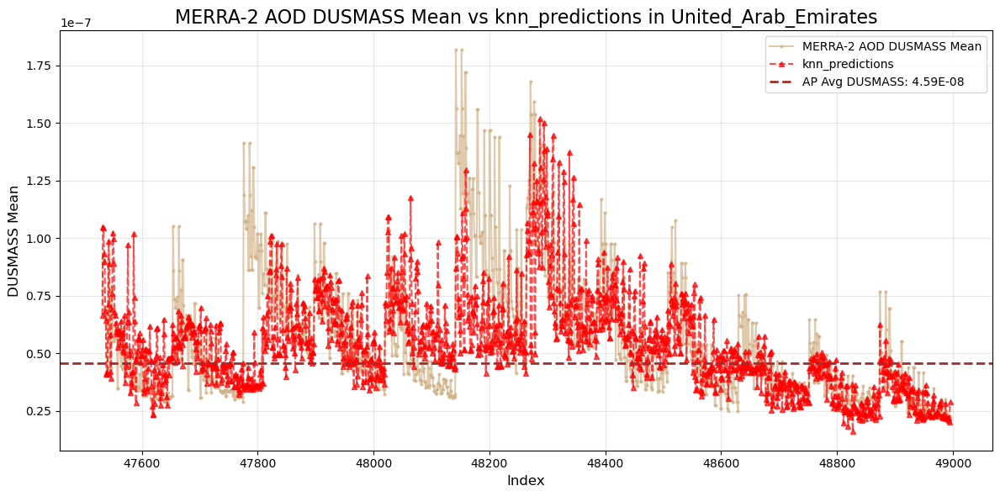

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\United_Arab_Emirates_dt_predictions_predictions.png


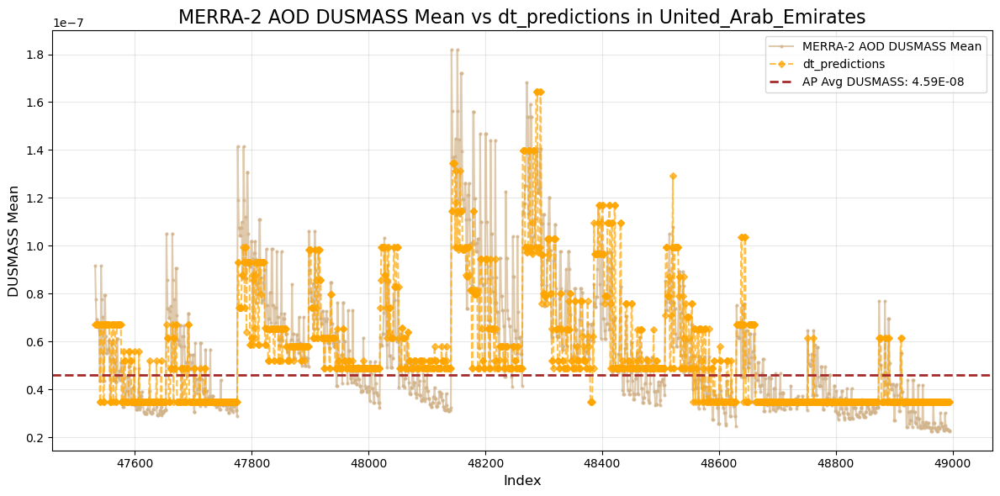

Saved country-model prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots\United_Arab_Emirates_rf_predictions_predictions.png


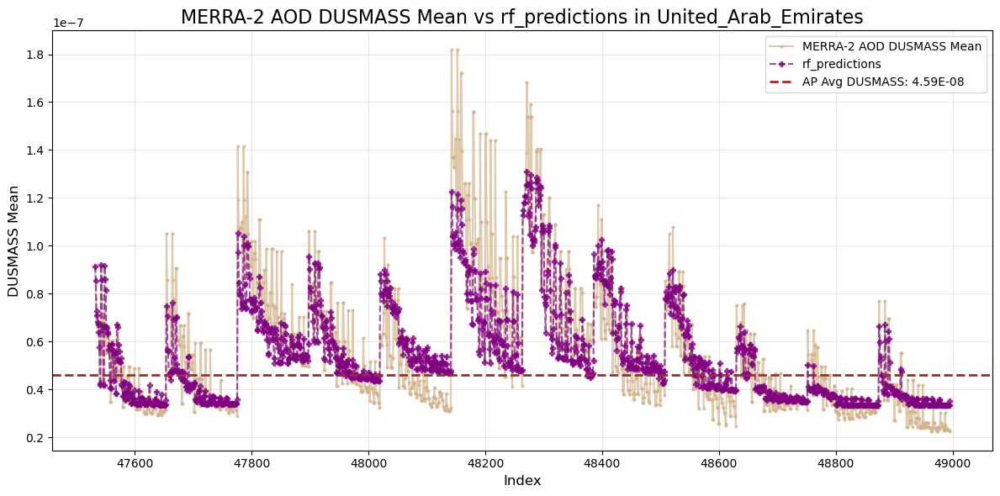

In [11]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Define the file path for the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\sfc_row_level_predictions_2021_v0051.csv"

# Define output directory for country-model prediction plots
output_dir = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\country_model_prediction_plots"
os.makedirs(output_dir, exist_ok=True)  # Ensure directory exists

# Define model styles
model_styles = {
    'ensemble_predictions': ('teal', 'h'),  # DustCast (DC)
    'lr_predictions': ('blue', 'o'),  # Linear Regression
    'svr_predictions': ('green', 's'),  # Support Vector Regression
    'knn_predictions': ('red', '^'),  # K-Nearest Neighbors
    'dt_predictions': ('orange', 'D'),  # Decision Tree
    'rf_predictions': ('purple', 'P')  # Random Forest
}

# Define the AP average DUSMASS concentration
average_dusmass = 4.59E-08

# Load the dataset
try:
    dataset = pd.read_csv(file_path)
    
    # Ensure the dataset contains the required columns
    required_columns = {'Country', 'DUSMASS_mean'}
    missing_columns = required_columns - set(dataset.columns)
    if missing_columns:
        raise KeyError(f"The dataset is missing required columns: {missing_columns}")

    # Get unique countries
    countries = dataset['Country'].unique()
    models = model_styles.keys()
    
    # Loop through each country and model to create separate plots
    for country in countries:
        country_data = dataset[dataset['Country'] == country]
        dusmass_mean = country_data['DUSMASS_mean']
        
        for model in models:
            if model in country_data.columns:
                predictions = country_data[model]
                color, marker = model_styles[model]
                
                # Create the plot
                plt.figure(figsize=(12, 6))
                plt.plot(dusmass_mean, linestyle='-', marker='o', markersize=2, color='tan', alpha=0.7, label='MERRA-2 AOD DUSMASS Mean')
                plt.plot(predictions, linestyle='--', marker=marker, markersize=4, color=color, alpha=0.7, label=f'{model}')
                
                # Add horizontal line for AP Avg DUSMASS
                plt.axhline(y=average_dusmass, color='brown', linestyle='--', linewidth=2, label=f'AP Avg DUSMASS: {average_dusmass:.2E}')

                # Add title and labels
                plt.title(f'MERRA-2 AOD DUSMASS Mean vs {model} in {country}', fontsize=16)
                plt.xlabel('Index', fontsize=12)
                plt.ylabel('DUSMASS Mean', fontsize=12)
                
                # Add legend and grid
                plt.legend()
                plt.grid(alpha=0.3)
                plt.tight_layout()
                
                # Save the plot
                save_path = os.path.join(output_dir, f"{country}_{model}_predictions.png")
                plt.savefig(save_path, dpi=300, bbox_inches='tight')
                print(f"Saved country-model prediction plot: {save_path}")

                # Show the plot
                plt.show()

except FileNotFoundError:
    print("The file was not found. Please ensure the file path is correct.")
except KeyError as e:
    print(f"Column not found in the dataset: {e}")
except Exception as e:
    print(f"An error occurred: {e}")


Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\SA_ensemble_predictions_predictions.png


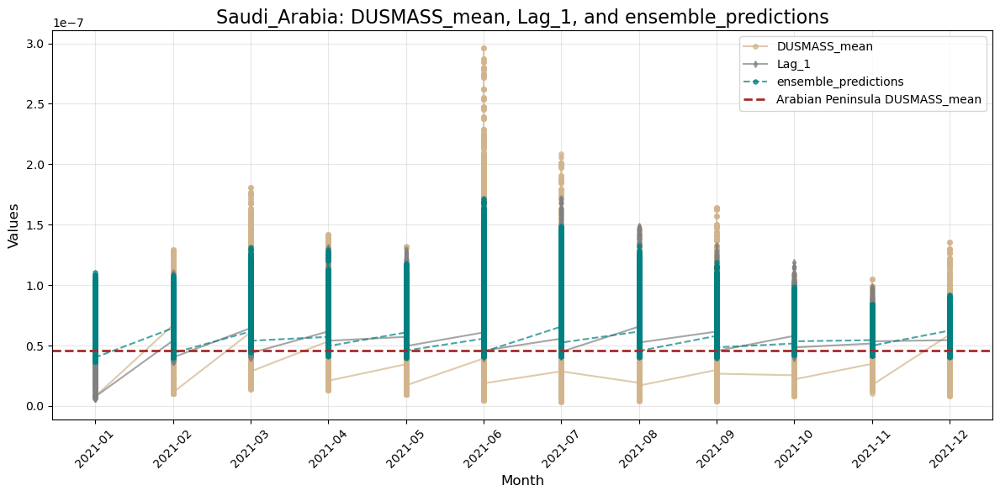

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\SA_lr_predictions_predictions.png


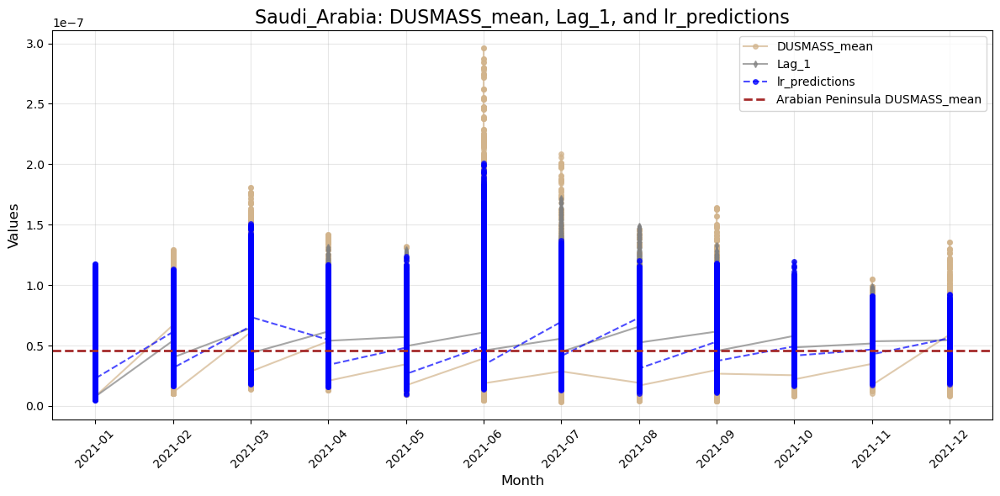

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\SA_svr_predictions_predictions.png


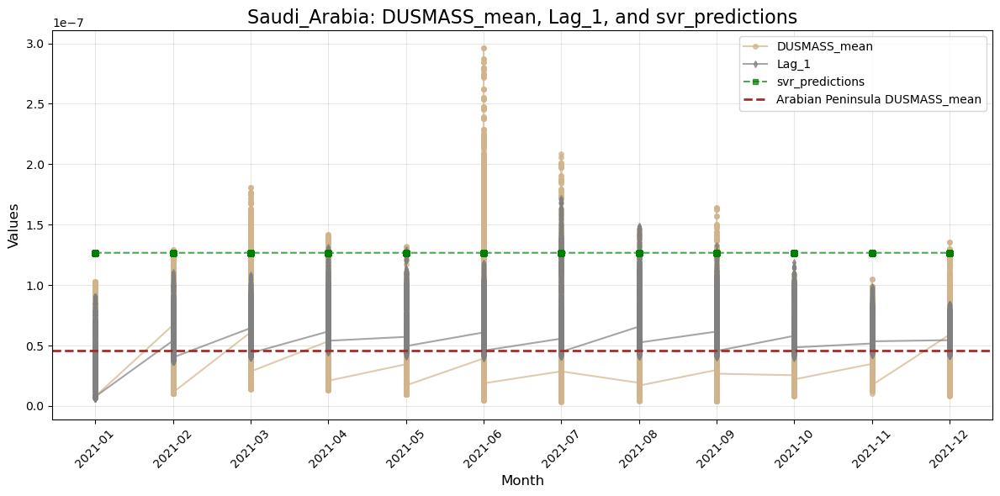

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\SA_knn_predictions_predictions.png


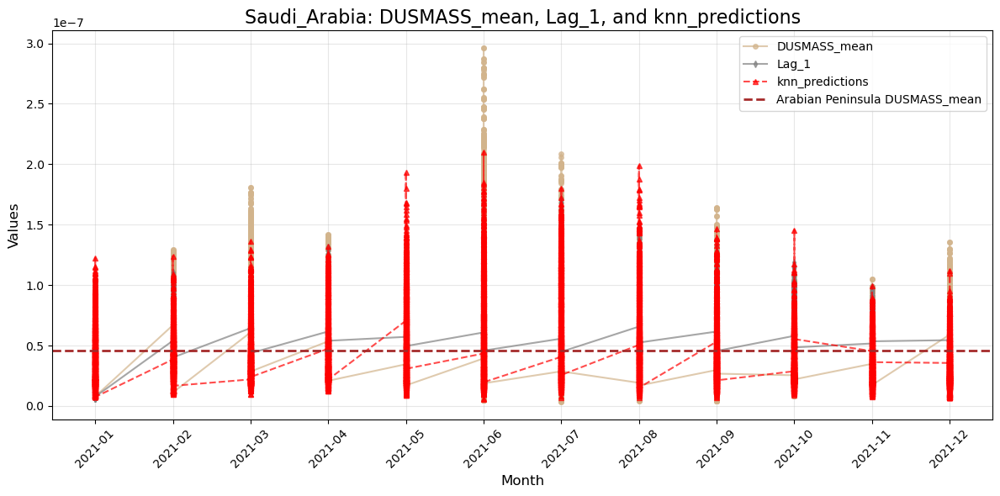

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\SA_dt_predictions_predictions.png


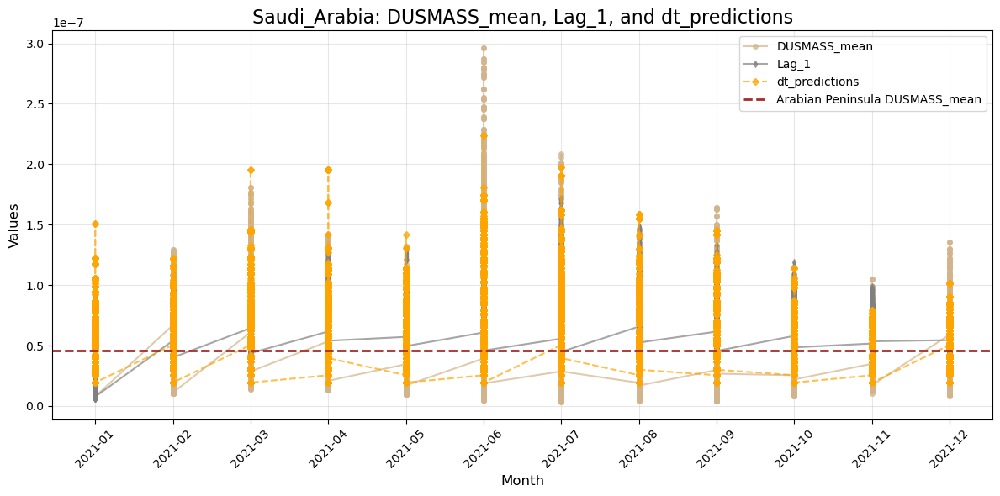

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\SA_rf_predictions_predictions.png


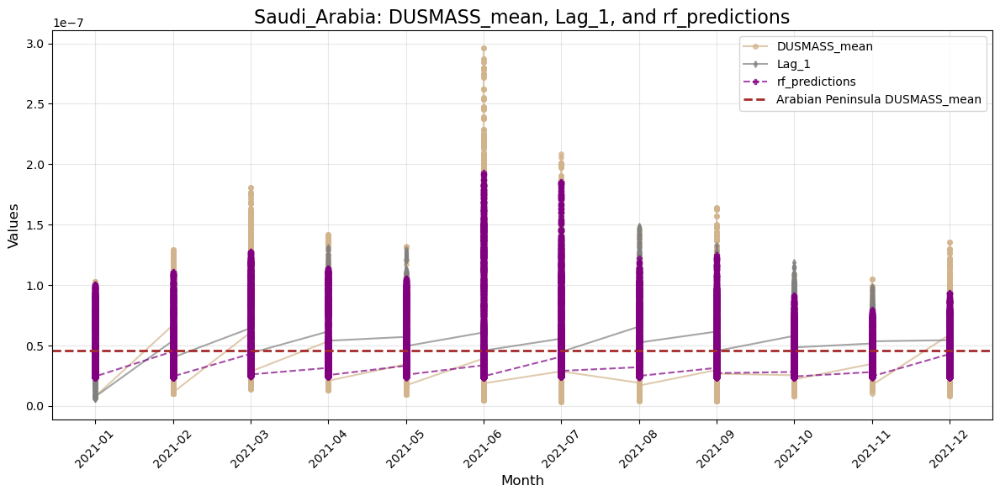

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\YE_ensemble_predictions_predictions.png


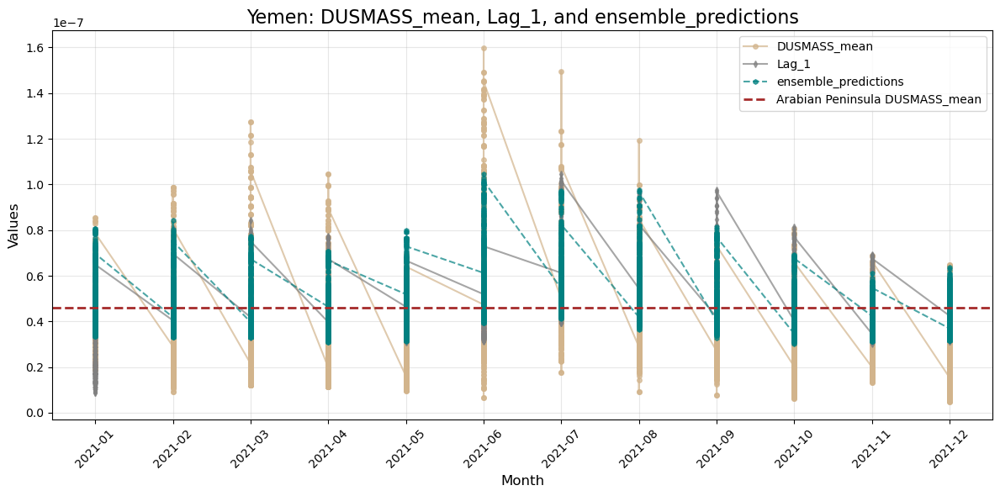

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\YE_lr_predictions_predictions.png


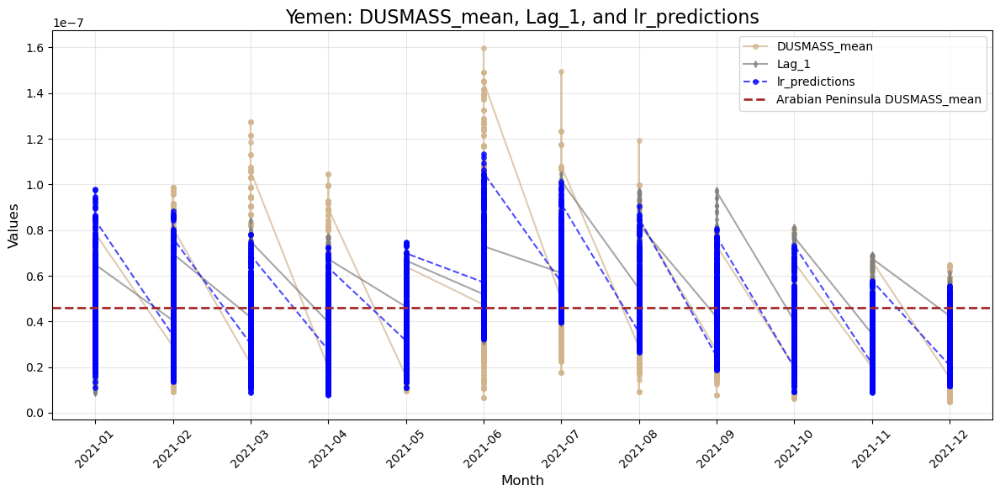

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\YE_svr_predictions_predictions.png


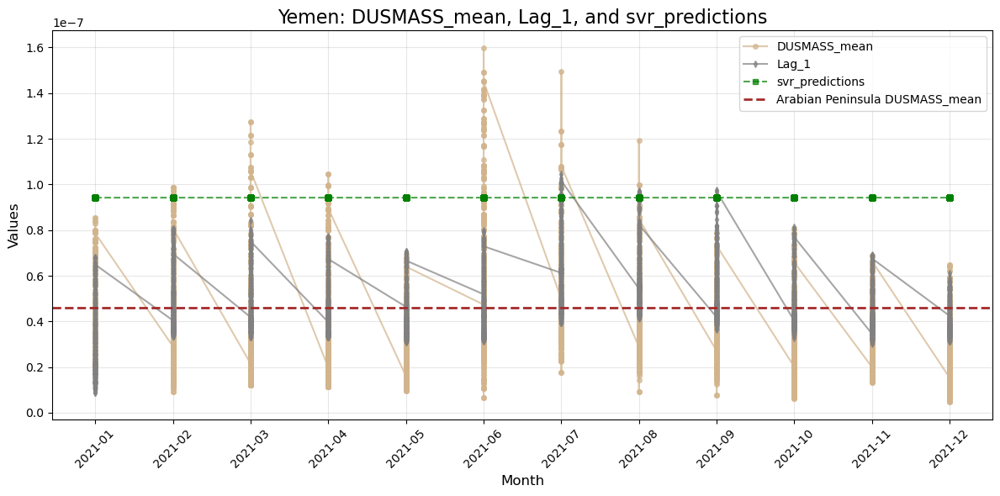

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\YE_knn_predictions_predictions.png


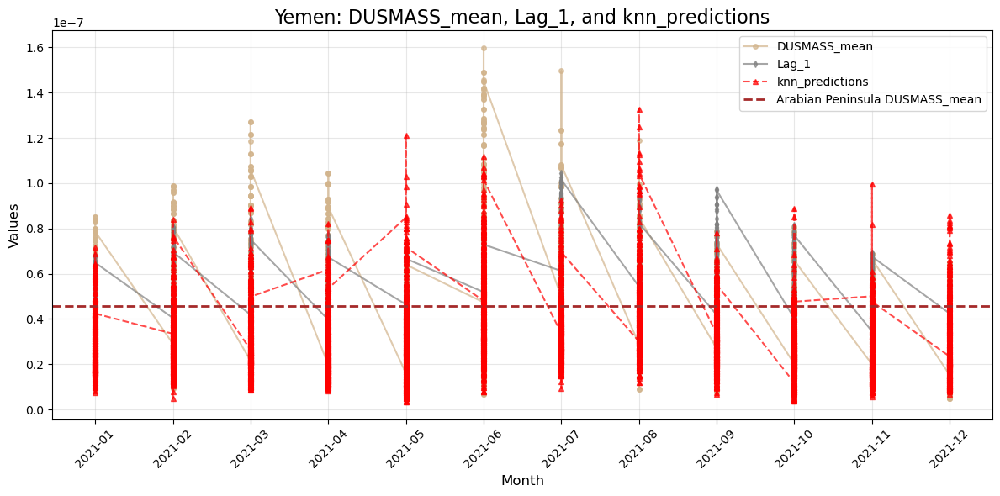

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\YE_dt_predictions_predictions.png


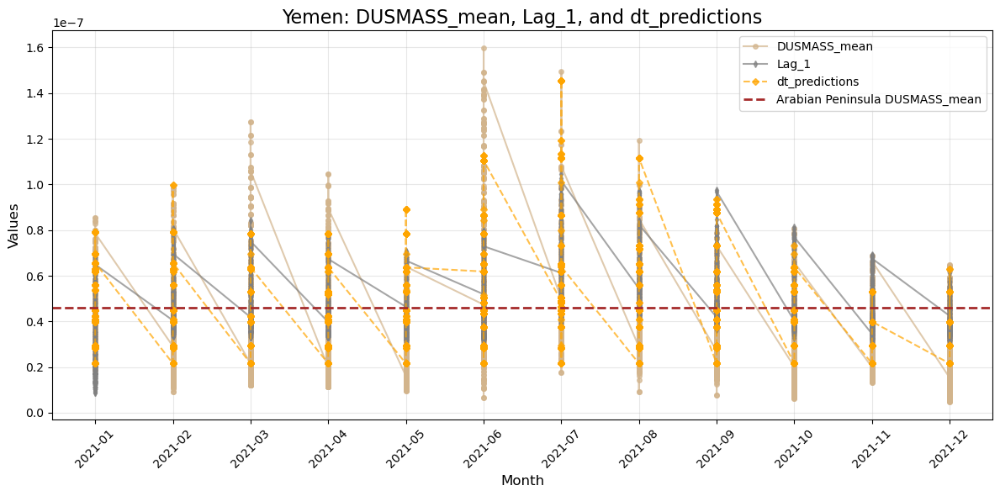

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\YE_rf_predictions_predictions.png


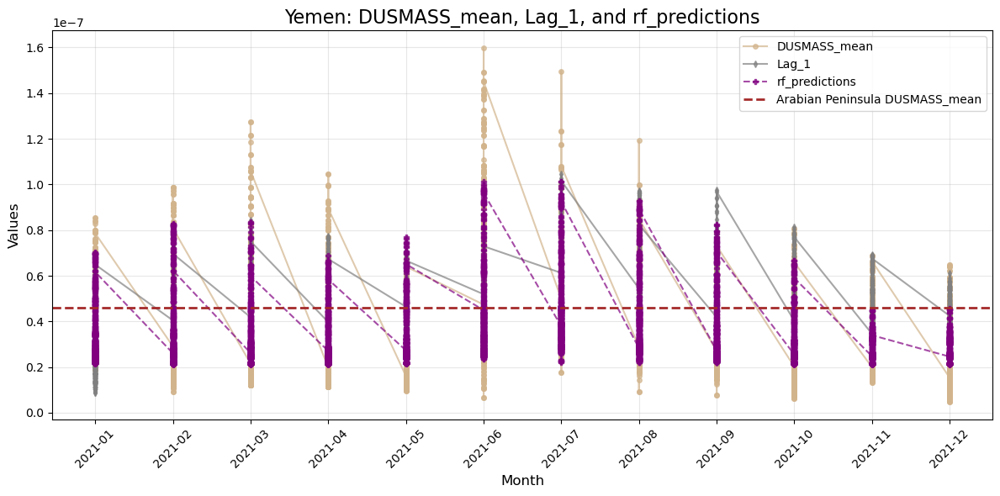

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\OM_ensemble_predictions_predictions.png


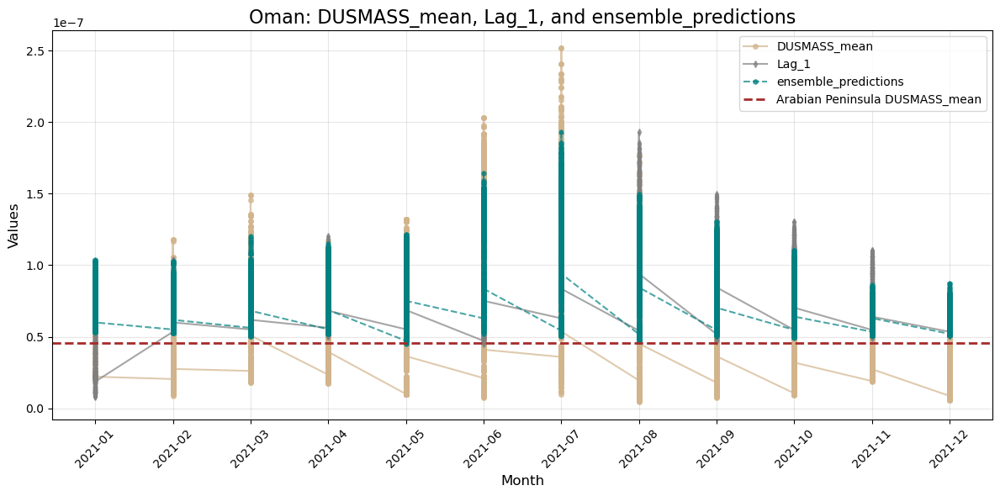

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\OM_lr_predictions_predictions.png


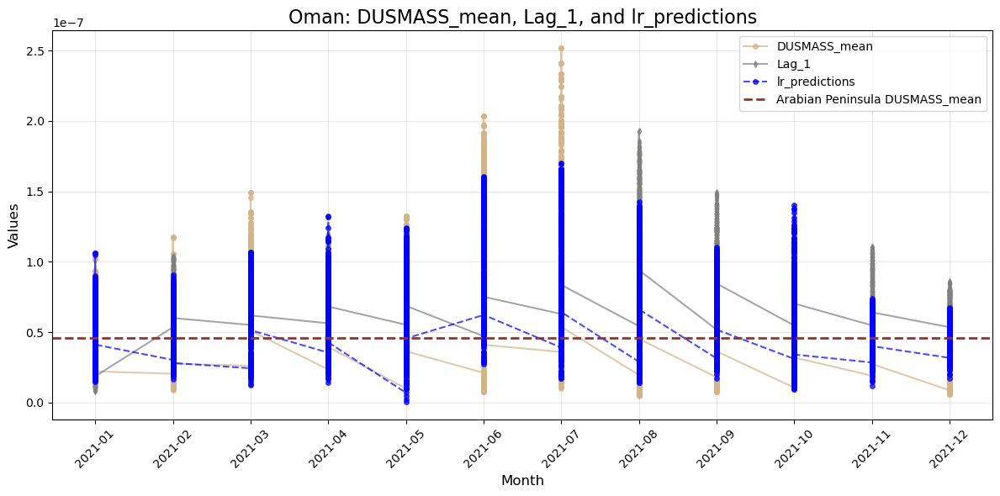

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\OM_svr_predictions_predictions.png


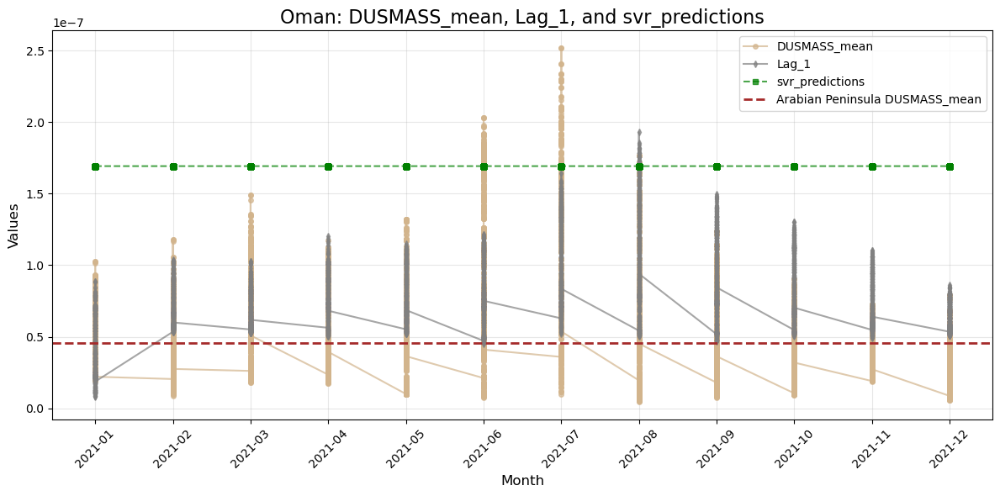

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\OM_knn_predictions_predictions.png


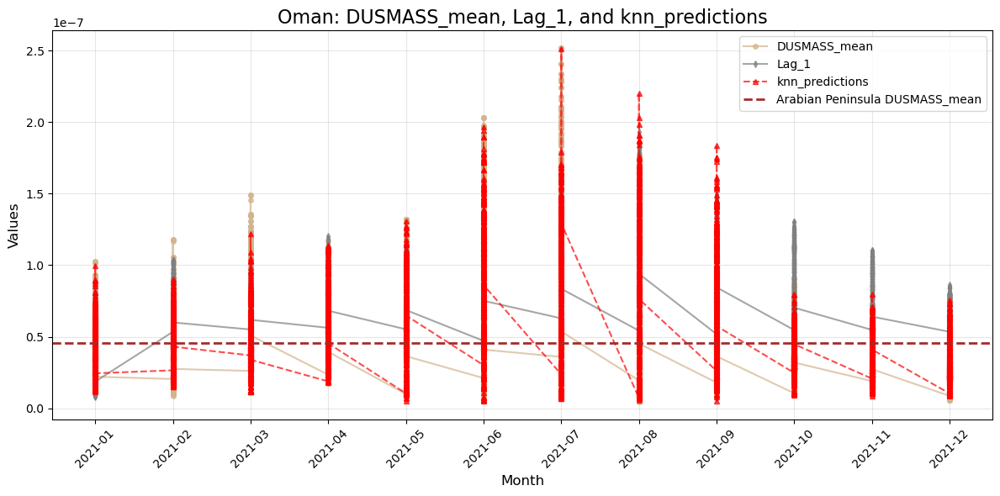

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\OM_dt_predictions_predictions.png


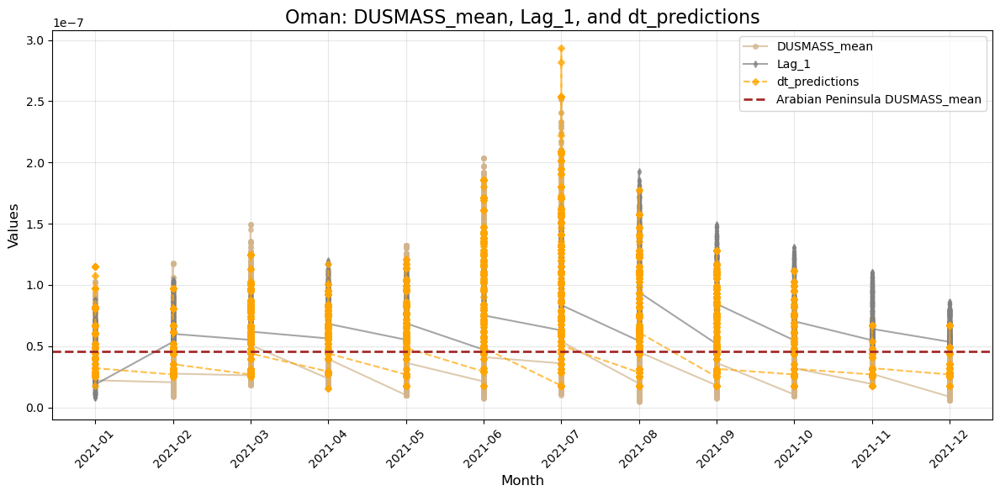

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\OM_rf_predictions_predictions.png


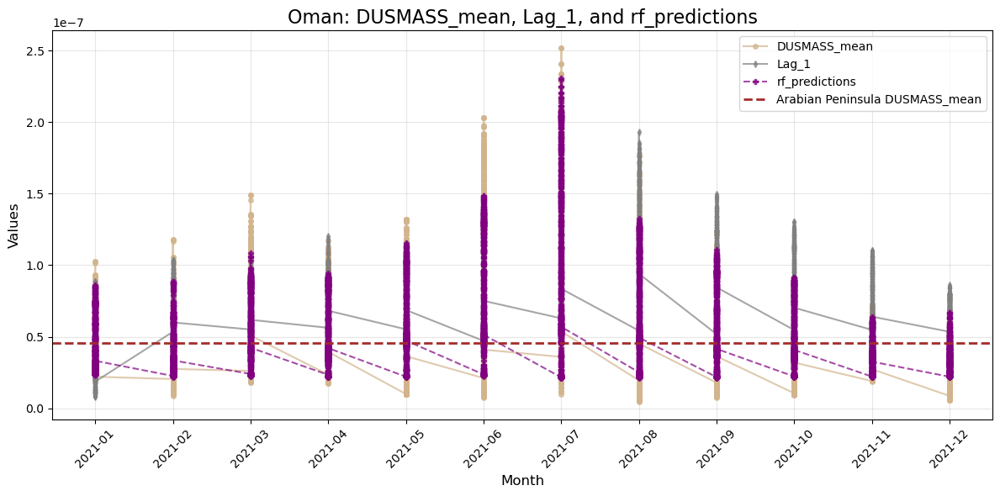

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\QA_ensemble_predictions_predictions.png


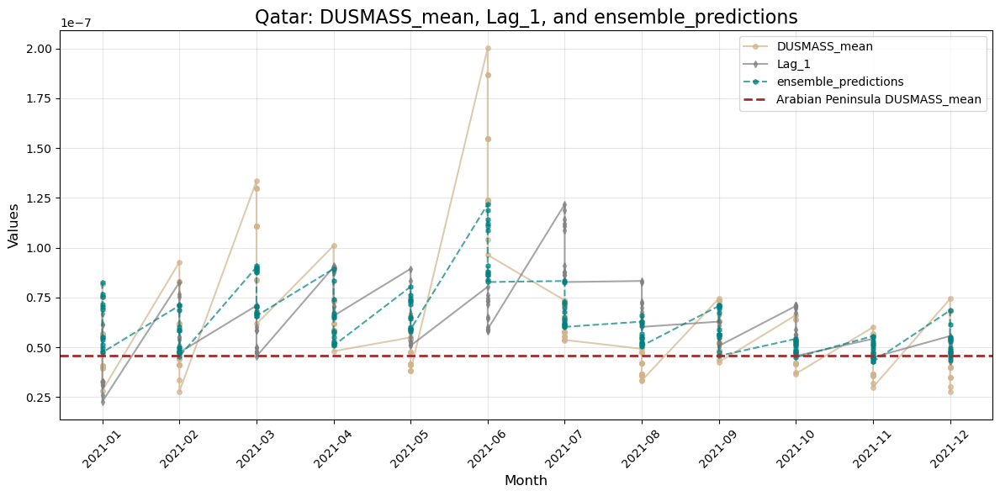

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\QA_lr_predictions_predictions.png


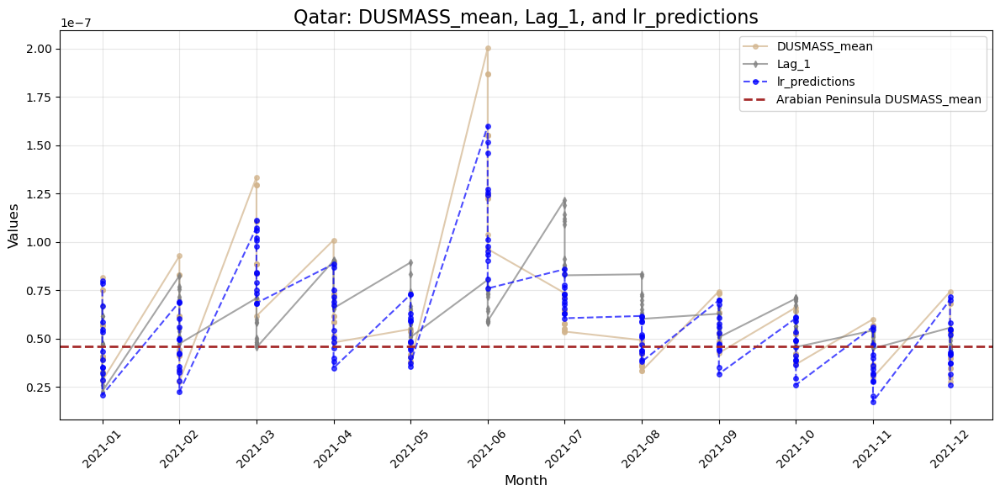

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\QA_svr_predictions_predictions.png


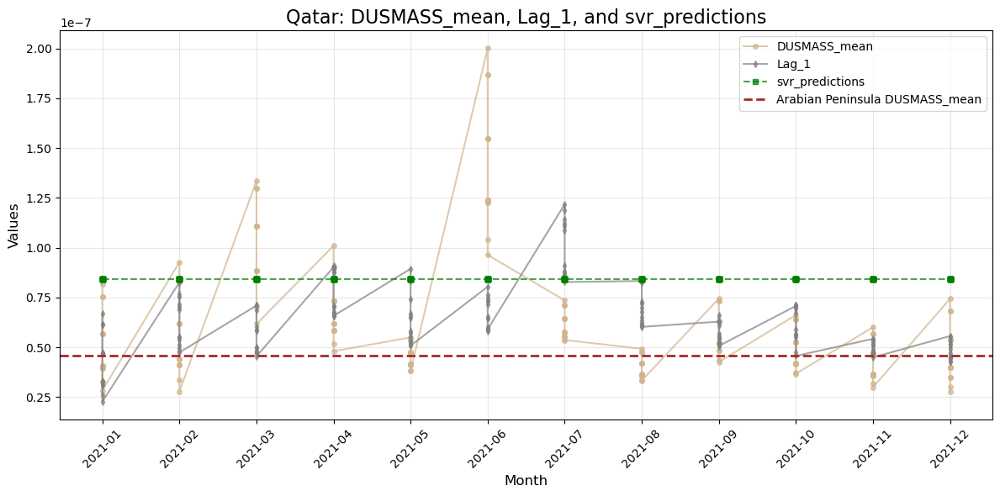

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\QA_knn_predictions_predictions.png


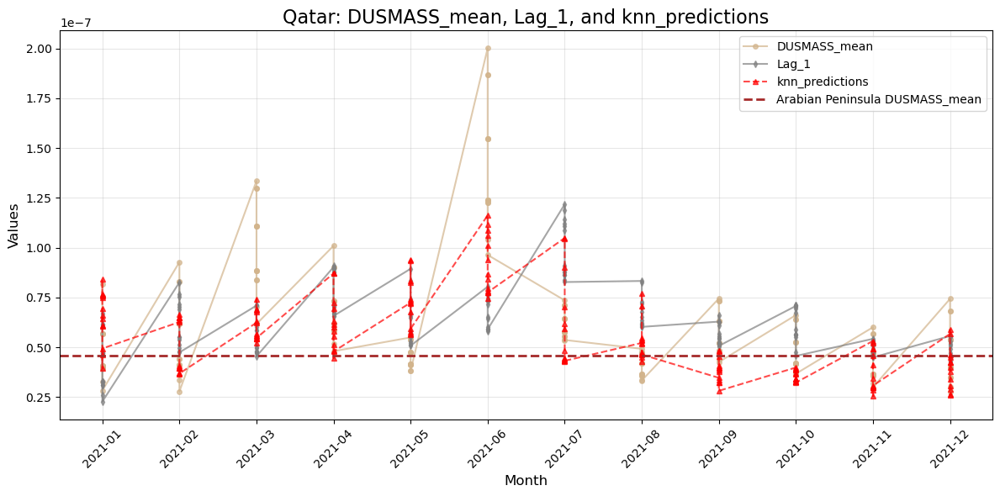

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\QA_dt_predictions_predictions.png


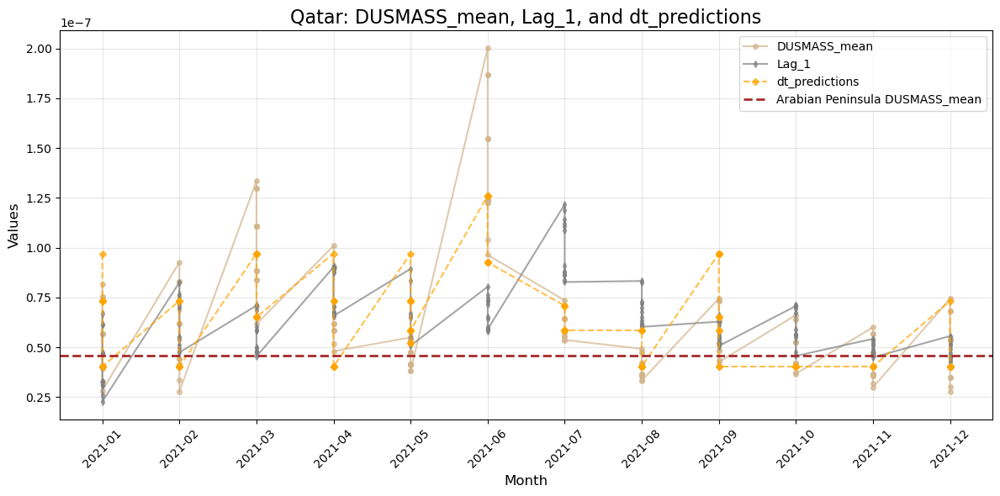

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\QA_rf_predictions_predictions.png


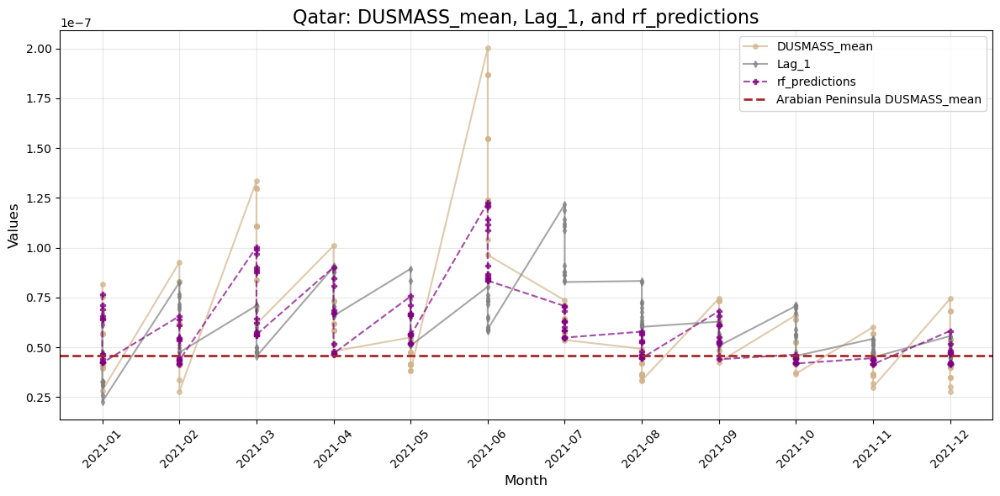

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\BH_ensemble_predictions_predictions.png


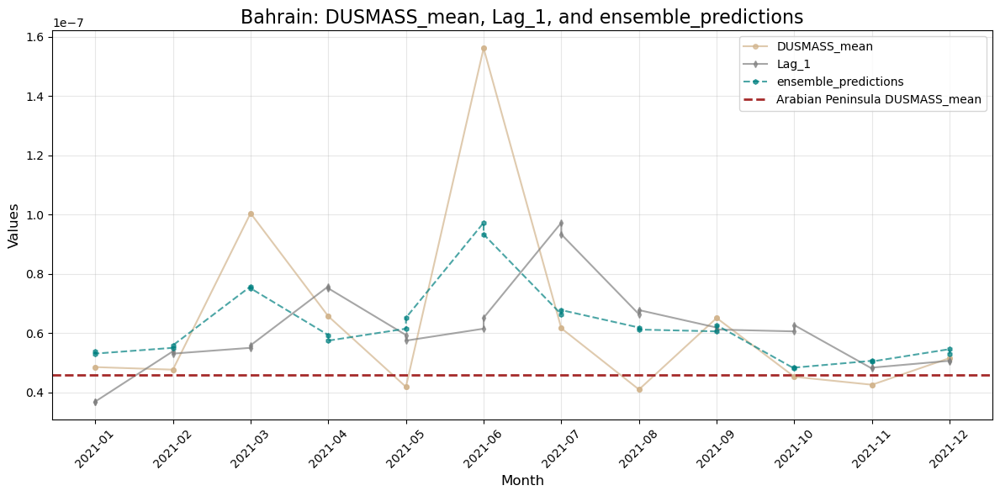

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\BH_lr_predictions_predictions.png


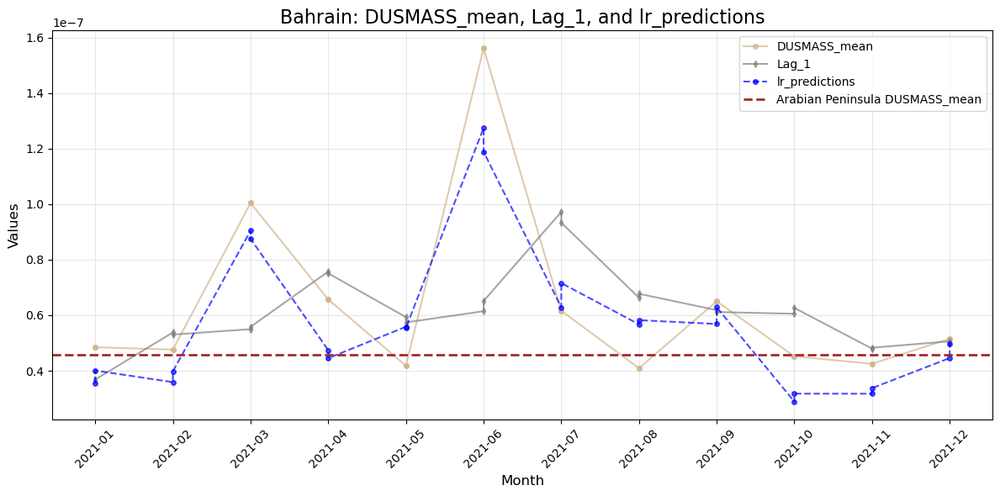

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\BH_svr_predictions_predictions.png


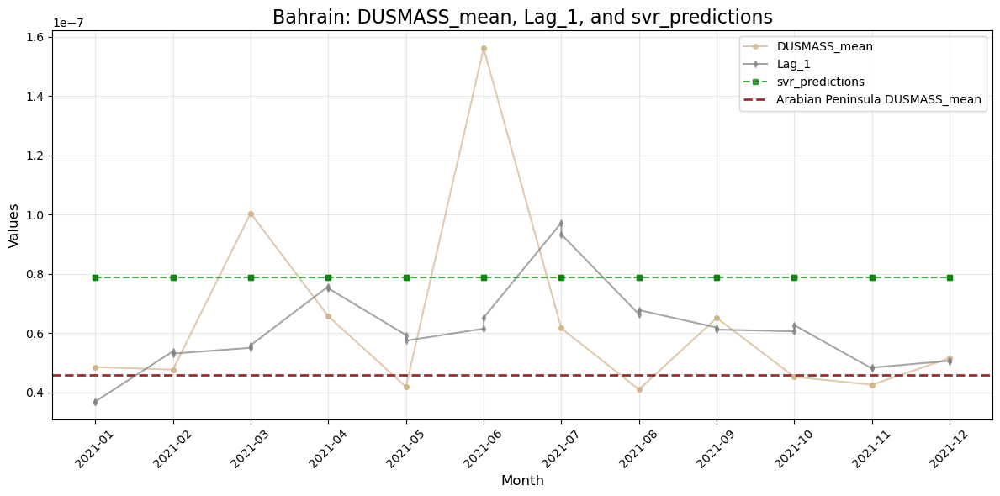

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\BH_knn_predictions_predictions.png


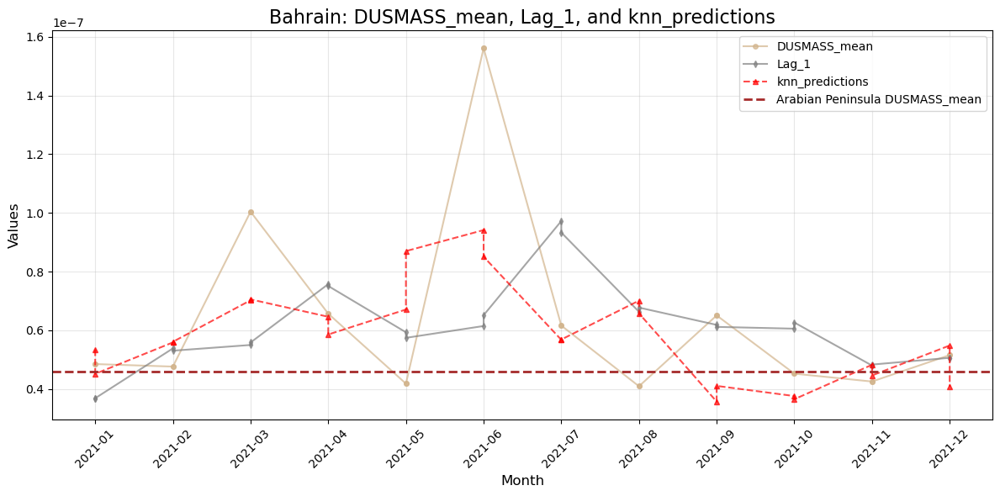

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\BH_dt_predictions_predictions.png


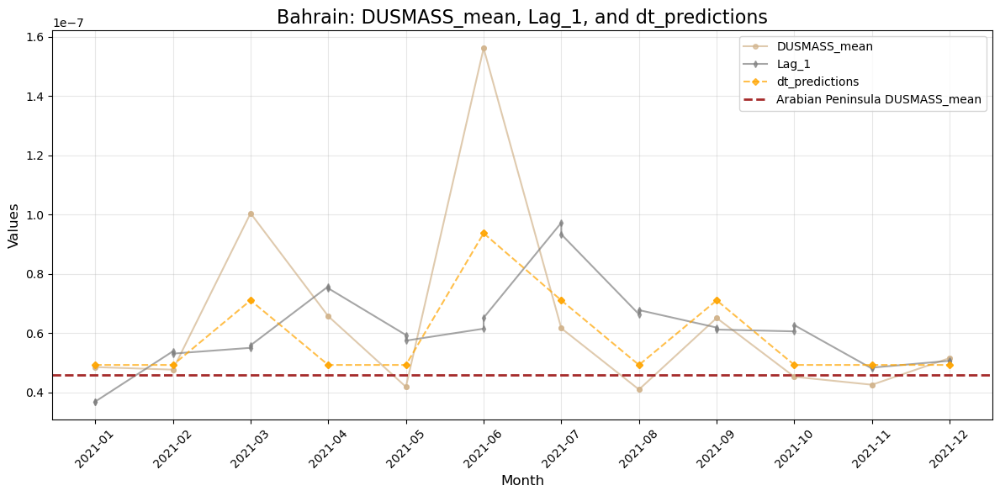

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\BH_rf_predictions_predictions.png


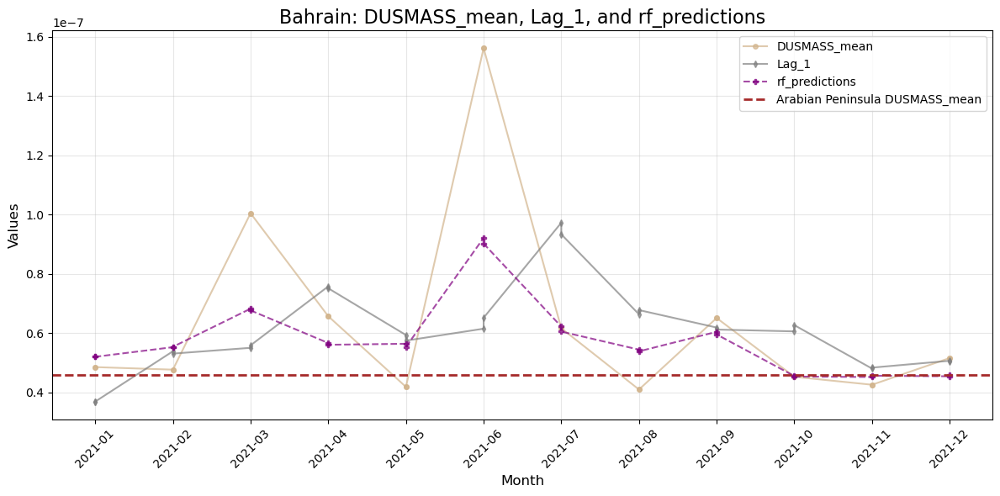

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\AE_ensemble_predictions_predictions.png


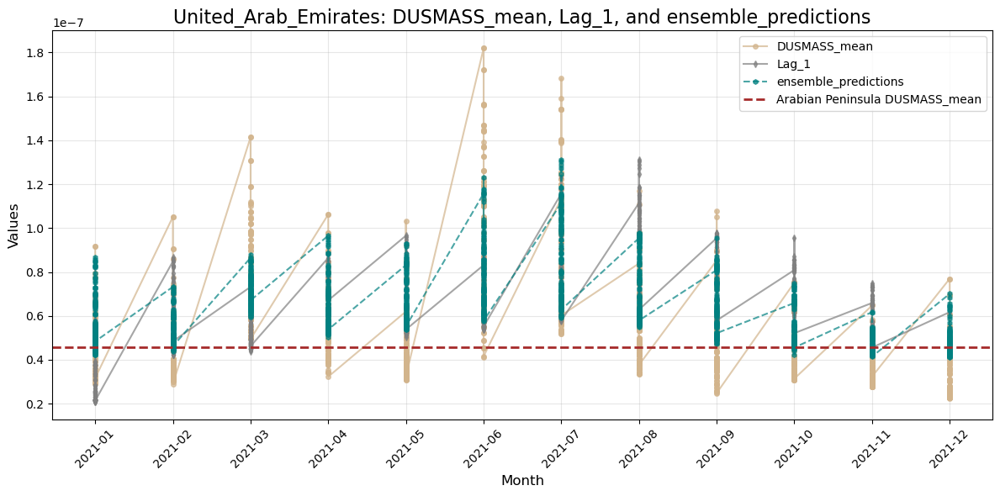

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\AE_lr_predictions_predictions.png


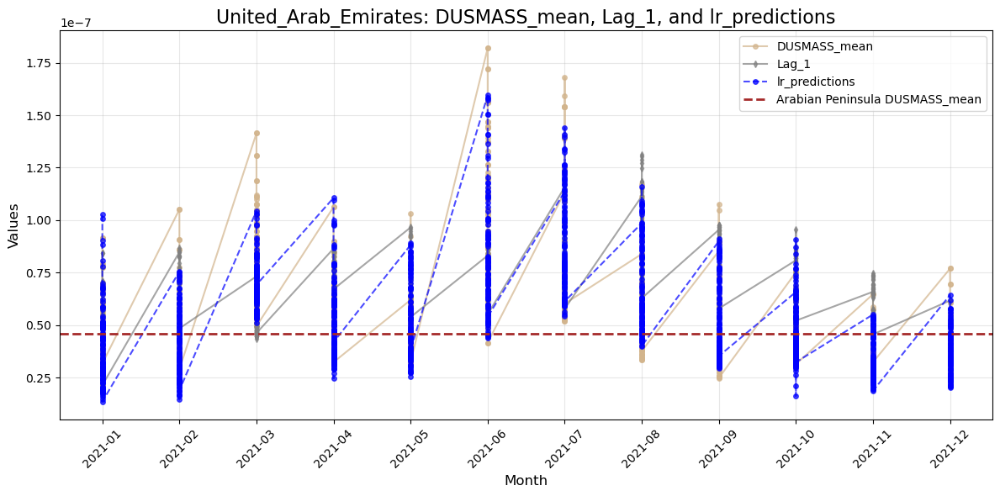

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\AE_svr_predictions_predictions.png


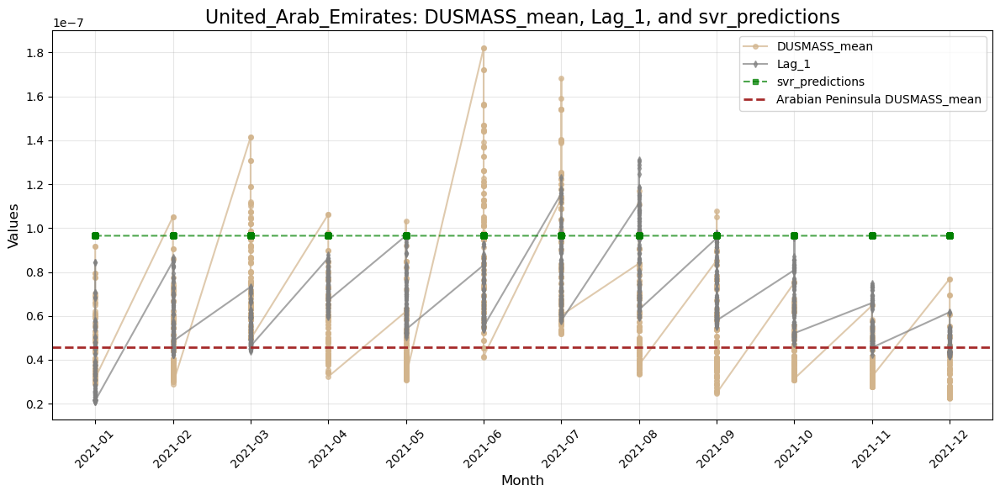

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\AE_knn_predictions_predictions.png


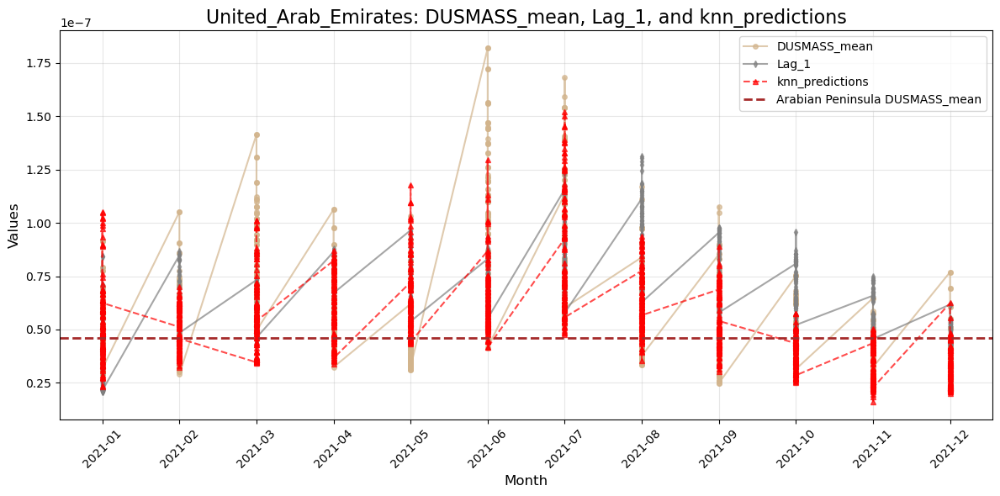

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\AE_dt_predictions_predictions.png


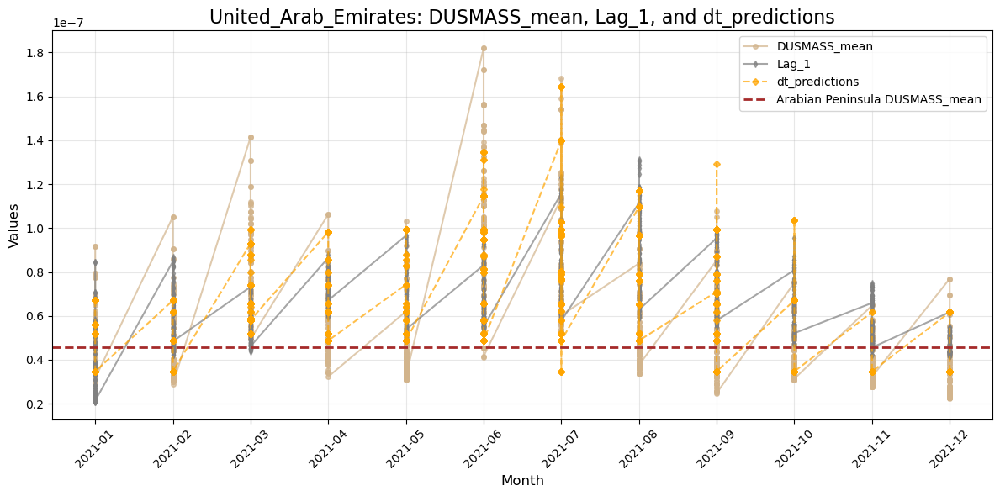

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\AE_rf_predictions_predictions.png


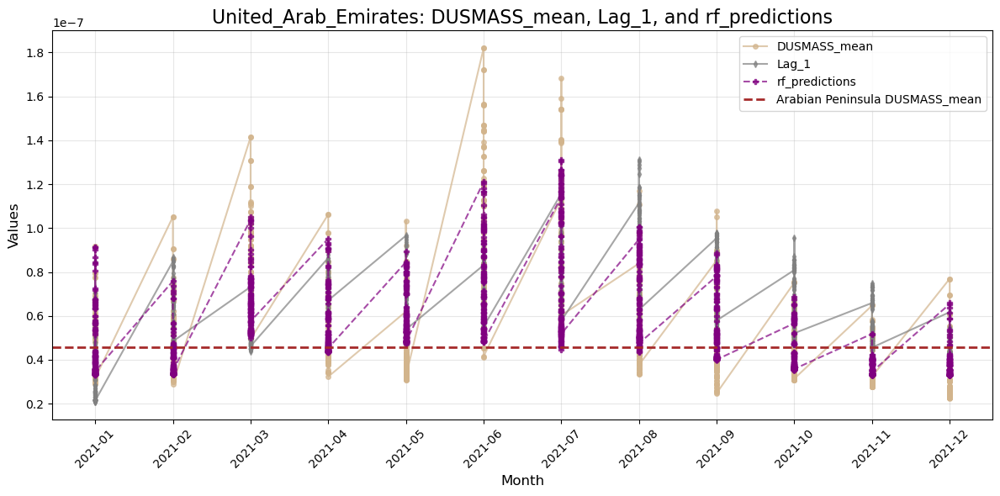

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\KW_ensemble_predictions_predictions.png


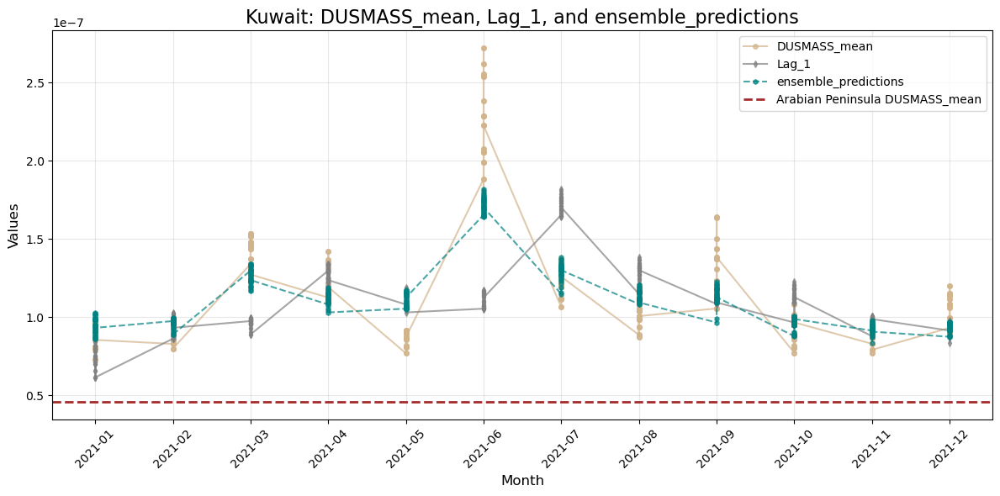

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\KW_lr_predictions_predictions.png


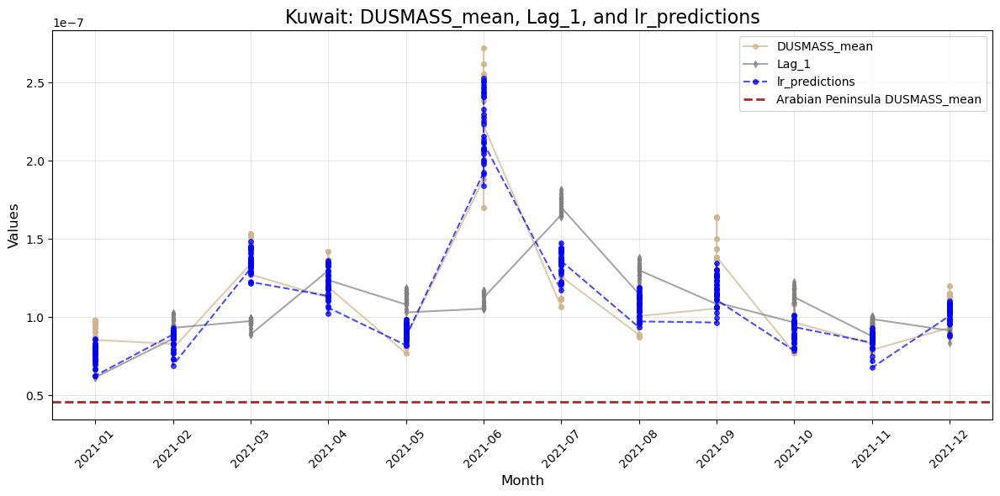

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\KW_svr_predictions_predictions.png


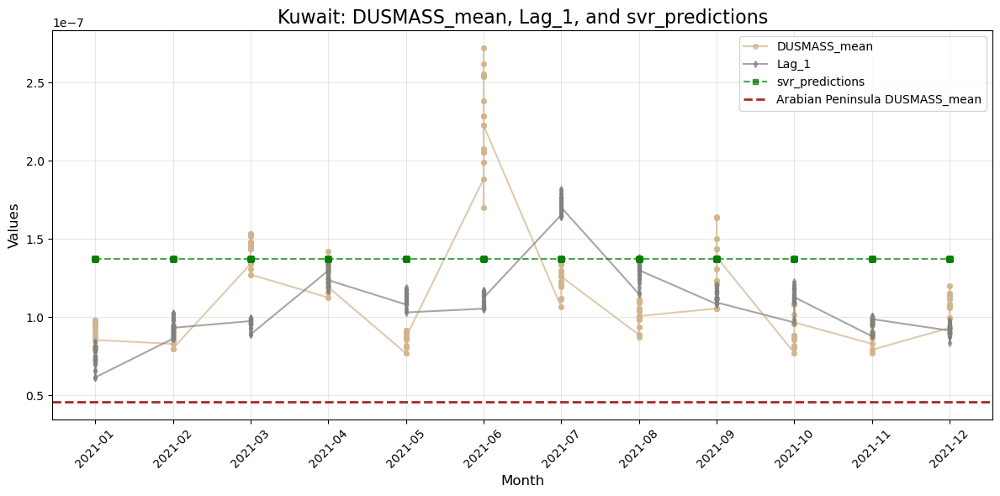

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\KW_knn_predictions_predictions.png


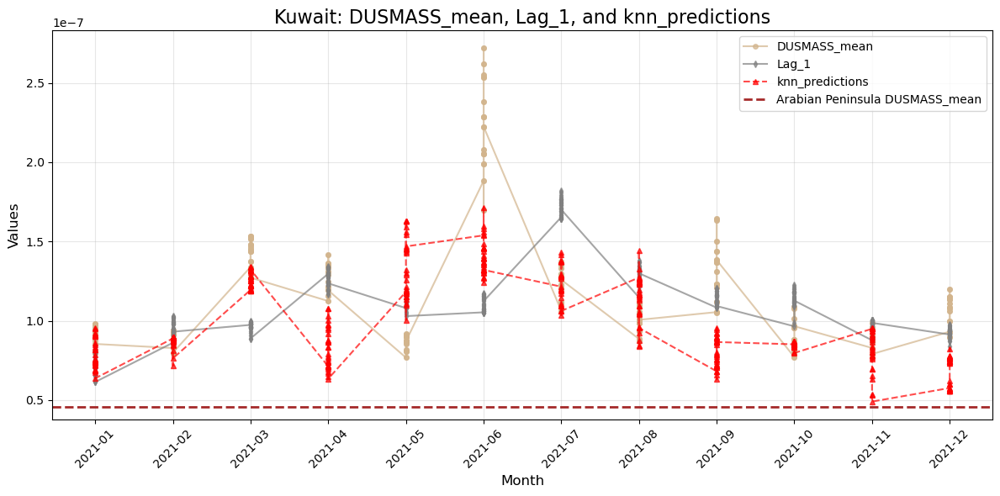

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\KW_dt_predictions_predictions.png


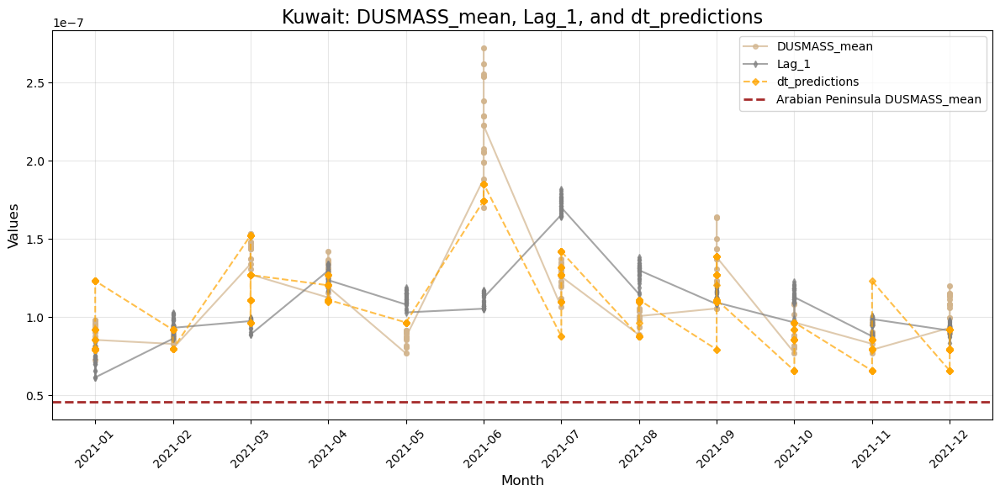

Saved country-monthly prediction plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots\KW_rf_predictions_predictions.png


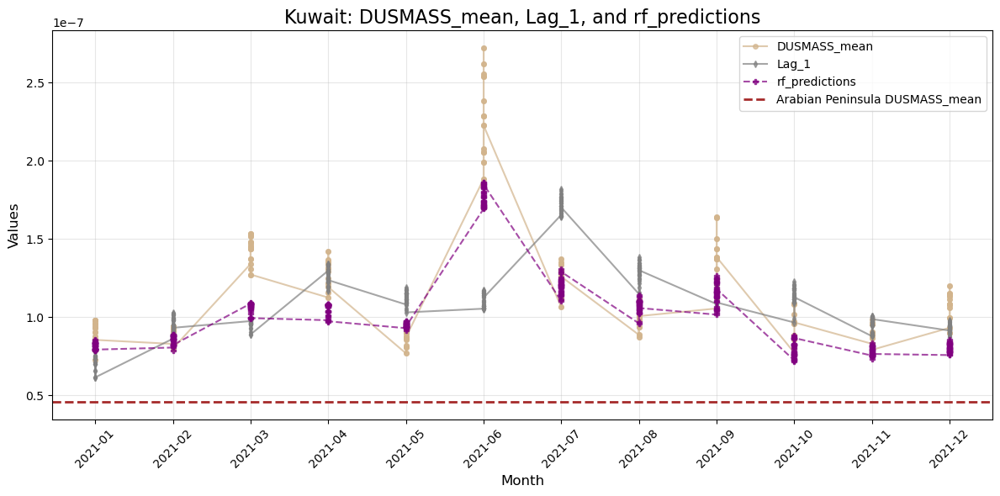

In [23]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Define the file path for the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\sfc_row_level_predictions_2021_v0051.csv"

# Define output directory for country-monthly prediction plots
output_dir = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\country_monthly_prediction_plots"
os.makedirs(output_dir, exist_ok=True)  # Ensure directory exists

# Define model styles
model_styles = {
    'ensemble_predictions': ('teal', 'h'),  # DustCast (DC)
    'lr_predictions': ('blue', 'o'),  # Linear Regression
    'svr_predictions': ('green', 's'),  # Support Vector Regression
    'knn_predictions': ('red', '^'),  # K-Nearest Neighbors
    'dt_predictions': ('orange', 'D'),  # Decision Tree
    'rf_predictions': ('purple', 'P')  # Random Forest
}

# Country mapping
countries = {
    "SA": "Saudi_Arabia",
    "YE": "Yemen",
    "OM": "Oman",
    "QA": "Qatar",
    "BH": "Bahrain",
    "AE": "United_Arab_Emirates",
    "KW": "Kuwait"
}

# Define the DUSMASS_mean for the entire Arabian Peninsula
arabian_peninsula_dusmass_mean = 4.59E-08

# Load the dataset
try:
    dataset = pd.read_csv(file_path)

    # Ensure that 'Country', 'Month', and 'lag_1' columns exist
    required_columns = {'Country', 'Month', 'lag_1'}
    missing_columns = required_columns - set(dataset.columns)
    if missing_columns:
        raise KeyError(f"The dataset is missing required columns: {missing_columns}")

    # Loop through each country
    for country_code, country_name in countries.items():
        # Filter the dataset for the current country
        country_data = dataset[dataset['Country'] == country_name]

        if country_data.empty:
            print(f"No data available for {country_name}. Skipping...")
            continue

        # Extract 'DUSMASS_mean', 'Month', and 'lag_1'
        dusmass_mean = country_data['DUSMASS_mean']
        lag_1 = country_data['lag_1']
        months = country_data['Month']

        # Loop through each model and create a plot
        for model, (color, marker) in model_styles.items():
            if model in country_data.columns:
                predictions = country_data[model]

                # Create the plot
                plt.figure(figsize=(12, 6))
                plt.plot(months, dusmass_mean, linestyle='-', marker='o', markersize=4, color='tan', alpha=0.7, label='DUSMASS_mean')
                plt.plot(months, lag_1, linestyle='-', marker='d', markersize=4, color='gray', alpha=0.7, label='Lag_1')
                plt.plot(months, predictions, linestyle='--', marker=marker, markersize=4, color=color, alpha=0.7, label=f'{model}')
                plt.axhline(y=arabian_peninsula_dusmass_mean, color='brown', linestyle='--', linewidth=2, label='Arabian Peninsula DUSMASS_mean')

                # Add title and labels
                plt.title(f'{country_name}: DUSMASS_mean, Lag_1, and {model}', fontsize=16)
                plt.xlabel('Month', fontsize=12)
                plt.ylabel('Values', fontsize=12)

                # Add legend and grid
                plt.legend()
                plt.grid(alpha=0.3)
                plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
                plt.tight_layout()

                # Save the plot
                save_path = os.path.join(output_dir, f"{country_code}_{model}_predictions.png")
                plt.savefig(save_path, dpi=300, bbox_inches='tight')
                print(f"Saved country-monthly prediction plot: {save_path}")

                # Show the plot
                plt.show()

except FileNotFoundError:
    print("The file was not found. Please ensure the file path is correct.")
except KeyError as e:
    print(f"Column not found in the dataset: {e}")
except Exception as e:
    print(f"An error occurred: {e}")


In [ ]:
# end of plots#########################################################################
########################################################################################
########################################################################################

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\Weight_Bahrain.png


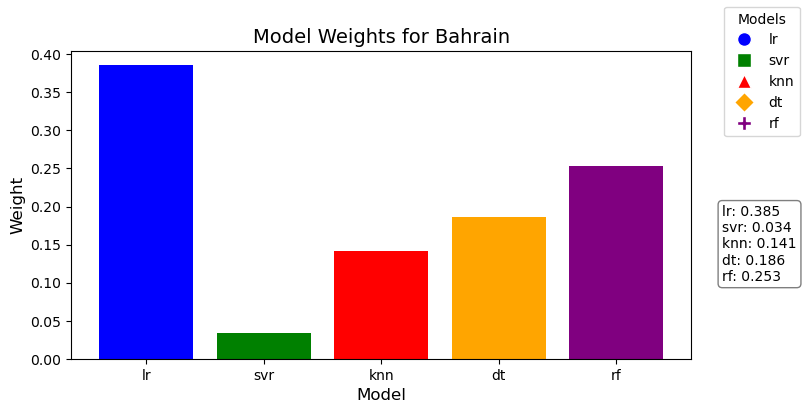

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\Weight_Yemen.png


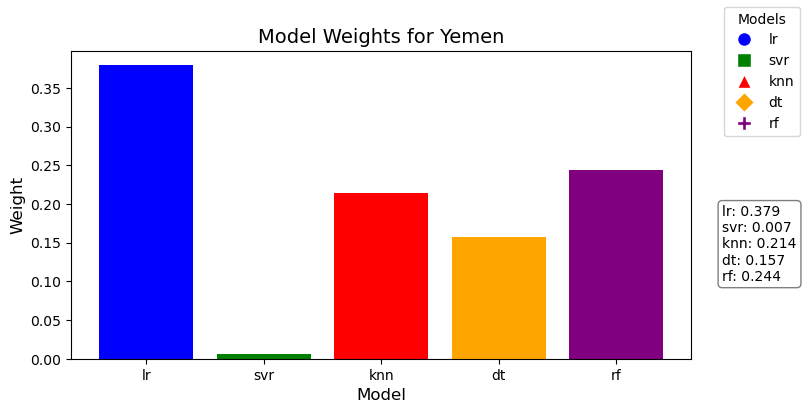

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\Weight_Kuwait.png


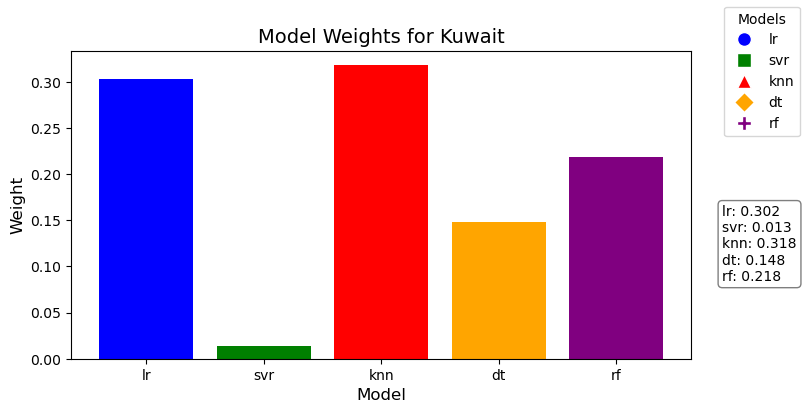

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\Weight_Oman.png


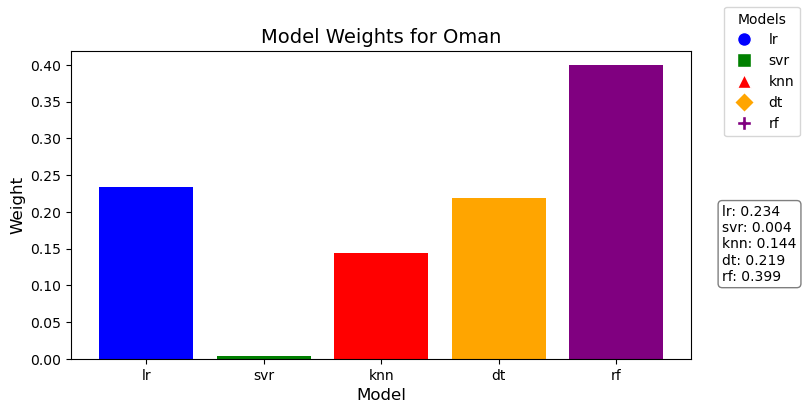

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\Weight_Qatar.png


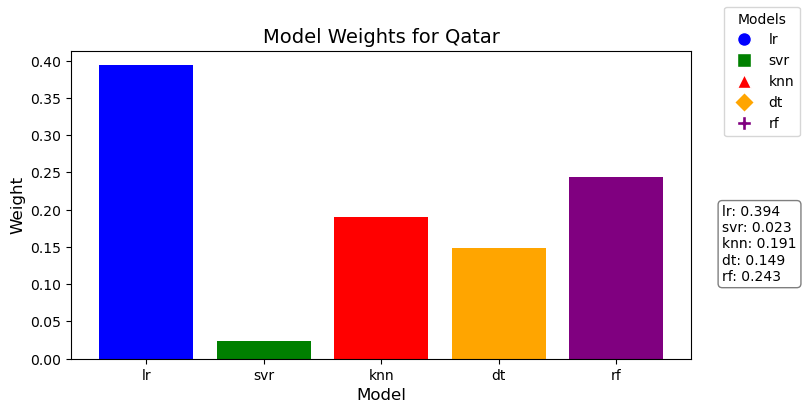

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\Weight_Saudi_Arabia.png


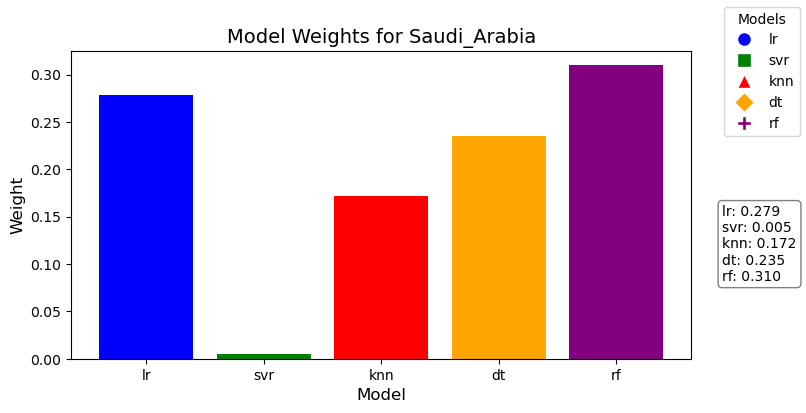

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\Weight_United_Arab_Emirates.png


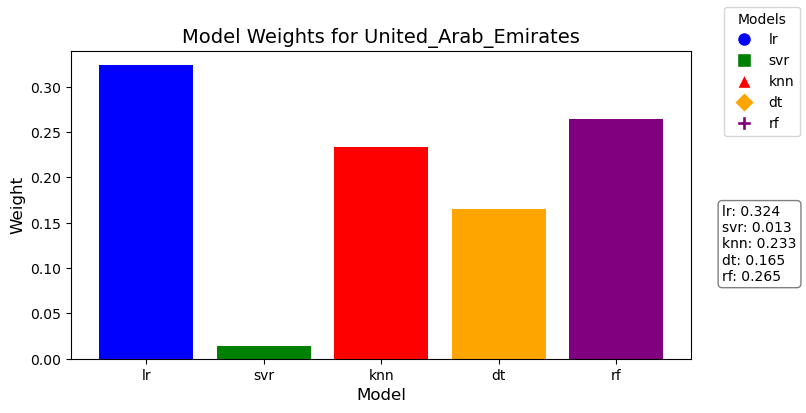

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\R2_Bahrain.png


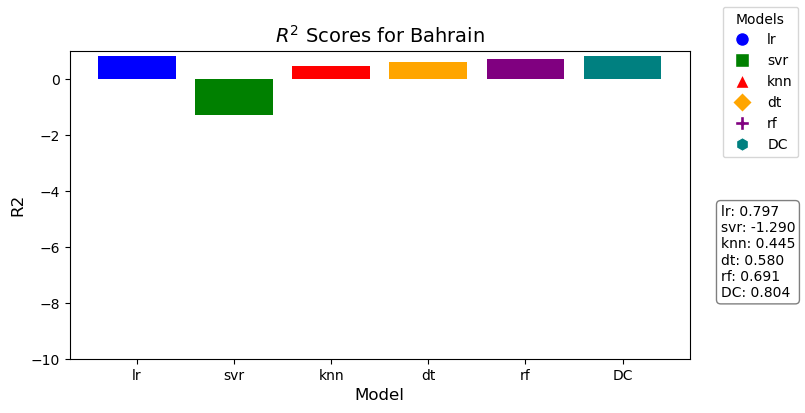

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\R2_Yemen.png


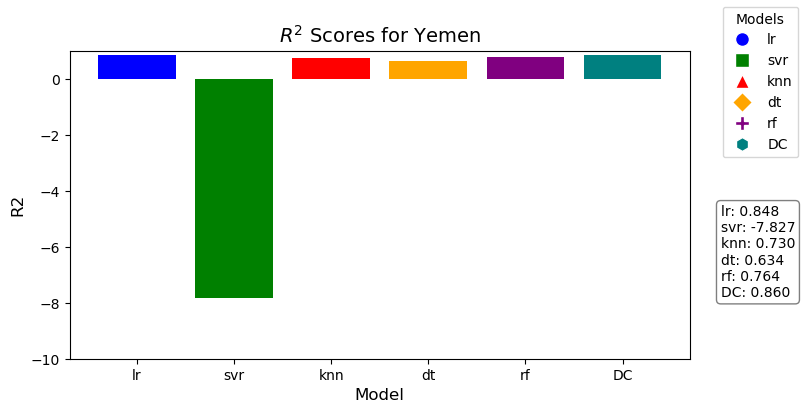

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\R2_Kuwait.png


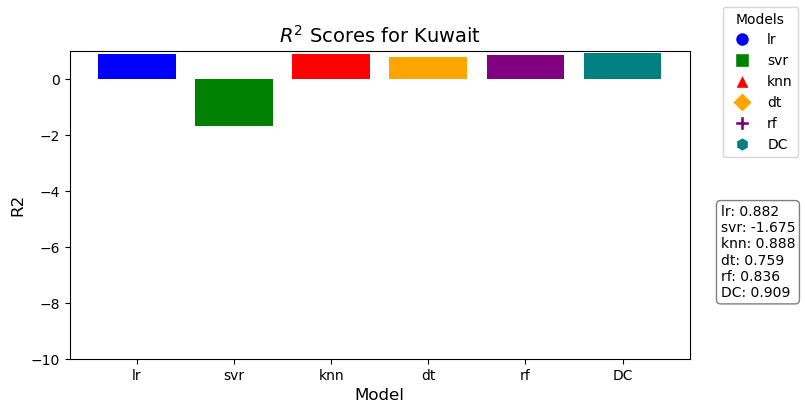

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\R2_Oman.png


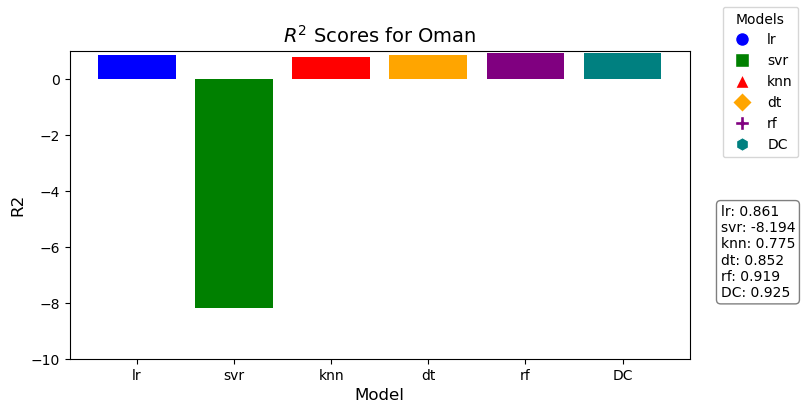

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\R2_Qatar.png


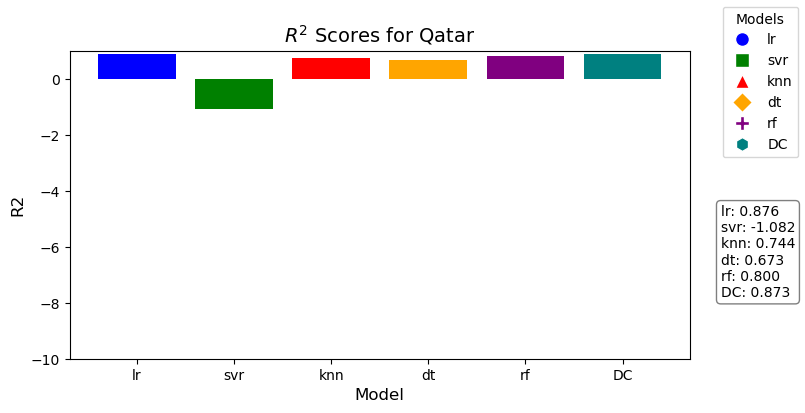

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\R2_Saudi_Arabia.png


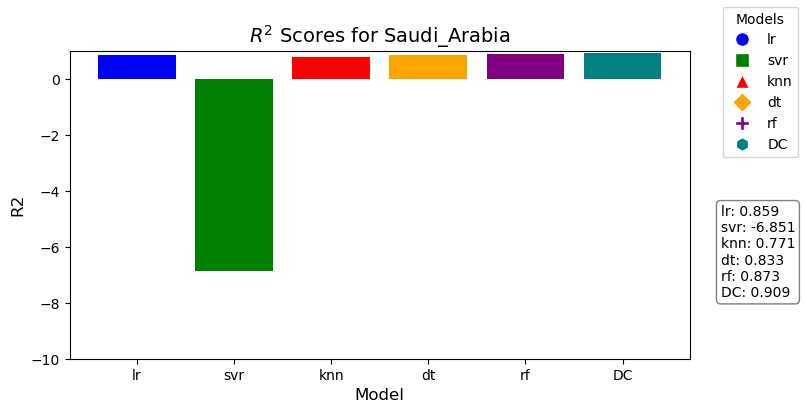

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\R2_United_Arab_Emirates.png


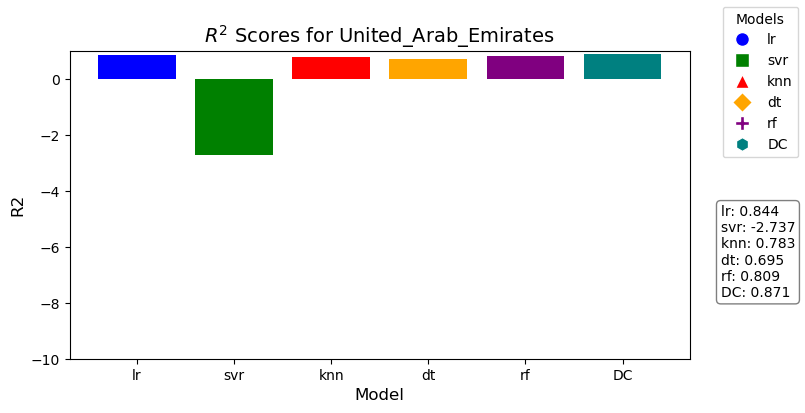

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\MSE_Bahrain.png


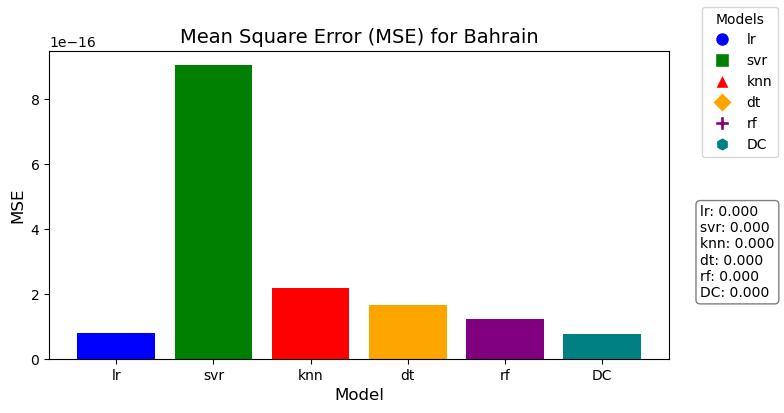

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\MSE_Yemen.png


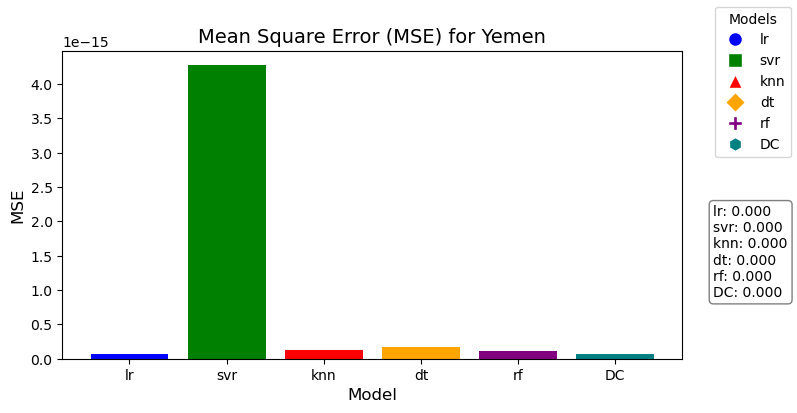

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\MSE_Kuwait.png


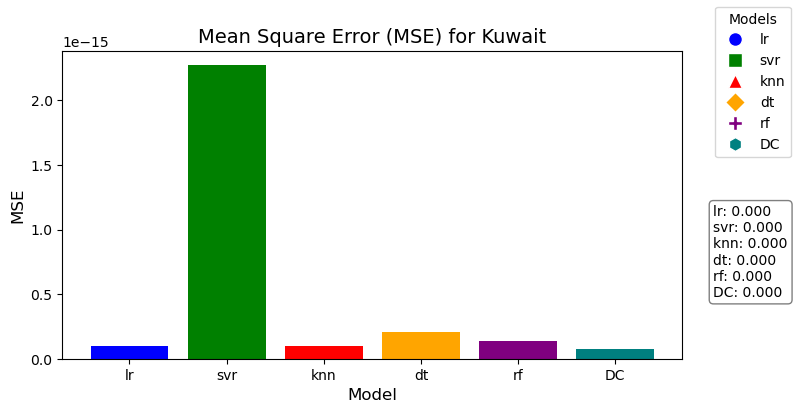

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\MSE_Oman.png


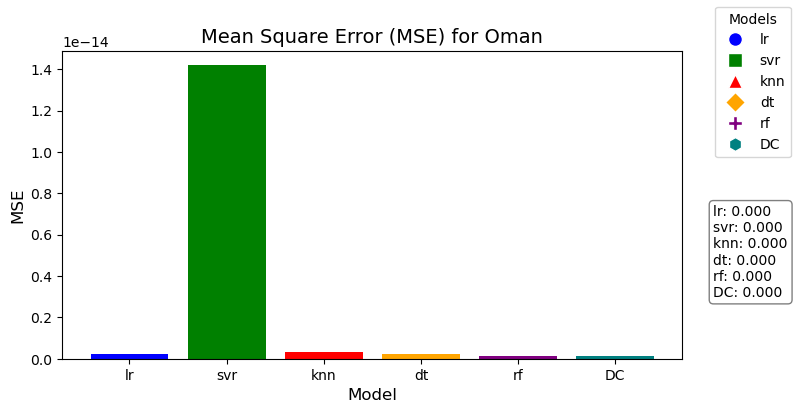

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\MSE_Qatar.png


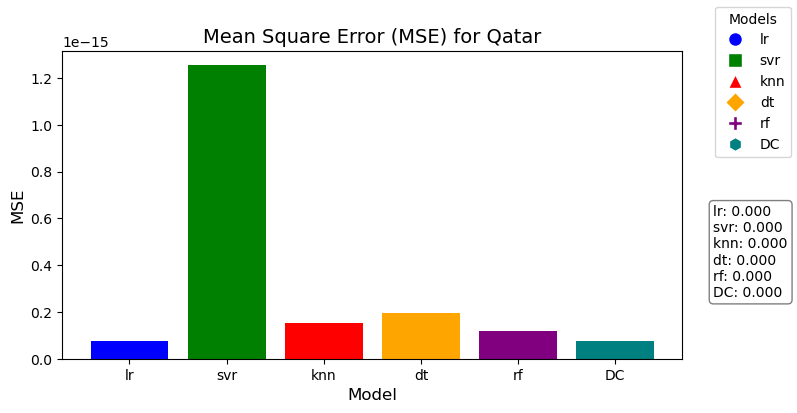

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\MSE_Saudi_Arabia.png


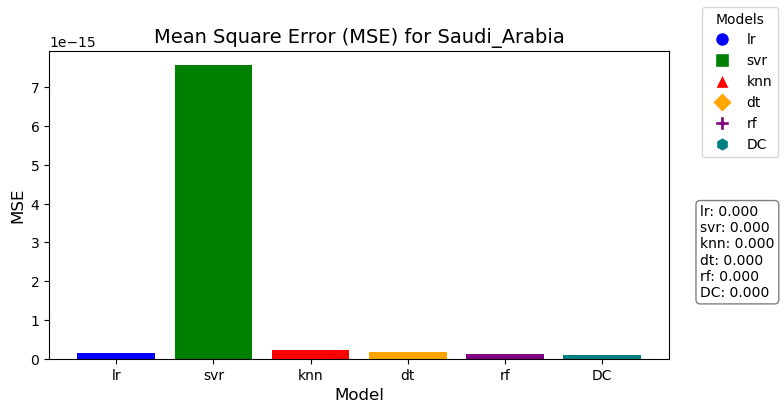

Saved plot: Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots\MSE_United_Arab_Emirates.png


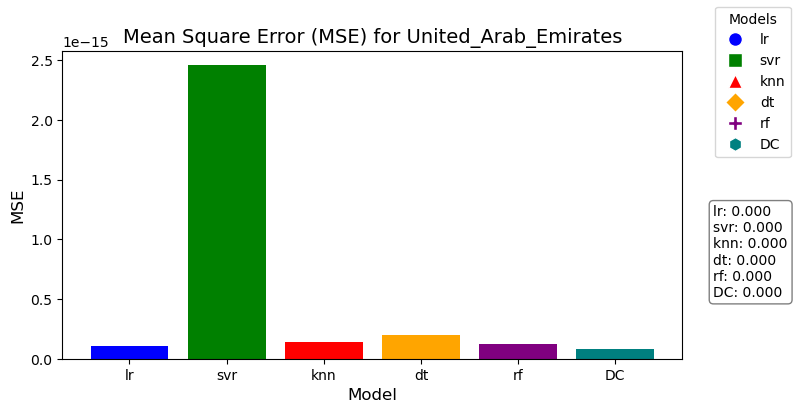

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\sfc_model_metrics_2016_2020_v0051.csv"
data = pd.read_csv(file_path)

# Rename ensemble model to 'DustCast' (DC)
data['Model'] = data['Model'].replace({'ensemble': 'DC'})

# Define color and marker scheme
model_styles = {
    'DC': ('teal', 'h'),  # DustCast
    'lr': ('blue', 'o'),  # Linear Regression
    'svr': ('green', 's'),  # Support Vector Regression
    'knn': ('red', '^'),  # K-Nearest Neighbors
    'dt': ('orange', 'D'),  # Decision Tree
    'rf': ('purple', 'P')  # Random Forest
}

# Metrics to plot
metrics = ['Weight', 'R2', 'MSE', 'MAE']
titles = {
    'Weight': "Model Weights",
    'R2': "$R^2$ Scores",
    'MSE': "Mean Square Error (MSE)",
    'MAE': "Mean Absolute Error (MAE)"
}

# Define output directory for plots
output_dir = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots"
os.makedirs(output_dir, exist_ok=True)  # Ensure directory exists

def add_textbox(ax, data, metric):
    """Adds a textbox with model metric values."""
    text_str = "\n".join([f"{row['Model']}: {row[metric]:.3f}" for _, row in data.iterrows()])
    props = dict(boxstyle='round', facecolor='white', alpha=0.5)
    ax.text(1.05, 0.5, text_str, transform=ax.transAxes, fontsize=10,
            verticalalignment='top', bbox=props)

# Loop through each metric and country to generate separate graphs
for metric in metrics:
    for country in data['Country'].unique():
        country_data = data[data['Country'] == country]

        # **Exclude DC when plotting "Weight" metric**
        if metric == "Weight":
            country_data = country_data[country_data['Model'] != 'DC']

        # Create a new figure for each metric-country pair
        fig, ax = plt.subplots(figsize=(8, 4))
        colors = [model_styles.get(model, ('gray', 'o'))[0] for model in country_data['Model']]
        
        ax.bar(country_data['Model'], country_data[metric], color=colors)
        ax.set_title(f"{titles[metric]} for {country}", fontsize=14)
        ax.set_xlabel("Model", fontsize=12)
        ax.set_ylabel(metric, fontsize=12)

        # Limit R2 axis to avoid misleading visualizations
        if metric == 'R2':
            ax.set_ylim(-10, 1)

        add_textbox(ax, country_data[['Model', metric]], metric)

        # Add legend
        filtered_models = country_data['Model'].unique()
        handles = [plt.Line2D([0], [0], marker=model_styles[m][1], color='w', 
                              markerfacecolor=model_styles[m][0], markersize=10) 
                   for m in filtered_models if m in model_styles]
        
        labels = [m for m in filtered_models if m in model_styles]
        fig.legend(handles, labels, loc='upper right', title="Models")

        # Save the figure
        save_path = os.path.join(output_dir, f"{metric}_{country}.png")
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Saved plot: {save_path}")

        # Show the plot
        plt.show()

# **Compute and plot the average MSE, MAE, and R² across all countries**
for metric in ['Weight', 'R2', 'MSE', 'MAE']:
    average_metrics = data.groupby('Model')[metric].mean().reset_index()
    
    if metric == "Weight":
            country_data = country_data[country_data['Model'] != 'DC']
            
    # Create a new figure for the regional average
    fig, ax = plt.subplots(figsize=(8, 4))
    colors = [model_styles.get(model, ('gray', 'o'))[0] for model in average_metrics['Model']]
    
    ax.bar(average_metrics['Model'], average_metrics[metric], color=colors)
    ax.set_title(f"Average {titles[metric]} Across the Arabian Peninsula", fontsize=14)
    ax.set_xlabel("Model", fontsize=12)
    ax.set_ylabel(metric, fontsize=12)

    # Limit R2 axis to avoid misleading visualizations
    if metric == 'R2':
        ax.set_ylim(-10, 1)

    add_textbox(ax, average_metrics[['Model', metric]], metric)

    # Add legend
    filtered_models = average_metrics['Model'].unique()
    handles = [plt.Line2D([0], [0], marker=model_styles[m][1], color='w', 
                          markerfacecolor=model_styles[m][0], markersize=10) 
               for m in filtered_models if m in model_styles]
    
    labels = [m for m in filtered_models if m in model_styles]
    fig.legend(handles, labels, loc='upper right', title="Models")

    # Save the figure
    save_path = os.path.join(output_dir, f"average_{metric}_AP.png")
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    print(f"Saved regional average plot: {save_path}")

    # Show the plot
    plt.show()


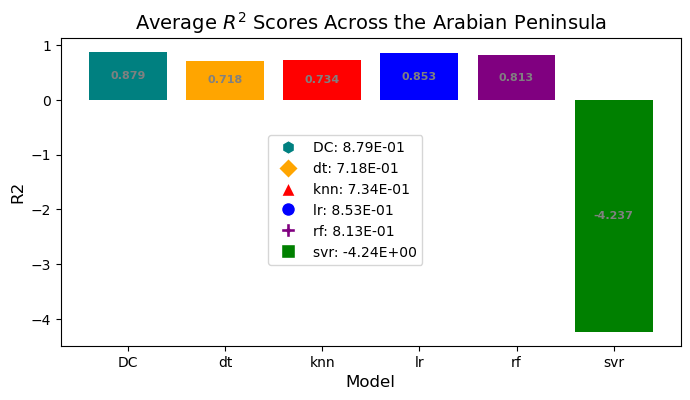

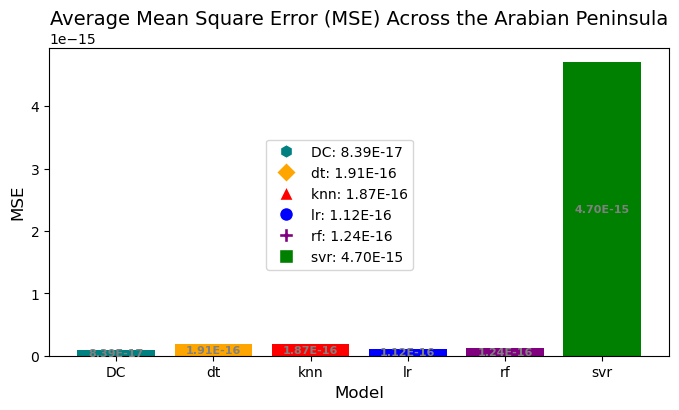

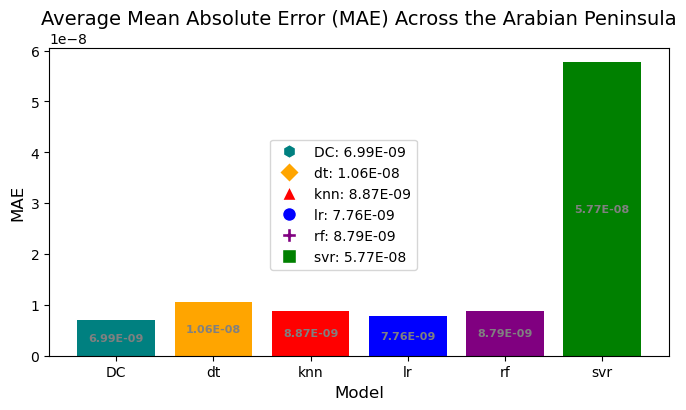

In [10]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\sfc_model_metrics_2016_2020_v0051.csv"
data = pd.read_csv(file_path)

# Rename ensemble model to 'DustCast' (DC)
data['Model'] = data['Model'].replace({'ensemble': 'DC'})

# Define color and marker scheme
model_styles = {
    'DC': ('teal', 'h'),  # DustCast
    'lr': ('blue', 'o'),  # Linear Regression
    'svr': ('green', 's'),  # Support Vector Regression
    'knn': ('red', '^'),  # K-Nearest Neighbors
    'dt': ('orange', 'D'),  # Decision Tree
    'rf': ('purple', 'P')  # Random Forest
}

# Metrics to plot
metrics = ['Weight', 'R2', 'MSE', 'MAE']
titles = {
    'Weight': "Model Weights",
    'R2': "$R^2$ Scores",
    'MSE': "Mean Square Error (MSE)",
    'MAE': "Mean Absolute Error (MAE)"
}

# Define output directory for plots
output_dir = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\model_metric_plots"
os.makedirs(output_dir, exist_ok=True)  # Ensure directory exists

def add_value_labels(ax, bars, is_sci_notation=False):
    """Adds horizontal value labels inside bars."""
    for bar in bars:
        height = bar.get_height()
        if is_sci_notation:
            label = f"{height:.2E}"  # Scientific notation
        else:
            label = f"{height:.3f}"
        ax.text(bar.get_x() + bar.get_width() / 2, height * 0.5, label,
                ha='center', va='center', fontsize=8, color='grey', fontweight='bold')

# **Compute and plot the average MSE, MAE, and R² across all countries**
for metric in ['R2', 'MSE', 'MAE']:
    average_metrics = data.groupby('Model')[metric].mean().reset_index()
    
    # Exclude DC when plotting "Weight"
    if metric == "Weight":
        average_metrics = average_metrics[average_metrics['Model'] != 'DC']

    # Create a new figure for the regional average
    fig, ax = plt.subplots(figsize=(8, 4))
    colors = [model_styles.get(model, ('gray', 'o'))[0] for model in average_metrics['Model']]
    
    bars = ax.bar(average_metrics['Model'], average_metrics[metric], color=colors)
    ax.set_title(f"Average {titles[metric]} Across the Arabian Peninsula", fontsize=14)
    ax.set_xlabel("Model", fontsize=12)
    ax.set_ylabel(metric, fontsize=12)

    # Apply scientific notation to y-axis for small values
    if metric in ['MSE', 'MAE']:
        ax.ticklabel_format(style='sci', axis='y', scilimits=(0, 0))
        add_value_labels(ax, bars, is_sci_notation=True)
    else:
        add_value_labels(ax, bars, is_sci_notation=False)

    # Add legend, shifting it to the left side
    filtered_models = average_metrics['Model'].unique()
    handles = [plt.Line2D([0], [0], marker=model_styles[m][1], color='w', 
                          markerfacecolor=model_styles[m][0], markersize=10) 
               for m in filtered_models if m in model_styles]
    
    labels = [f"{m}: {average_metrics[average_metrics['Model'] == m][metric].values[0]:.2E}"
              for m in filtered_models if m in model_styles]
    
    fig.legend(handles, labels, loc='center')

    # Save the figure
    #save_path = os.path.join(output_dir, f"average_{metric}_AP.png")
    #plt.savefig(save_path, dpi=300, bbox_inches='tight')
    #print(f"Saved regional average plot: {save_path}")

    # Show the plot
    plt.show()


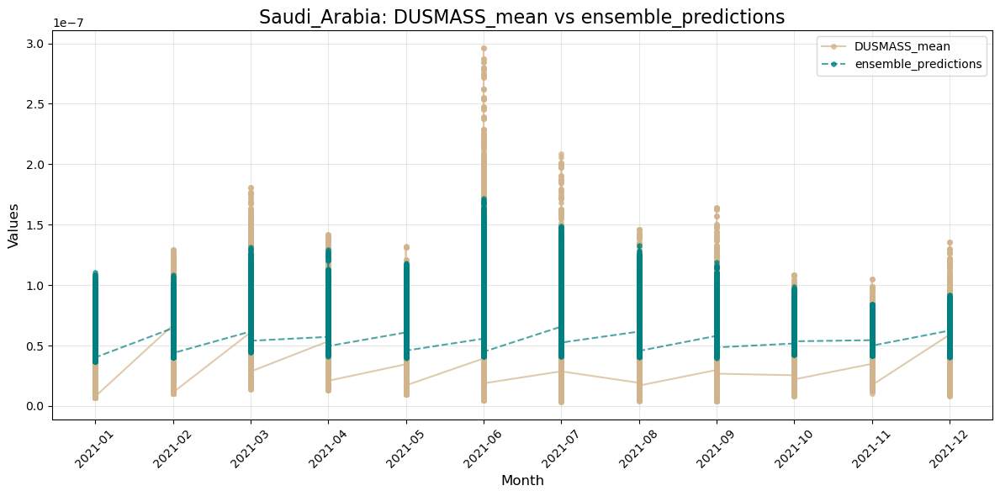

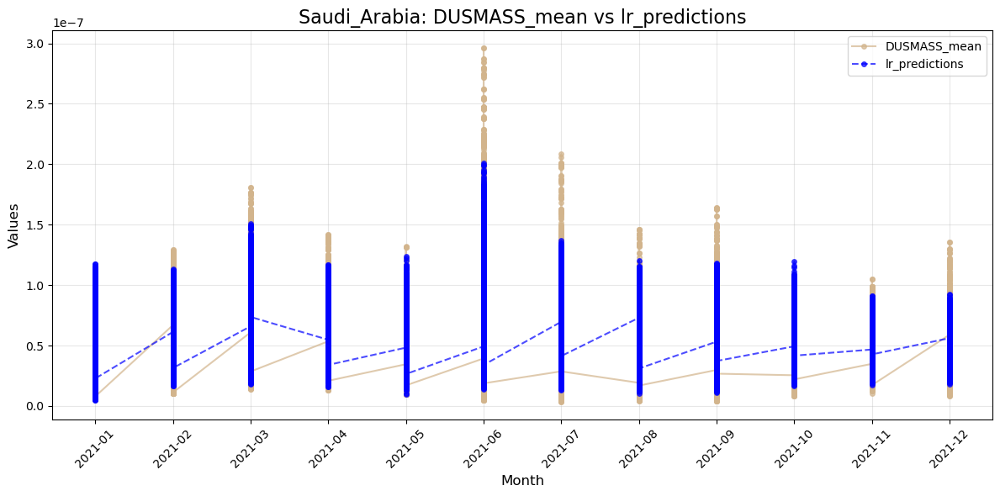

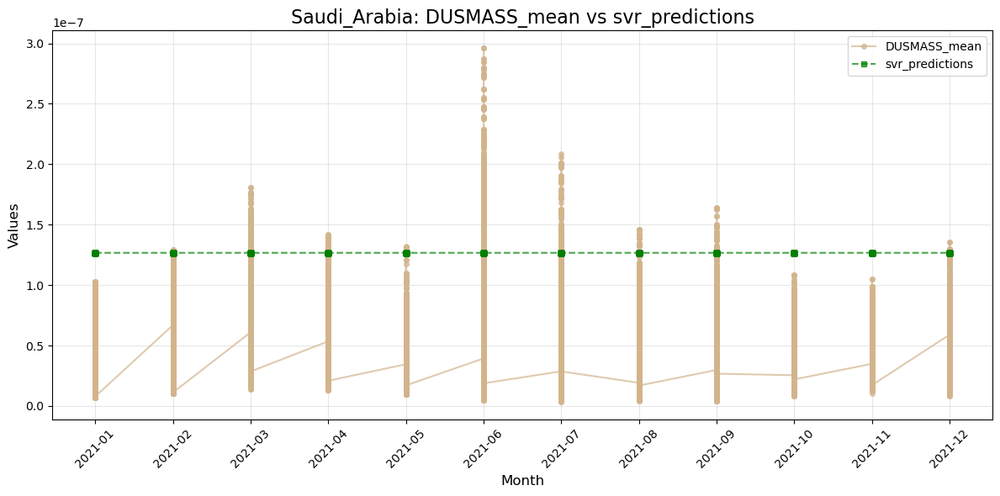

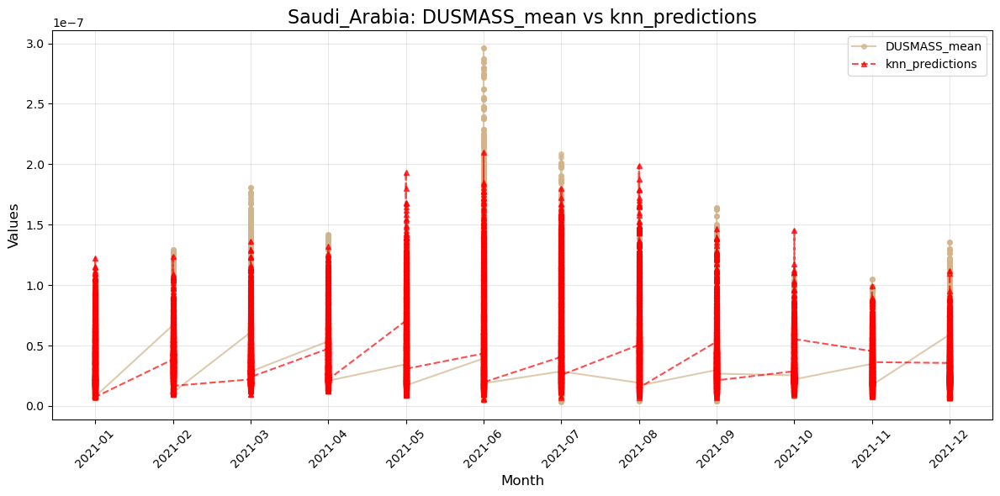

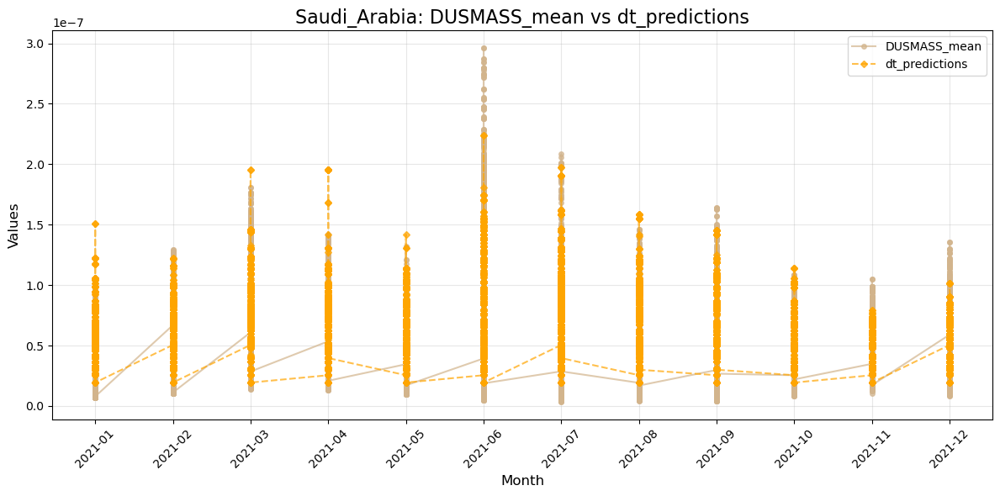

...

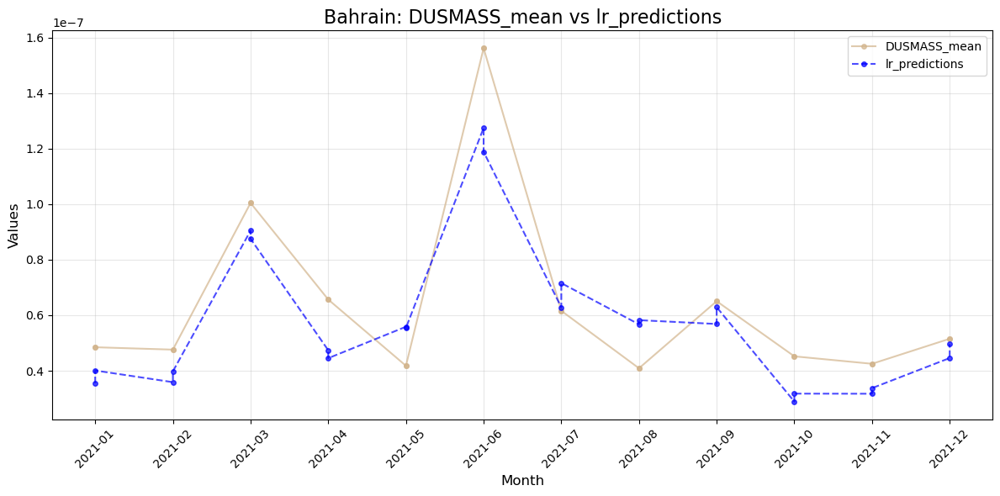

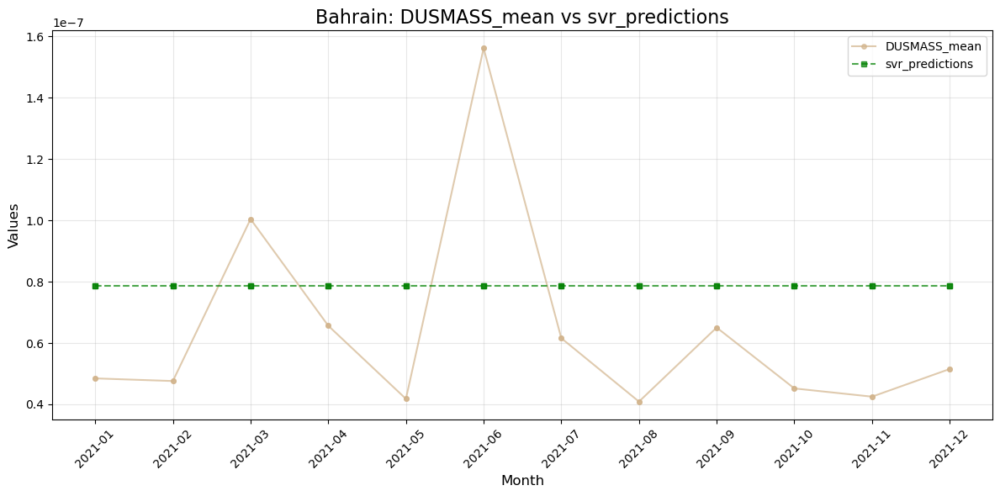

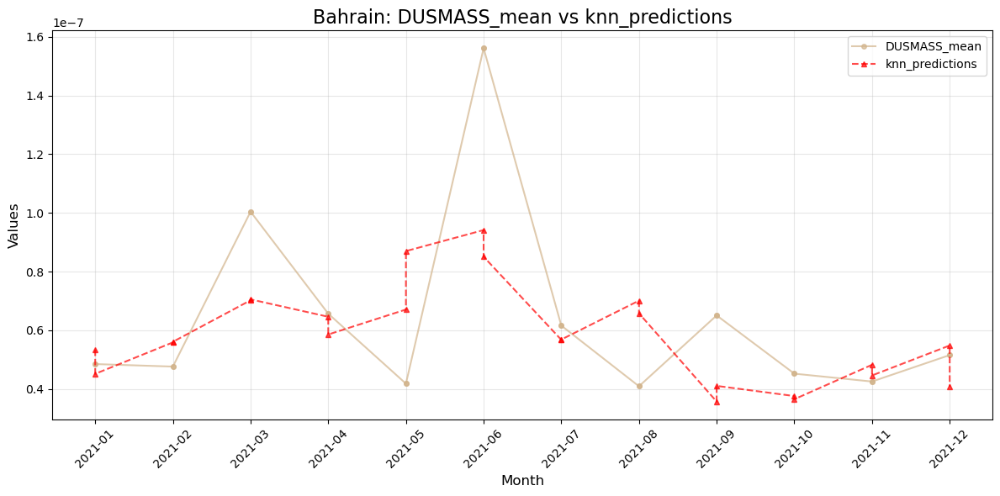

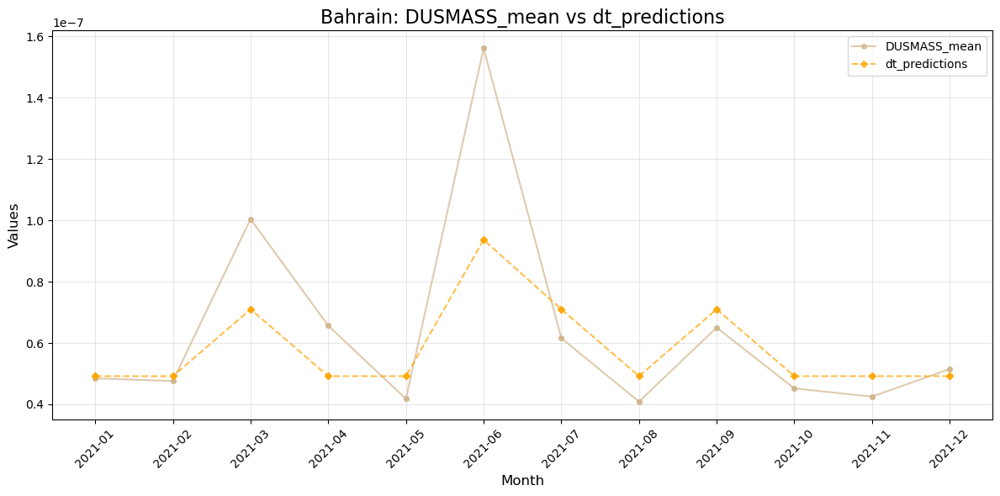

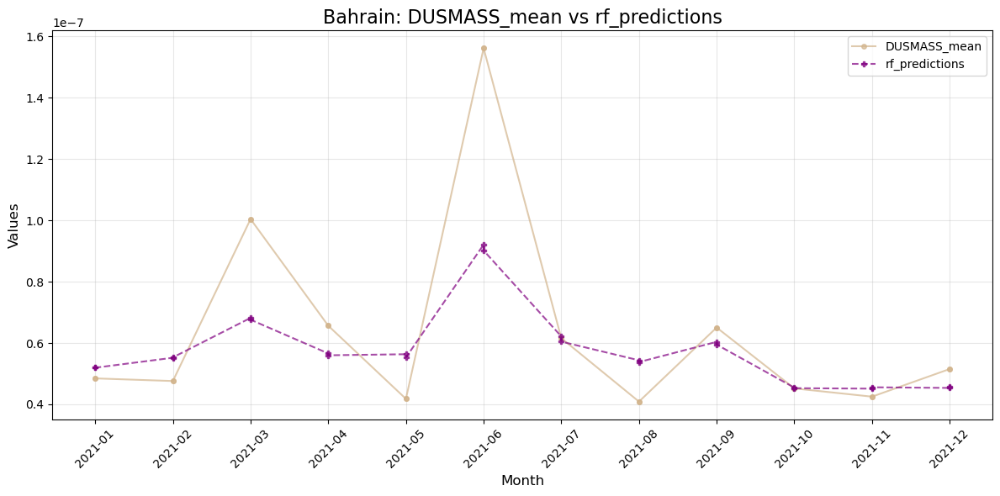

No data available for United Arab Emirates. Skipping...


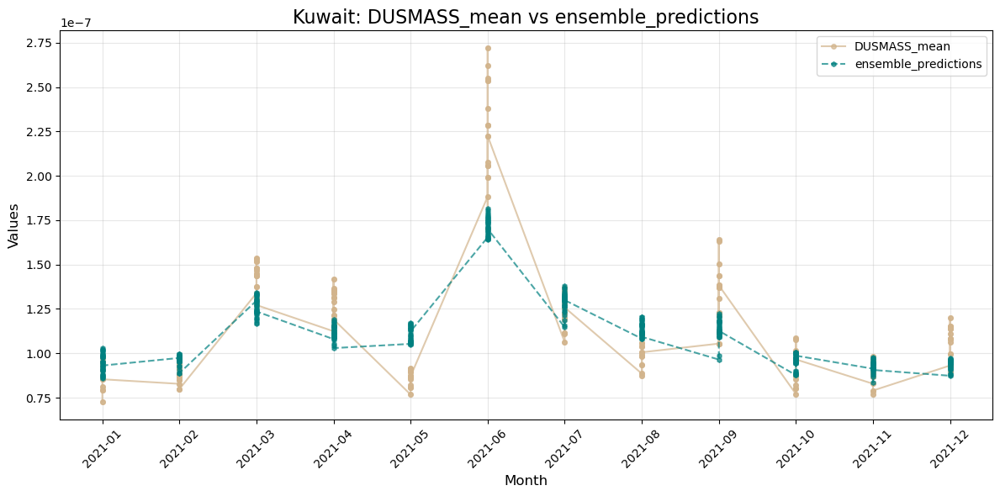

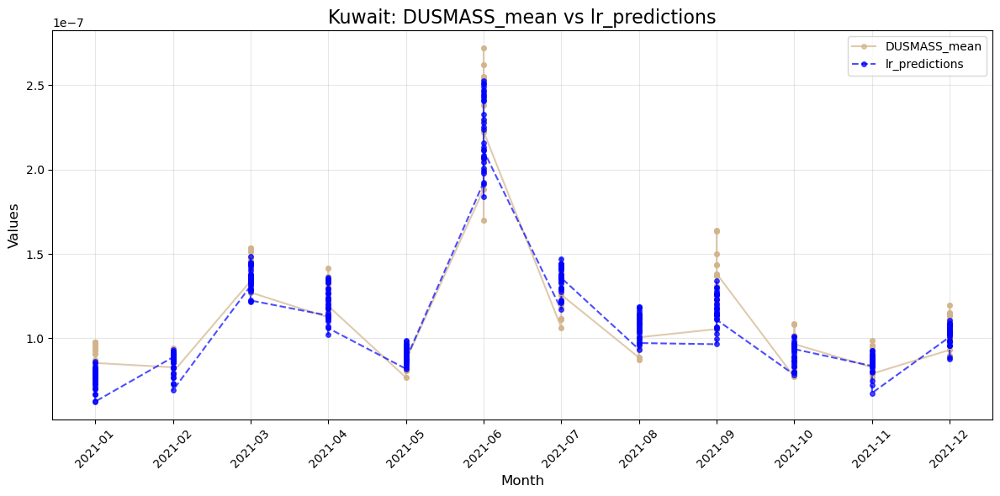

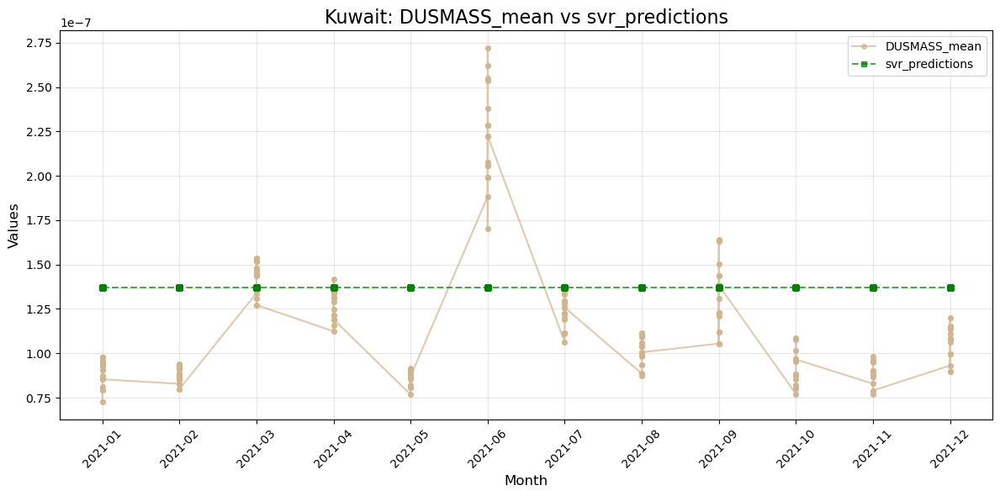

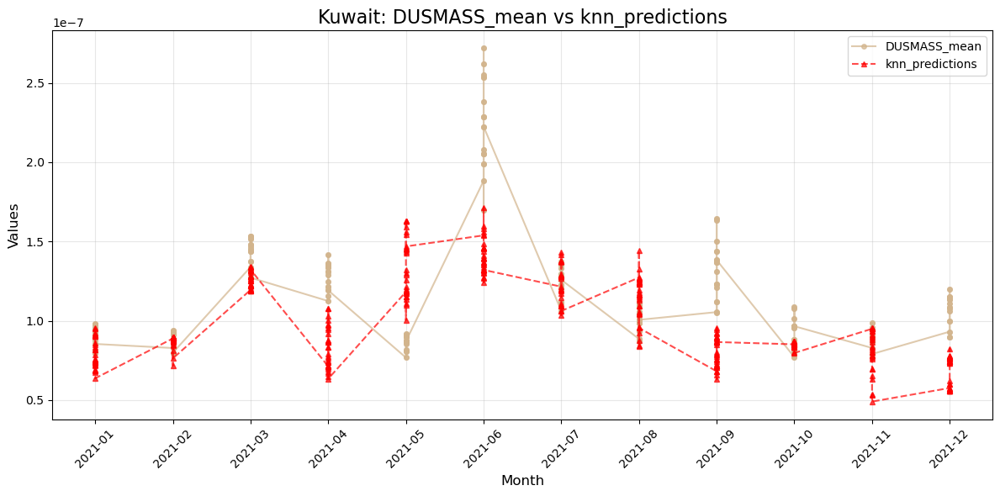

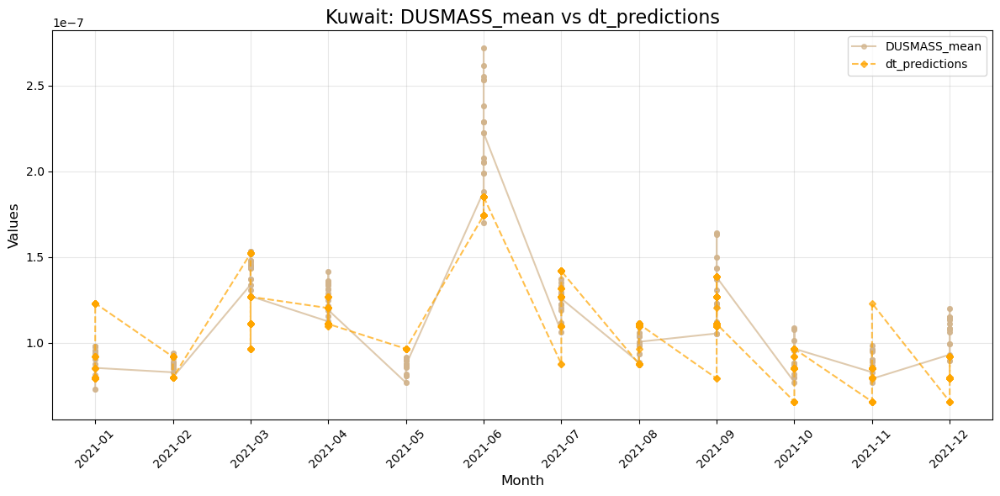

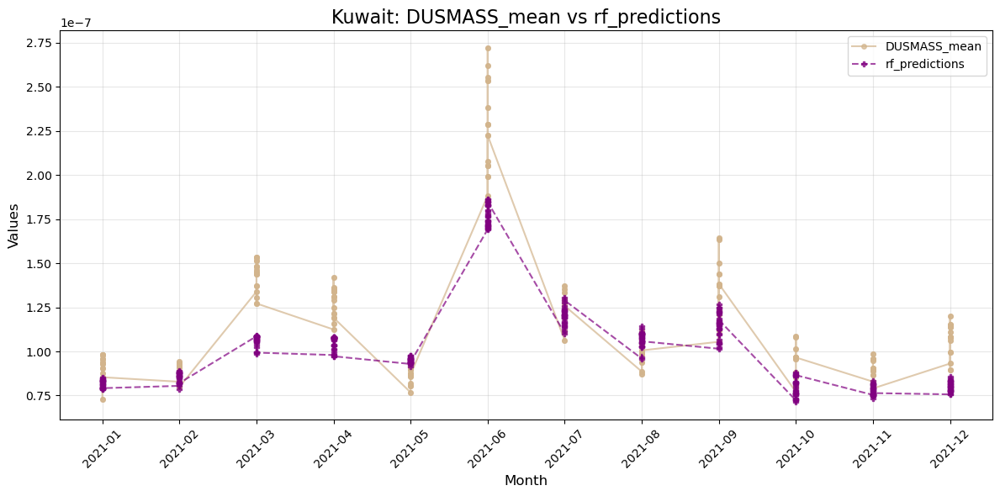

In [21]:
import pandas as pd
import matplotlib.pyplot as plt

# Define the file path for the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\sfc_row_level_predictions_2021_v0051.csv"

# Define model styles
model_styles = {
    'ensemble_predictions': ('teal', 'h'),  # DustCast (DC)
    'lr_predictions': ('blue', 'o'),  # Linear Regression
    'svr_predictions': ('green', 's'),  # Support Vector Regression
    'knn_predictions': ('red', '^'),  # K-Nearest Neighbors
    'dt_predictions': ('orange', 'D'),  # Decision Tree
    'rf_predictions': ('purple', 'P')  # Random Forest
}

# Country mapping
countries = {
    "SA": "Saudi_Arabia",
    "YE": "Yemen",
    "OM": "Oman",
    "QA": "Qatar",
    "BH": "Bahrain",
    "AE": "United Arab Emirates",
    "KW": "Kuwait"
}

# Load the dataset
try:
    dataset = pd.read_csv(file_path)

    # Ensure that 'Country' and 'Month' columns exist
    if 'Country' not in dataset.columns or 'Month' not in dataset.columns:
        raise KeyError("Columns 'Country' or 'Month' are missing from the dataset.")

    # Loop through each country
    for country_code, country_name in countries.items():
        # Filter the dataset for the current country
        country_data = dataset[dataset['Country'] == country_name]

        if country_data.empty:
            print(f"No data available for {country_name}. Skipping...")
            continue

        # Extract 'DUSMASS_mean' and 'Month'
        dusmass_mean = country_data['DUSMASS_mean']
        months = country_data['Month']

        # Loop through each model and create a plot
        for model, (color, marker) in model_styles.items():
            if model in country_data.columns:
                predictions = country_data[model]

                # Create the plot
                plt.figure(figsize=(12, 6))
                plt.plot(months, dusmass_mean, linestyle='-', marker='o', markersize=4, color='tan', alpha=0.7, label='DUSMASS_mean')
                plt.plot(months, predictions, linestyle='--', marker=marker, markersize=4, color=color, alpha=0.7, label=f'{model}')

                # Add title and labels
                plt.title(f'{country_name}: DUSMASS_mean vs {model}', fontsize=16)
                plt.xlabel('Month', fontsize=12)
                plt.ylabel('Values', fontsize=12)

                # Add legend and grid
                plt.legend()
                plt.grid(alpha=0.3)
                plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
                plt.tight_layout()

                # Show the plot
                plt.show()

except FileNotFoundError:
    print("The file was not found. Please ensure the file path is correct.")
except KeyError as e:
    print(f"Column not found in the dataset: {e}")
except Exception as e:
    print(f"An error occurred: {e}")

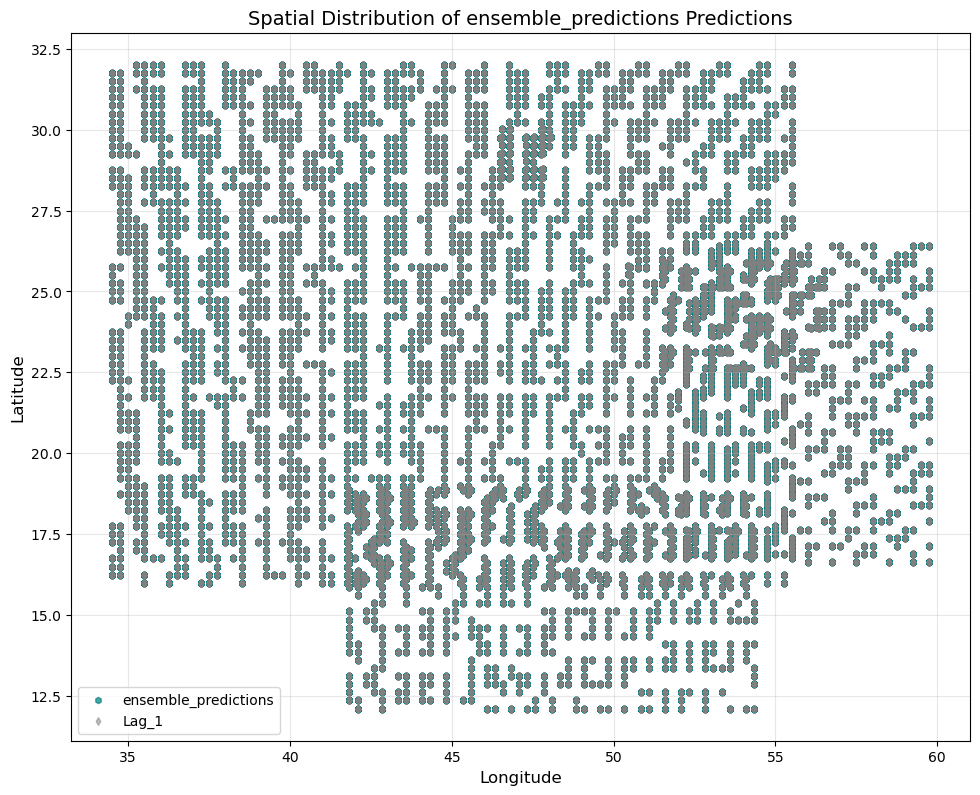

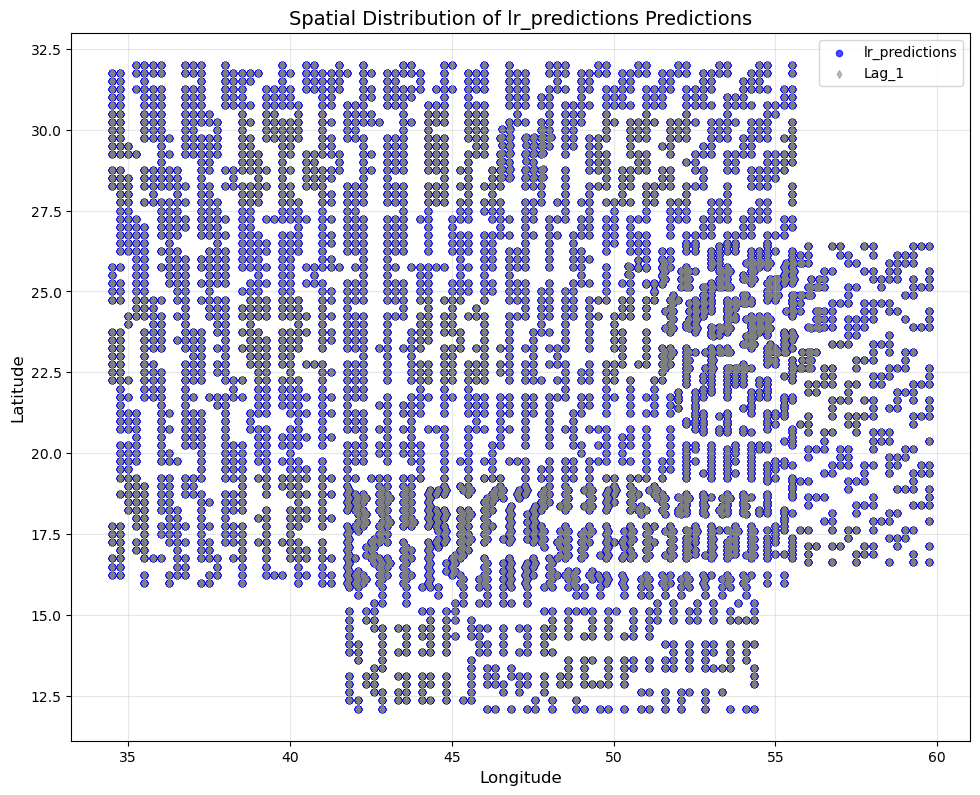

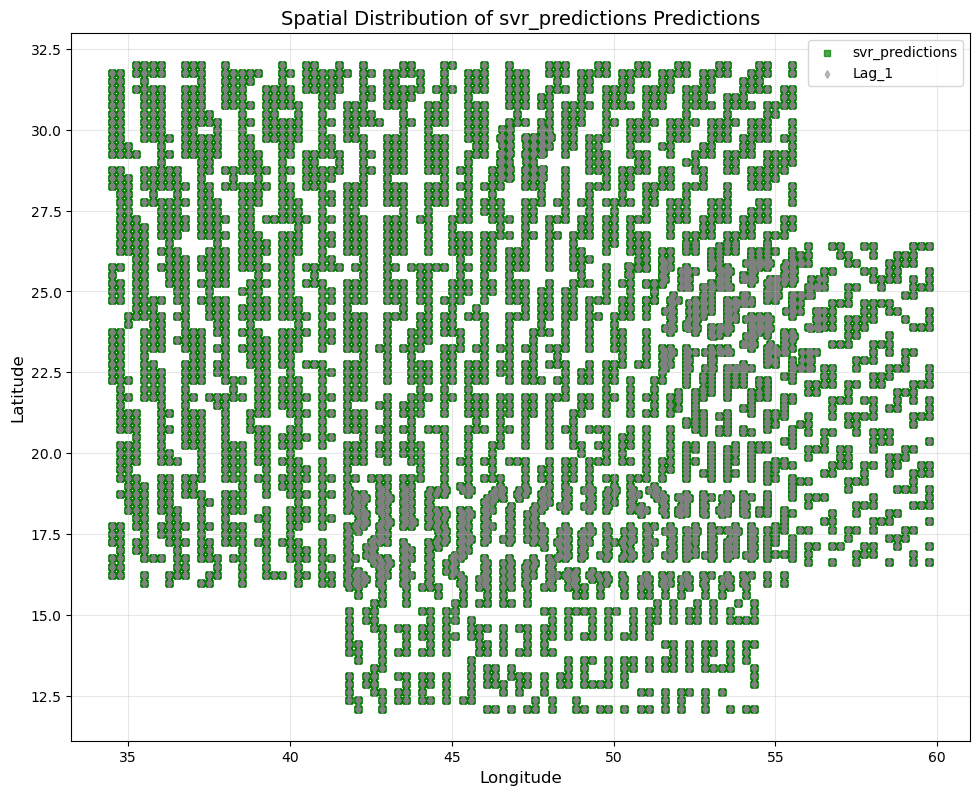

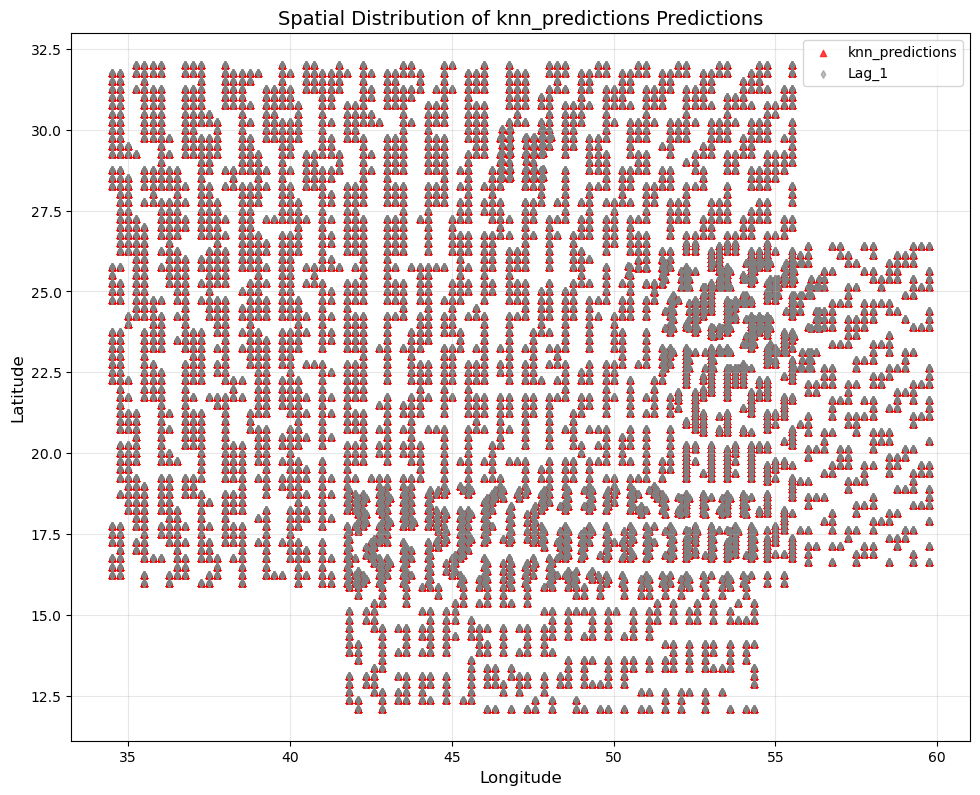

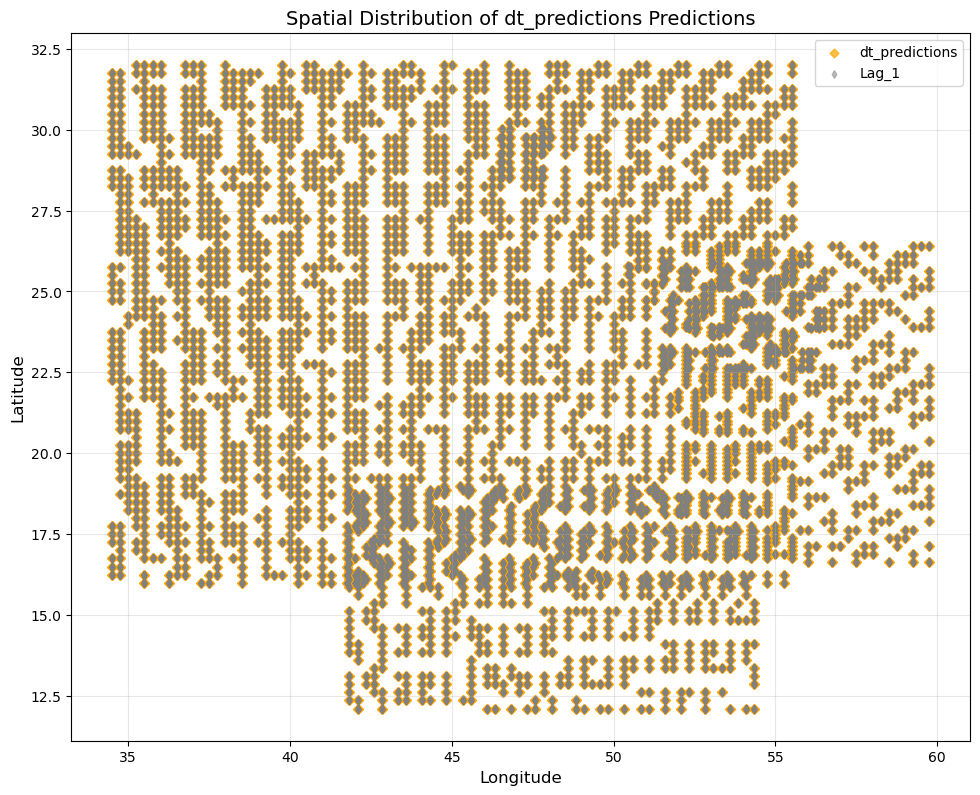

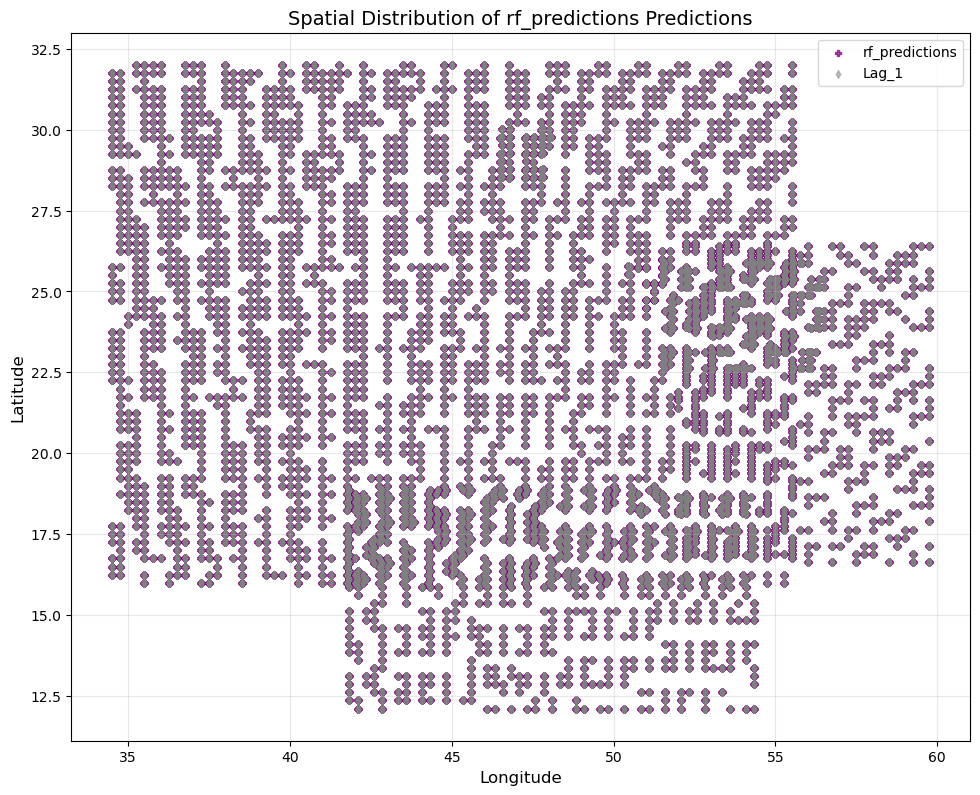

In [22]:
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point

# Define the file path for the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051a\sfc_row_level_predictions_2021_v0051.csv"

# Define model styles
model_styles = {
    'ensemble_predictions': ('teal', 'h'),  # DustCast (DC)
    'lr_predictions': ('blue', 'o'),  # Linear Regression
    'svr_predictions': ('green', 's'),  # Support Vector Regression
    'knn_predictions': ('red', '^'),  # K-Nearest Neighbors
    'dt_predictions': ('orange', 'D'),  # Decision Tree
    'rf_predictions': ('purple', 'P')  # Random Forest
}

# Load the dataset
try:
    dataset = pd.read_csv(file_path)

    # Ensure required columns exist
    if not {'Country', 'Month', 'lag_1', 'lon', 'lat'}.issubset(dataset.columns):
        raise KeyError("One or more required columns are missing from the dataset.")

    # Convert dataset to GeoDataFrame
    dataset['geometry'] = dataset.apply(lambda row: Point(row['lon'], row['lat']), axis=1)
    gdf = gpd.GeoDataFrame(dataset, geometry='geometry')

    # Plot spatial distribution for each model
    for model, (color, marker) in model_styles.items():
        if model in dataset.columns:
            plt.figure(figsize=(10, 8))
            ax = plt.gca()
            
            # Plot model predictions
            gdf.plot(ax=ax, marker=marker, color=color, alpha=0.7, markersize=20, label=f'{model}')
            
            # Plot lag_1 variable
            gdf.plot(ax=ax, marker='d', color='gray', alpha=0.5, markersize=15, label='Lag_1')
            
            # Formatting
            plt.xlabel('Longitude', fontsize=12)
            plt.ylabel('Latitude', fontsize=12)
            plt.title(f'Spatial Distribution of {model} Predictions', fontsize=14)
            plt.legend()
            plt.grid(True, alpha=0.3)
            plt.tight_layout()
            
            # Show plot
            plt.show()

except FileNotFoundError:
    print("The file was not found. Please ensure the file path is correct.")
except KeyError as e:
    print(f"Column not found in the dataset: {e}")
except Exception as e:
    print(f"An error occurred: {e}")

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import correlate
from scipy.stats import norm

# Load the dataset
file_path = r"Z:\Thesis\Data\test\DustCast\SFC\DC_v0051\sfc_row_level_predictions_2021.csv"
data = pd.read_csv(file_path)

# Ensure datetime format for the 'time' column and set it as the index
data['time'] = pd.to_datetime(data['time'])
data.set_index('time', inplace=True)

# Target column and columns to compare
target_column = "DUSMASS_mean"
comparison_columns = ["ensemble_predictions", "dt_predictions", "svr_predictions",
                      "rf_predictions", "knn_predictions", "lr_predictions"]

# Results storage
results = {}

# Function to calculate confidence interval
def confidence_interval(corr, n, alpha=0.05):
    z = np.arctanh(corr)  # Fisher transformation
    se = 1 / np.sqrt(n - 3)  # Standard error
    z_crit = norm.ppf(1 - alpha / 2)  # Critical value for the confidence level
    ci_lower = np.tanh(z - z_crit * se)  # Back transform
    ci_upper = np.tanh(z + z_crit * se)  # Back transform
    return ci_lower, ci_upper

# Compute cross-correlation and confidence intervals for each comparison column
for column in comparison_columns:
    observed = data[target_column].values
    predicted = data[column].values

    # Cross-correlation
    correlation = correlate(observed, predicted, mode="full")
    lags = np.arange(-len(observed) + 1, len(predicted))

    # Find the maximum correlation and corresponding lag
    max_corr_idx = np.argmax(np.abs(correlation))
    max_corr = correlation[max_corr_idx]
    max_lag = lags[max_corr_idx]

    # Confidence Interval
    ci_lower, ci_upper = confidence_interval(max_corr, len(observed))

    # Store results
    results[column] = {
        "Max Correlation": max_corr,
        "Lag at Max Correlation": max_lag,
        "Confidence Interval": (ci_lower, ci_upper)
    }

    # Plot the cross-correlation
    plt.figure(figsize=(10, 6))
    plt.plot(lags, correlation, label=f"Cross-Correlation with {column}")
    plt.axvline(max_lag, color='r', linestyle='--', label=f"Max Corr Lag: {max_lag}")
    plt.fill_between(
        lags, ci_lower, ci_upper, color='gray', alpha=0.2, label="Confidence Interval"
    )
    plt.xlabel("Lag")
    plt.ylabel("Cross-Correlation")
    plt.title(f"Cross-Correlation Analysis: {target_column} vs {column}")
    plt.legend()
    plt.grid()
    plt.show()

# Display results
results_df = pd.DataFrame(results).T
import ace_tools as tools; tools.display_dataframe_to_user(name="Cross-Correlation Analysis Results", dataframe=results_df)
